## **Created By**
1. Ahmadio Rasyadi Hermanu
2. Rimbi Rodiyana Sova

## **Background**

The dynamic and competitive real estate market demands precise pricing strategies to optimize investments and increase profitability. Our company, a major player in real estate, sees the opportunity to leverage data analytics and machine learning for accurate price predictions. Traditional approaches, based on historical data and market trends, often fail to account for the complexity of factors like location and property features. By using machine learning, we can build predictive models to anticipate price fluctuations in the Washington D.C. real estate market.

**Problem Statement**

The real estate market is highly influenced by various factors, including property characteristics, economic conditions, and location. Predicting real estate prices accurately using traditional statistical methods has become increasingly difficult. Our goal is to develop a more accurate, data-driven model using machine learning to improve property price predictions and inform decision-making in investments and market strategy.

**Goals**

1. Develop a Predictive Model: Build a machine learning model to predict property prices in Washington D.C. using historical data.
2. Identify Key Features: Determine the most important factors influencing property prices.
3. Optimize Predictive Accuracy: Improve pricing prediction accuracy through advanced technique and find the best model.
4. Leverage Insights for Strategy: Use insights from the model to improve pricing strategies and market positioning.

**Analytic Approach**

Data Preprocessing: Clean and prepare historical sales data and property features (e.g., number of rooms, property location, etc.).
Feature Engineering: Create new features based on existing data to improve the model's performance.
Model Selection: Use machine learning models such as XGBoost for regression analysis to predict prices.
Hyperparameter Tuning: Optimize the XGBoost model by adjusting hyperparameters for the best performance.
Model Evaluation: Assess the performance of the model using metrics like RMSE (Root Mean Squared Error) and compare with baseline models like linear regression.

**Metric**

The key performance metric for this project is RMSE (Root Mean Squared Error), which measures the average difference between predicted and actual property prices. Lower RMSE values indicate better model performance. Additional metrics like Mean Absolute Error (MAE) and R-squared may also be used to evaluate the model's accuracy and robustness.


In [ ]:
# Library

import pandas as pd
import numpy as np

!pip install category_encoders
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

from statsmodels.stats.outliers_influence import variance_inflation_factor
usb
# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches
import matplotlib.colors
import plotly.express as px
from scipy.stats import kruskal

# Ignore Warning
import sys
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")

import missingno

# Modeling
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, OrdinalEncoder
from sklearn.compose import ColumnTransformer
import category_encoders as ce
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost.sklearn import XGBRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

from sklearn.utils import resample

import pickle

from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold

| **Attribute**        | **Data Type**  | **Description**                                                  |
|----------------------|----------------|------------------------------------------------------------------|
| BATHRM               | int64          | Number of bathrooms in the property.                             |
| HF_BATHRM            | int64          | Number of half bathrooms (without a shower/bath) in the property.|
| HEAT                 | object         | Type of heating system available in the property.                |
| AC                   | object         | Indicates whether the property has air conditioning (Yes/No).    |
| NUM_UNITS            | float64        | Number of units in the building (for multi-unit properties).     |
| ROOMS                | int64          | Total number of rooms in the property.                           |
| BEDRM                | int64          | Number of bedrooms in the property.                              |
| AYB                  | float64        | Actual Year Built, the year the property was originally constructed.|
| YR_RMDL              | float64        | Year the property was last remodeled or updated.                 |
| EYB                  | int64          | Effective Year Built, reflecting the overall condition based on renovations. |
| STORIES              | float64        | Number of stories (floors) in the building.                      |
| SALEDATE             | object         | Date when the property was last sold.                            |
| PRICE                | float64        | Sale price of the property in the most recent transaction.       |
| QUALIFIED            | object         | Whether the sale was qualified as an arms-length transaction (Yes/No). |
| SALE_NUM             | int64          | Number of times the property has been sold.                      |
| GBA                  | float64        | Gross Building Area, representing the total square footage of the property. |
| BLDG_NUM             | int64          | Building number if part of a multi-building complex.             |
| STYLE                | object         | Architectural style of the property (e.g., Colonial, Modern).    |
| STRUCT               | object         | Structure type of the property (e.g., Detached, Townhouse).      |
| GRADE                | object         | Overall quality grade assigned to the property (e.g., A, B, C).  |
| CNDTN                | object         | Condition of the property (e.g., Excellent, Fair, Poor).         |
| EXTWALL              | object         | Type of external wall material (e.g., Brick, Vinyl).             |
| ROOF                 | object         | Type of roof material or style (e.g., Shingle, Metal).           |
| INTWALL              | object         | Type of internal wall material (e.g., Drywall, Plaster).         |
| KITCHENS             | float64        | Number of kitchens in the property.                              |
| FIREPLACES           | int64          | Number of fireplaces in the property.                            |
| USECODE              | int64          | Use code categorizing the type of property (e.g., Residential, Commercial). |
| LANDAREA             | int64          | Total land area of the property in square feet.                  |
| GIS_LAST_MOD_DTTM    | object         | Timestamp of the last modification in the GIS system.            |
| SOURCE               | object         | Source of the data entry (e.g., Public Records, Manual Input).   |
| CMPLX_NUM            | float64        | Complex number if the property is part of a larger development.  |
| LIVING_GBA           | float64        | Gross Building Area used for living space.                       |
| FULLADDRESS          | object         | Full address of the property.                                    |
| CITY                 | object         | City where the property is located.                              |
| STATE                | object         | State where the property is located.                             |
| ZIPCODE              | float64        | ZIP code of the property.                                        |
| NATIONALGRID         | object         | National grid coordinates for the property.                      |
| LATITUDE             | float64        | Latitude of the property location.                               |
| LONGITUDE            | float64        | Longitude of the property location.                              |
| ASSESSMENT_NBHD      | object         | Neighborhood code used for property assessment.                  |
| ASSESSMENT_SUBNBHD   | object         | Sub-neighborhood code used for property assessment.              |
| CENSUS_TRACT         | float64        | Census tract identifier for the property location.               |
| CENSUS_BLOCK         | object         | Census block identifier for the property location.               |
| WARD                 | object         | Political or administrative ward for the property location.      |
| SQUARE               | object         | Square number indicating the block location within the city grid.|
| X                    | float64        | X-coordinate in the city's GIS system.                           |
| Y                    | float64        | Y-coordinate in the city's GIS system.                           |
| QUADRANT             | object         | Quadrant of the city where the property is located (e.g., NW, NE).|


![image.png](attachment:image.png)

This picture attached shows the location of a WARD which contains WARD 1 until WARD 8
- Ward 1: A lively and diverse area, known for its nightlife and cultural mix. Popular neighborhoods include Adams Morgan and Columbia Heights.

- Ward 2: One of the wealthiest areas, home to historic neighborhoods like Georgetown and Dupont Circle, as well as major government offices.

- Ward 3: A quiet, mostly residential ward with large homes and lots of green spaces. Neighborhoods like Chevy Chase and Tenleytown are family-friendly and affluent.

- Ward 4: A mix of residential and commercial areas, with some neighborhoods, like Petworth, undergoing gentrification and development.

- Ward 5: An area in transition, with new development pushing property prices up in neighborhoods like Brookland and Eckington.

- Ward 6: A dynamic, centrally located ward that includes Capitol Hill and the rapidly developing Navy Yard, with a mix of old and new housing.

- Ward 7: Located in the eastern part of D.C., this ward is more affordable but is starting to see development and rising property values.

- Ward 8: Historically one of the more economically challenged wards, but it's experiencing redevelopment, especially in neighborhoods like Anacostia.

In [ ]:
df = pd.read_csv('DC_Properties.csv', index_col= 0)
df

<ipython-input-7-1ad84cbb875e>:1: DtypeWarning: Columns (18,19,20,21,22,23,24,33,34,35,37,43,45) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('DC_Properties.csv', index_col= 0)


,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,Q,1,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
1,3,1,Warm Cool,Y,2.0,11,5,1898.0,2007.0,1972,3.0,2000-08-17 00:00:00,NaN,U,1,2567.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1746 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23067 09289,38.914683,-77.040764,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
2,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,Q,3,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
3,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,Q,1,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
4,2,1,Warm Cool,Y,1.0,11,3,1913.0,2012.0,1985,3.0,NaN,NaN,U,1,5255.0,1,3 Story,Semi-Detached,Very Good,Good,Common Brick,Neopren,Hardwood,1.0,0,13,2032,2018-07-22 18:01:43,Residential,NaN,NaN,1804 NEW HAMPSHIRE AVENUE NW,WASHINGTON,DC,20009.0,18S UJ 23188 09253,38.914383,-77.039361,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
158952,1,0,Forced Air,Y,NaN,3,1,1938.0,2006.0,1938,NaN,2015-04-03 00:00:00,399900.0,Q,4,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,16,394,2018-07-22 18:01:38,Condominium,2786.0,639.0,NaN,NaN,NaN,20001.0,NaN,38.911840,-77.019420,Old City 2,040 B Old City 2,4801.0,NaN,Ward 6,477,-77.019422,38.911848,NW
158953,1,0,Forced Air,Y,NaN,4,2,1938.0,2006.0,1938,NaN,2013-10-04 00:00:00,416000.0,Q,1,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,16,506,2018-07-22 18:01:38,Condominium,2786.0,820.0,NaN,NaN,NaN,20001.0,NaN,38.911840,-77.019420,Old City 2,040 B Old City 2,4801.0,NaN,Ward 6,477,-77.019422,38.911848,NW
158954,2,0,Forced Air,Y,NaN,4,2,1920.0,2007.0,1920,NaN,2008-09-30 00:00:00,600000.0,U,1,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,16,467,2018-07-22 18:01:38,Condominium,2880.0,1167.0,NaN,NaN,NaN,20001.0,NaN,38.911840,-77.019420,Old City 2,040 B Old City 2,4801.0,NaN,Ward 6,477,-77.019422,38.911848,NW
158955,1,0,Warm Cool,Y,NaN,2,0,1965.0,NaN,1965,NaN,2015-04-14 00:00:00,215100.0,Q,3,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,17,332,2018-07-22 18:01:38,Condominium,2275.0,447.0,NaN,NaN,NaN,20024.0,NaN,38.872953,-77.018230,Southwest Waterfront,NaN,11000.0,NaN,Ward 6,504,-77.018232,38.872961,SW


In [ ]:
df.describe()

,BATHRM,HF_BATHRM,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,SALE_NUM,GBA,BLDG_NUM,KITCHENS,FIREPLACES,USECODE,LANDAREA,CMPLX_NUM,LIVING_GBA,ZIPCODE,LATITUDE,LONGITUDE,CENSUS_TRACT,X,Y
count,158957.000000,158957.000000,106696.000000,158957.000000,158957.000000,158686.000000,80928.000000,158957.000000,106652.000000,9.821600e+04,158957.000000,106696.000000,158957.000000,106695.000000,158957.000000,158957.000000,158957.000000,52261.000000,52261.000000,158956.000000,158956.000000,158956.000000,158956.000000,158720.000000,158720.000000
mean,1.810678,0.458237,1.198039,6.187736,2.732506,1941.987579,1998.243537,1963.718024,2.091793,9.313516e+05,1.680033,1714.539889,1.000598,1.219251,2.374674,14.252999,2473.282158,2371.544249,888.834542,20012.694563,38.914854,-77.016676,5348.216324,-77.016712,38.914846
std,0.976396,0.587571,0.596924,2.618165,1.358864,33.640234,16.575786,24.923150,2.933323,7.061325e+06,1.285898,880.677860,0.031622,0.621170,737.295595,3.725736,5059.046023,1114.272364,420.185822,15.627084,0.031723,0.040938,3369.645953,0.040933,0.031682
min,0.000000,0.000000,0.000000,0.000000,0.000000,1754.000000,20.000000,1800.000000,0.000000,1.000000e+00,1.000000,0.000000,1.000000,0.000000,0.000000,11.000000,0.000000,1001.000000,0.000000,20001.000000,38.819731,-77.113909,100.000000,-77.113135,38.820576
25%,1.000000,0.000000,1.000000,4.000000,2.000000,1918.000000,1985.000000,1954.000000,2.000000,2.400000e+05,1.000000,1190.000000,1.000000,1.000000,0.000000,11.000000,697.000000,1501.000000,616.000000,20007.000000,38.895425,-77.042892,2102.000000,-77.042894,38.895432
50%,2.000000,0.000000,1.000000,6.000000,3.000000,1937.000000,2004.000000,1963.000000,2.000000,3.999990e+05,1.000000,1480.000000,1.000000,1.000000,0.000000,13.000000,1649.000000,2265.000000,783.000000,20011.000000,38.915337,-77.019596,5201.000000,-77.019581,38.915229
75%,2.000000,1.000000,1.000000,7.000000,3.000000,1960.000000,2010.000000,1975.000000,2.000000,6.520000e+05,2.000000,1966.000000,1.000000,1.000000,1.000000,17.000000,3000.000000,2910.000000,1060.000000,20018.000000,38.936075,-76.988626,8302.000000,-76.988842,38.936077
max,14.000000,11.000000,6.000000,48.000000,24.000000,2019.000000,2019.000000,2018.000000,826.000000,1.374275e+08,15.000000,45384.000000,5.000000,44.000000,293920.000000,117.000000,942632.000000,5621.000000,8553.000000,20392.000000,38.995540,-76.909758,11100.000000,-76.910511,38.993646


In [ ]:
df.shape

(158957, 48)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 158957 entries, 0 to 158956
Data columns (total 48 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   BATHRM              158957 non-null  int64  
 1   HF_BATHRM           158957 non-null  int64  
 2   HEAT                158957 non-null  object 
 3   AC                  158957 non-null  object 
 4   NUM_UNITS           106696 non-null  float64
 5   ROOMS               158957 non-null  int64  
 6   BEDRM               158957 non-null  int64  
 7   AYB                 158686 non-null  float64
 8   YR_RMDL             80928 non-null   float64
 9   EYB                 158957 non-null  int64  
 10  STORIES             106652 non-null  float64
 11  SALEDATE            132187 non-null  object 
 12  PRICE               98216 non-null   float64
 13  QUALIFIED           158957 non-null  object 
 14  SALE_NUM            158957 non-null  int64  
 15  GBA                 106696 non-null  fl

<ipython-input-12-f46136c2b8a2>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=source_counts.index, y=source_counts.values, palette='Set2')


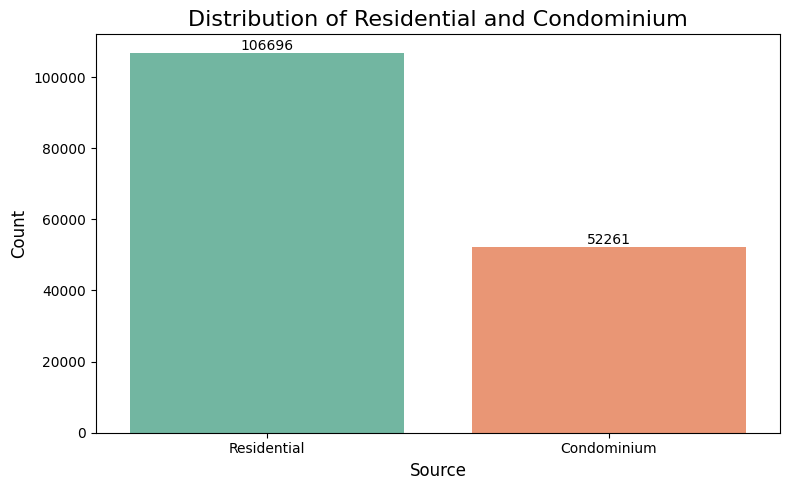

In [ ]:
source_counts = df['SOURCE'].value_counts()

# Create a bar plot using seaborn
plt.figure(figsize=(8,5))
sns.barplot(x=source_counts.index, y=source_counts.values, palette='Set2')

# Customize the plot
plt.title('Distribution of Residential and Condominium', fontsize=16)
plt.xlabel('Source', fontsize=12)
plt.ylabel('Count', fontsize=12)

# Display the values on top of the bars
for i in range(len(source_counts)):
    plt.text(i, source_counts.values[i], source_counts.values[i], ha='center', va='bottom')

plt.tight_layout()

# Show the plot
plt.show()

In [ ]:
df['SOURCE'].unique()

array(['Residential', 'Condominium'], dtype=object)

From the information above we can highlight the point for ``Source`` Which only has 2 property type which is ``Residential`` and ``Condominium``, in this analysis we will make a price prediction for residential property which makes us to pull a decision to collect all information for Residential Property only

In [ ]:
df_res = df[df['SOURCE']=='Residential']
df_res.reset_index(drop=True, inplace=True)
df_res

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,CMPLX_NUM,LIVING_GBA,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT
0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,Q,1,2522.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
1,3,1,Warm Cool,Y,2.0,11,5,1898.0,2007.0,1972,3.0,2000-08-17 00:00:00,NaN,U,1,2567.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1746 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23067 09289,38.914683,-77.040764,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
2,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,Q,3,2522.0,1,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
3,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,Q,1,2484.0,1,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,NaN,NaN,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
4,2,1,Warm Cool,Y,1.0,11,3,1913.0,2012.0,1985,3.0,NaN,NaN,U,1,5255.0,1,3 Story,Semi-Detached,Very Good,Good,Common Brick,Neopren,Hardwood,1.0,0,13,2032,2018-07-22 18:01:43,Residential,NaN,NaN,1804 NEW HAMPSHIRE AVENUE NW,WASHINGTON,DC,20009.0,18S UJ 23188 09253,38.914383,-77.039361,Old City 2,040 D Old City 2,4201.0,004201 2006,Ward 2,152,-77.040429,38.914881,NW
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106691,2,0,Forced Air,N,2.0,8,4,1953.0,NaN,1962,2.0,NaN,NaN,U,1,1600.0,1,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,0,23,6337,2018-07-22 18:01:43,Residential,NaN,NaN,123 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25829 98897,38.821651,-77.006283,Congress Heights,016 A Congress Heights,10900.0,010900 2000,Ward 8,6254,-77.006347,38.821799,SW
106692,2,0,Forced Air,N,2.0,10,5,1953.0,NaN,1962,2.0,2012-02-17 00:00:00,100000.0,U,1,1600.0,1,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,0,23,5348,2018-07-22 18:01:43,Residential,NaN,NaN,127 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25818 98885,38.821534,-77.006407,Congress Heights,016 A Congress Heights,10900.0,010900 2000,Ward 8,6254,-77.006347,38.821799,SW
106693,2,0,Forced Air,N,2.0,10,4,1953.0,NaN,1953,2.0,2009-05-05 00:00:00,NaN,U,1,1600.0,1,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,0,23,3466,2018-07-22 18:01:43,Residential,NaN,NaN,131 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25815 98879,38.821481,-77.006446,Congress Heights,016 A Congress Heights,10900.0,010900 2000,Ward 8,6254,-77.006347,38.821799,SW
106694,2,0,Forced Air,N,2.0,10,4,1953.0,2017.0,1971,2.0,2017-07-27 00:00:00,215000.0,U,4,1600.0,1,2 Story,Multi,Average,Good,Common Brick,Comp Shingle,Hardwood,2.0,0,23,3046,2018-07-22 18:01:43,Residential,NaN,NaN,135 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25807 98865,38.821356,-77.006528,Congress Heights,016 A Congress Heights,10900.0,010900 2000,Ward 8,6254,-77.006347,38.82179

We already obtain the data that contains residential only then we will proceed to the next step which is checking the missing value on the data

## *MISSING VALUES and DATA CLEANING*

<Axes: >

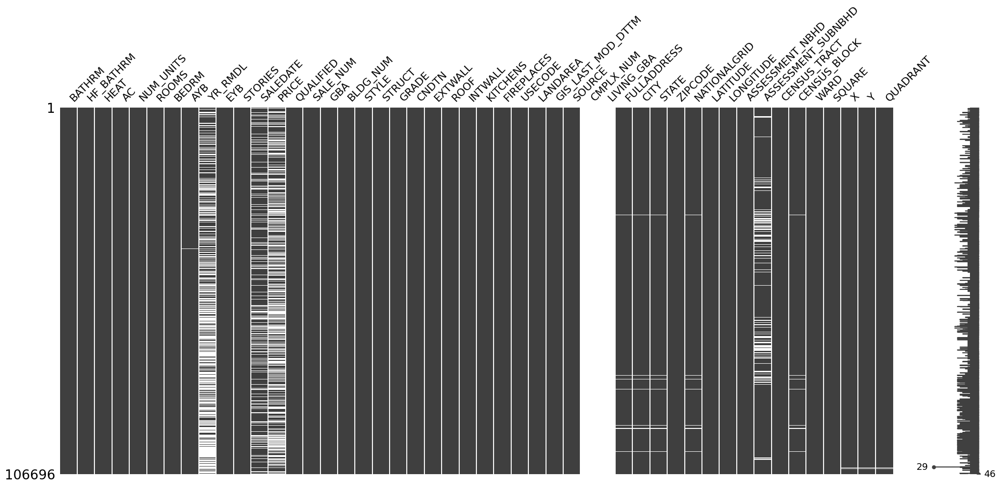

In [ ]:
missingno.matrix(df_res)

as we can see here from the matrix we can collect a conclusion that some of the information are not really necessary or we can remove them because it will be unused or unrelated, as we can see in the matrix above there's 2 missing value that is not related to any of the information ``CMPLX_NUM`` and ``LIVING_GBA``, this 2 is not realated bacause, some of the residential does not have complex number and also the GBA are fixated depending on the house builds. so we can drop this 2 column

In [ ]:
df_res = df_res.drop(['CMPLX_NUM', 'LIVING_GBA'], axis=1)

<Axes: >

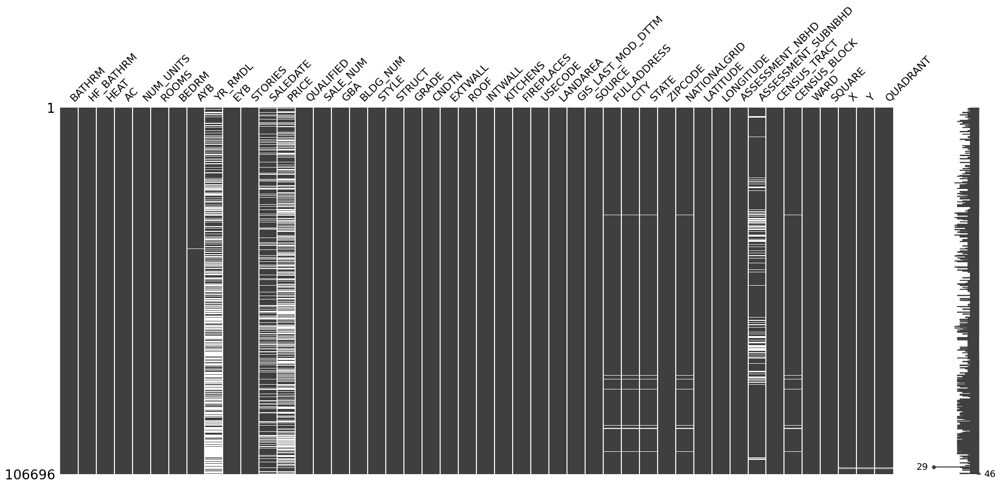

In [ ]:
missingno.matrix(df_res)

If we check the matrix again we can see that the value of the 2 column we dropped have been remove succesfully, but in the matrix we still have some missing value, so we will try to check the contribution of the missing value first

In [ ]:
df_res.isna().sum()/len(df_res.index)*100

,0
BATHRM,0.000000
HF_BATHRM,0.000000
HEAT,0.000000
AC,0.000000
NUM_UNITS,0.000000
ROOMS,0.000000
BEDRM,0.000000
AYB,0.225875
YR_RMDL,53.813639
EYB,0.000000


# *PRICE*

Amongst all of them we can see that 2 highest missing value is containing our target as well, which is ``PRICE``, other than that we also have missing value of ``YR_RMDL`` where this can be contained of the recent property remodeled year. so before we decide to drop some of the missing value in the ``PRICE`` because we wanted to analyze and predict the pricing for the property


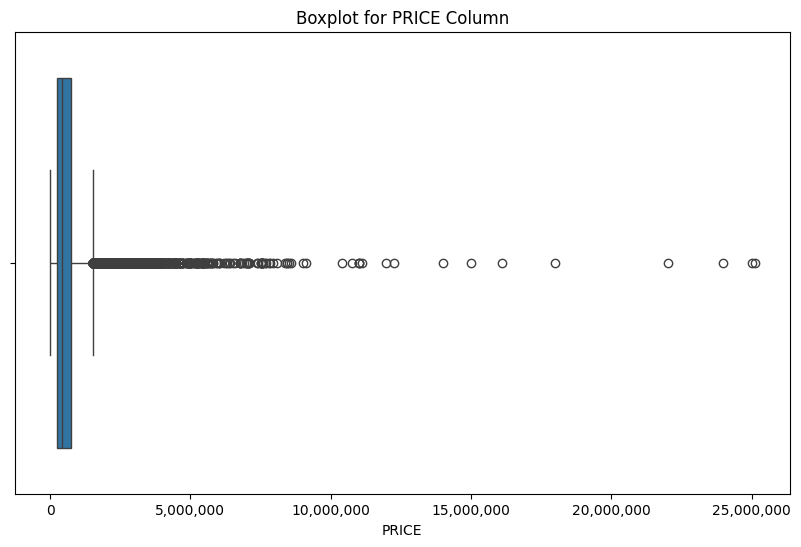

In [ ]:
from matplotlib.ticker import FuncFormatter

def format_func(value, tick_number):
    return f'{int(value):,}'

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x=df_res['PRICE'])

# Set the title and labels
plt.title('Boxplot for PRICE Column')
plt.xlabel('PRICE')

# Apply the formatter to the x-axis
plt.gca().xaxis.set_major_formatter(FuncFormatter(format_func))

# Show the plot
plt.show()

In [ ]:
df_res = df_res.dropna(subset=['PRICE'])

In [ ]:
df_res.isna().sum()/len(df_res.index)*100

,0
BATHRM,0.000000
HF_BATHRM,0.000000
HEAT,0.000000
AC,0.000000
NUM_UNITS,0.000000
ROOMS,0.000000
BEDRM,0.000000
AYB,0.164076
YR_RMDL,42.630397
EYB,0.000000


Im going to Filter The PRICE to Low, Mid, and High

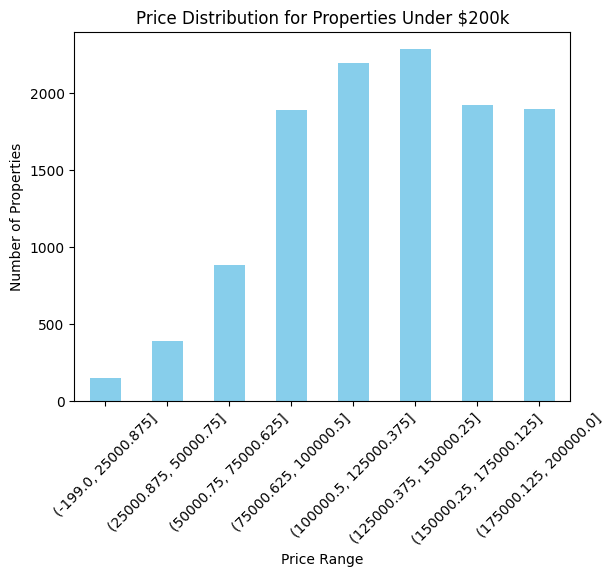

In [ ]:
price_bin_counts=df_res[df_res['PRICE']<=200000]['PRICE'].value_counts(bins=8).sort_index()
price_bin_counts.plot(kind='bar', color='skyblue')
plt.title('Price Distribution for Properties Under $200k')
plt.xlabel('Price Range')
plt.ylabel('Number of Properties')
plt.xticks(rotation=45)
plt.show()

what we can see from the BAR 1 that value have a housing that is below 50,000 , it is extremely rare to find a house priced under 50,000 in Washington, D.C. due to the city's high cost of living and strong real estate market. The average home prices in D.C. are higher than that, and we can also see the significant between BAR 1 & 2 with BAR 3, so we will take the minimum value of above 50,000 and dropping below that

In [ ]:
df_res.drop(df_res[df_res['PRICE']<50000.75].index, axis=0,inplace=True)
df_res[df_res['PRICE']<50000.75]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,SALE_NUM,GBA,BLDG_NUM,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,ASSESSMENT_SUBNBHD,CENSUS_TRACT,CENSUS_BLOCK,WARD,SQUARE,X,Y,QUADRANT


# ASSESSMENT_NBHD AND ASSESSMENT_SUBNBHD

In [ ]:
df_res['ASSESSMENT_NBHD'].unique()

array(['Old City 2', 'Foggy Bottom', 'Central-tri 1', 'Old City 1',
       'Southwest Waterfront', 'Capitol Hill', 'Georgetown',
       'Glover Park', 'Burleith', 'Palisades', 'Berkley', 'Foxhall',
       'Kent', 'Wesley Heights', 'American University', 'Spring Valley',
       'Chevy Chase', 'North Cleveland Park', 'Wakefield',
       'Cleveland Park', 'Observatory Circle', 'Forest Hills',
       'Massachusetts Avenue Heights', 'Woodley', 'Kalorama', 'Garfield',
       'Hawthorne', 'Mt. Pleasant', 'Crestwood', 'Columbia Heights',
       '16th Street Heights', 'Brightwood', 'Shepherd Heights',
       'Colonial Village', 'Petworth', 'Ledroit Park', 'Eckington',
       'Takoma Park', 'Chillum', 'Brookland', 'Riggs Park', 'Brentwood',
       'Trinidad', 'Woodridge', 'Michigan Park', 'Fort Lincoln',
       'Lily Ponds', 'Deanwood', 'Marshall Heights', 'Fort Dupont Park',
       'Hillcrest', 'Anacostia', 'Randle Heights', 'Barry Farms',
       'Congress Heights'], dtype=object)

In [ ]:
df_res['ASSESSMENT_SUBNBHD'].unique()

array(['040 D Old City 2', '040 E Old City 2', nan, '040 C Old City 2',
       '040 F Old City 2', '040 G Old City 2', '040 B Old City 2',
       '039 E Old City 1', '040 A Old City 2', '009 C Capitol Hill',
       '009 A Capitol Hill', '039 J Old City 1', '039 K Old City 1',
       '039 C Old City 1', '039 L Old City 1', '009 B Capitol Hill',
       '039 M Old City 1', '039 F Old City 1', '039 B Old City 1',
       '039 D Old City 1', '039 A Old City 1', '039 G Old City 1',
       '039 H Old City 1', '025 D Georgetown', '025 G Georgetown',
       '025 J Georgetown', '025 H Georgetown', '025 I Georgetown',
       '025 B Georgetown', '025 E Georgetown', '025 F Georgetown',
       '008 B Burleith', '008 A Burleith', '025 A Georgetown',
       '025 C Georgetown', '041 B Palisades', '004 A Berkley',
       '004 C Berkley', '030 C Kent', '004 B Berkley', '030 B Kent',
       '054 A Wesley Heights', '041 A Palisades',
       '001 B American University', '050 A Spring Valley',
       '001 C A

and as you can see we also have the location of the property based on their address, so we can remove this because we already had the full address and Longitude and Latitude of the property, but we can use the assessment_nbhd as our highlight for the location names for the property.

In [ ]:
df_res = df_res.drop(['ASSESSMENT_SUBNBHD'], axis=1)

# NUMERIC HEATMAP

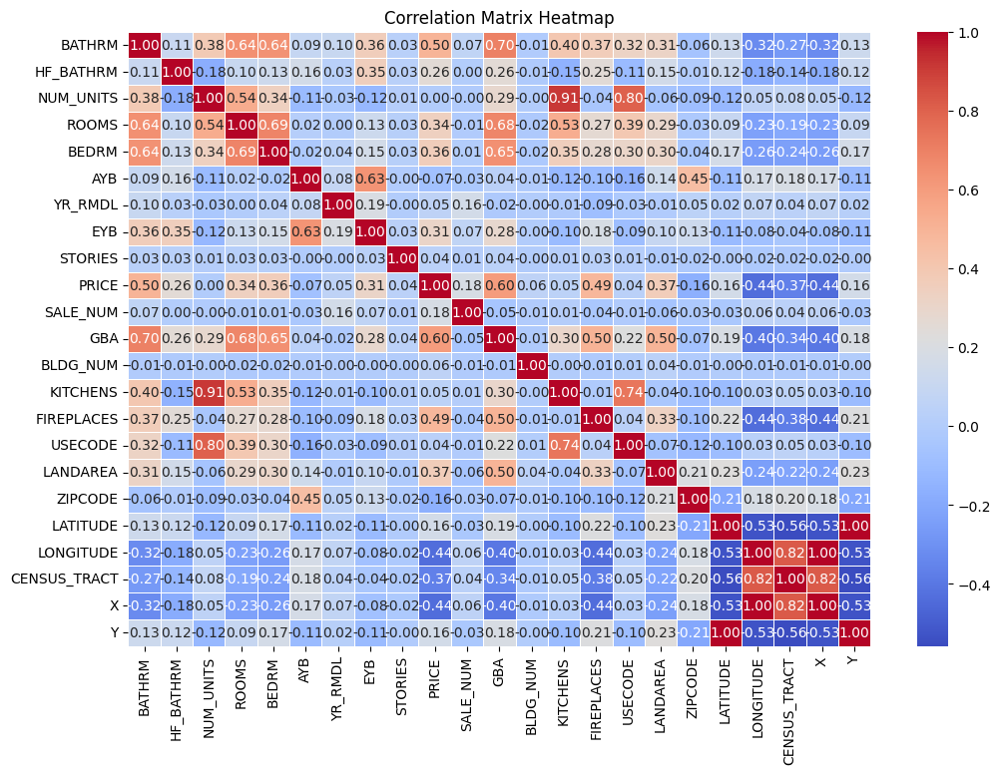

In [ ]:
# Select only numeric columns from the data
numeric_data = df_res.select_dtypes(include=['number'])

# Calculate the correlation matrix on numeric data only
correlation_matrix = numeric_data.corr()

# Create the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix Heatmap')
plt.show()


we can see that there's many information that is most likely to not related with price such as ``CENSUS_TRACT``, ``AYB``, ``SALE_NUM``, ``BLDG_NUM``, ``USECODE``, ``NUM_UNITS``. This column might not impacted the value of the price that much so for this prediction we can remove this information from the column

In [ ]:
# df_res = df_res.drop(['CENSUS_TRACT', 'CENSUS_BLOCK', 'SALE_NUM', 'BLDG_NUM', 'USECODE', 'NUM_UNITS'], axis=1)

In [ ]:
#ariq coba
df_res = df_res.drop(['CENSUS_TRACT', 'CENSUS_BLOCK', 'SALE_NUM', 'BLDG_NUM'], axis=1)

In [ ]:
df_res.isna().sum()/len(df_res.index)*100

,0
BATHRM,0.000000
HF_BATHRM,0.000000
HEAT,0.000000
AC,0.000000
NUM_UNITS,0.000000
ROOMS,0.000000
BEDRM,0.000000
AYB,0.156909
YR_RMDL,42.389902
EYB,0.000000


# YEAR REMODEL

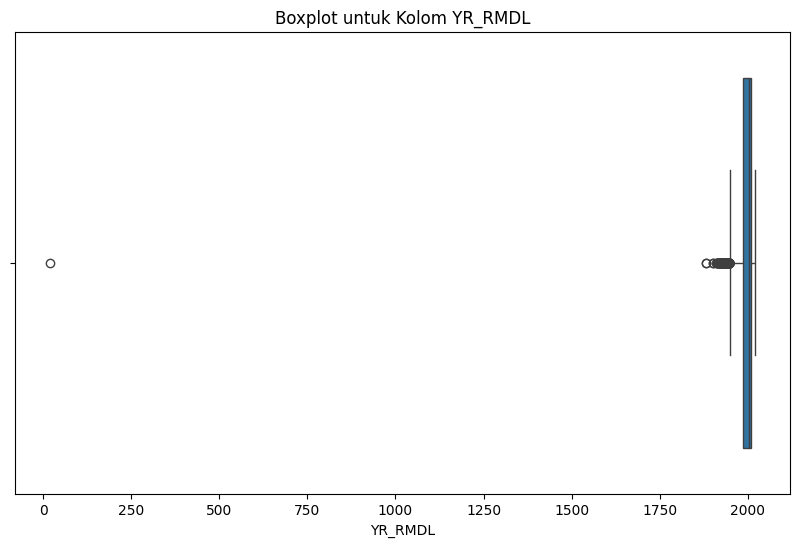

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x=df['YR_RMDL'])
plt.title('Boxplot untuk Kolom YR_RMDL')
plt.xlabel('YR_RMDL')
plt.show()

we can see that there's an anomaly in the YR_RMDL, so we have to check what is the anomaly in the data, and we can see from the last missing value check this column still have over 40% of missing value

In [ ]:
df_res['YR_RMDL'].unique()

array([1988., 2009., 2003.,   nan, 2011., 2008., 2000., 2006., 2013.,
       2010., 2004., 1963., 2014., 1978., 2016., 2007., 1974., 2002.,
       2012., 2005., 1990., 2015., 2001., 1935., 1984., 1996., 1999.,
       1975., 1950., 1985., 1980., 1987., 1998., 1956., 1991., 1992.,
       2018., 1960., 1995., 1997., 1959., 1989., 2017., 1977., 1983.,
       1973., 1966., 1981., 1976., 1965., 1979., 1962., 1994., 1964.,
       1972., 1986., 1982., 1993., 1971., 1955., 1968., 1952., 1970.,
       1945., 1958., 1947., 1940., 1961., 1939., 1957., 1953., 1967.,
       1949., 1900., 1951., 1926., 1954., 1946., 1936., 1969., 1927.,
       1880., 1943., 1925., 1922., 1934., 1941., 1948., 1942., 1930.,
       1944., 1932., 1921.,   20., 1929., 1931., 2019., 1928., 1920.,
       1917., 1910., 1923.])

so we can see that we have NaN and an anomaly of 20. there maybe it caused by typo or miss information.

In [ ]:
df_res[df_res['YR_RMDL'].isnull()].head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
5,3,2,Hot Water Rad,Y,1.0,10,5,1913.0,NaN,1972,4.0,2010-02-26 00:00:00,1950000.0,Q,5344.0,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1.0,4,11,2196,2018-07-22 18:01:43,Residential,1709 S STREET NW,WASHINGTON,DC,20009.0,18S UJ 23157 09248,38.914331,-77.039715,Old City 2,Ward 2,152,-77.040429,38.914881,NW
48,2,1,Forced Air,N,2.0,8,3,1976.0,NaN,1984,3.0,1999-12-03 00:00:00,348500.0,U,2700.0,3 Story,Multi,Above Average,Average,Common Brick,Metal- Sms,Wood Floor,2.0,0,23,1853,2018-07-22 18:01:43,Residential,1421 CORCORAN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23738 08979,38.912024,-77.032951,Old City 2,Ward 2,208,-77.033366,38.911716,NW
50,2,1,Forced Air,Y,2.0,8,3,1976.0,NaN,1984,3.0,2009-10-05 00:00:00,849000.0,Q,2700.0,3 Story,Multi,Above Average,Good,Common Brick,Built Up,Hardwood,2.0,2,23,1853,2018-07-22 18:01:43,Residential,1429 CORCORAN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23714 08979,38.912025,-77.033226,Old City 2,Ward 2,208,-77.033366,38.911716,NW
76,2,1,Warm Cool,Y,2.0,11,4,1979.0,NaN,1990,2.0,2005-08-08 00:00:00,848500.0,Q,1380.0,2 Story,Multi,Average,Good,Common Brick,Built Up,Hardwood,2.0,2,24,1236,2018-07-22 18:01:43,Residential,1920 NEW HAMPSHIRE AVENUE NW,WASHINGTON,DC,20009.0,18S UJ 23332 09440,38.916148,-77.037733,Old City 2,Ward 2,176,-77.037830,38.916190,NW
77,2,1,Warm Cool,Y,2.0,11,3,1979.0,NaN,1985,2.0,1995-11-07 00:00:00,277000.0,Q,1380.0,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,2,24,1185,2018-07-22 18:01:43,Residential,1918 NEW HAMPSHIRE AVENUE NW,WASHINGTON,DC,20009.0,18S UJ 23329 09437,38.916112,-77.037762,Old City 2,Ward 2,176,-77.037830,38.916190,NW


firstly we check the NaN value and see if this missing value can be dropped or fill.

In [ ]:
df_res[df_res['YR_RMDL']<1000]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
56600,1,1,Forced Air,Y,1.0,8,4,1929.0,20.0,1967,2.0,2015-08-06 00:00:00,335000.0,Q,1640.0,2 Story,Semi-Detached,Above Average,Good,Common Brick,Built Up,Hardwood,1.0,1,13,2380,2018-07-22 18:01:43,Residential,617 ONEIDA PLACE NW,WASHINGTON,DC,20011.0,18S UJ 24811 14526,38.962197,-77.021993,Brightwood,Ward 4,3202,-77.021133,38.962204,NW


rather than removing the value of this YR_RMDL, im just going to consider that there's no rennovation at the property so im just going to fill it with the value of the AYB means the state of the property remains the same as the first build

In [ ]:
df_res['YR_RMDL'] = df_res['YR_RMDL'].fillna(df['AYB'])

as we have seen before we still have anomaly in the YR_RMDL or a typo so we're going to check the row of that anomaly.

In [ ]:
df_res[df_res['YR_RMDL']<1000]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
56600,1,1,Forced Air,Y,1.0,8,4,1929.0,20.0,1967,2.0,2015-08-06 00:00:00,335000.0,Q,1640.0,2 Story,Semi-Detached,Above Average,Good,Common Brick,Built Up,Hardwood,1.0,1,13,2380,2018-07-22 18:01:43,Residential,617 ONEIDA PLACE NW,WASHINGTON,DC,20011.0,18S UJ 24811 14526,38.962197,-77.021993,Brightwood,Ward 4,3202,-77.021133,38.962204,NW


In [ ]:
df_res.drop(df_res[df_res['YR_RMDL']==20].index, axis=0,inplace=True)
df_res[df_res['YR_RMDL']==20]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT


after seing the information and we only have 1 information so we can drop this value

In [ ]:
df_res[df_res['YR_RMDL']<df_res['AYB']].head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
3716,1,1,Forced Air,Y,1.0,5,3,1997.0,1995.0,2004,2.0,2016-06-22 00:00:00,640000.0,Q,1484.0,2 Story,Row Inside,Above Average,Average,Common Brick,Built Up,Hardwood,1.0,0,11,975,2018-07-22 18:01:43,Residential,37 HANOVER PLACE NW,WASHINGTON,DC,20001.0,18S UJ 25702 08493,38.908045,-77.010178,Old City 2,Ward 5,617,-77.010328,38.908045,NW
3795,1,1,Warm Cool,Y,1.0,5,2,1980.0,1978.0,1992,2.0,2017-06-28 00:00:00,792500.0,Q,1356.0,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1.0,1,11,1066,2018-07-22 18:01:43,Residential,403 4TH STREET NE,WASHINGTON,DC,20002.0,18S UJ 26522 07021,38.894946,-77.000357,Old City 1,Ward 6,812,-77.000295,38.895546,NE
4015,2,1,Warm Cool,Y,2.0,6,3,1972.0,1966.0,1981,3.0,1997-10-08 00:00:00,338500.0,Q,1890.0,3 Story,Row Inside,Above Average,Good,Common Brick,Built Up,Hardwood,2.0,2,24,1327,2018-07-22 18:01:43,Residential,1733 CORCORAN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23152 08993,38.912035,-77.039709,Old City 2,Ward 2,155,-77.039833,38.911727,NW
12077,2,0,Forced Air,Y,1.0,2,2,1911.0,1880.0,1964,1.0,2014-05-02 00:00:00,570000.0,Q,1232.0,1 Story,Row Inside,Average,Good,Common Brick,Metal- Sms,Lt Concrete,1.0,1,11,864,2018-07-22 18:01:43,Residential,203 13TH STREET SE,WASHINGTON,DC,20003.0,18S UJ 27532 06152,38.887320,-76.988497,Old City 1,Ward 6,1015,-76.989324,38.886668,SE
12819,1,1,Hot Water Rad,Y,1.0,7,3,1978.0,1970.0,1984,2.0,2001-05-02 00:00:00,295000.0,Q,1444.0,2 Story,Row Inside,Average,Average,Common Brick,Built Up,Hardwood,1.0,1,11,1216,2018-07-22 18:01:43,Residential,411 11TH STREET NE,WASHINGTON,DC,20002.0,18S UJ 27310 07028,38.895166,-76.991282,Old City 1,Ward 6,985,-76.991287,38.895310,NE


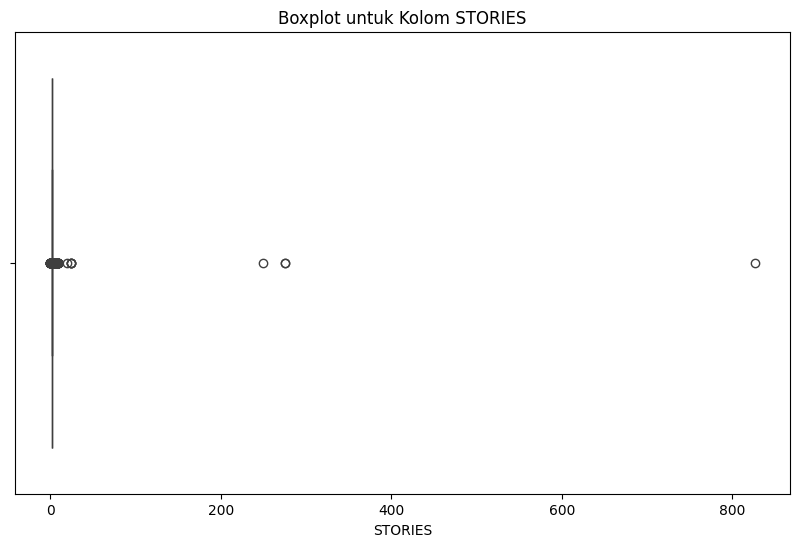

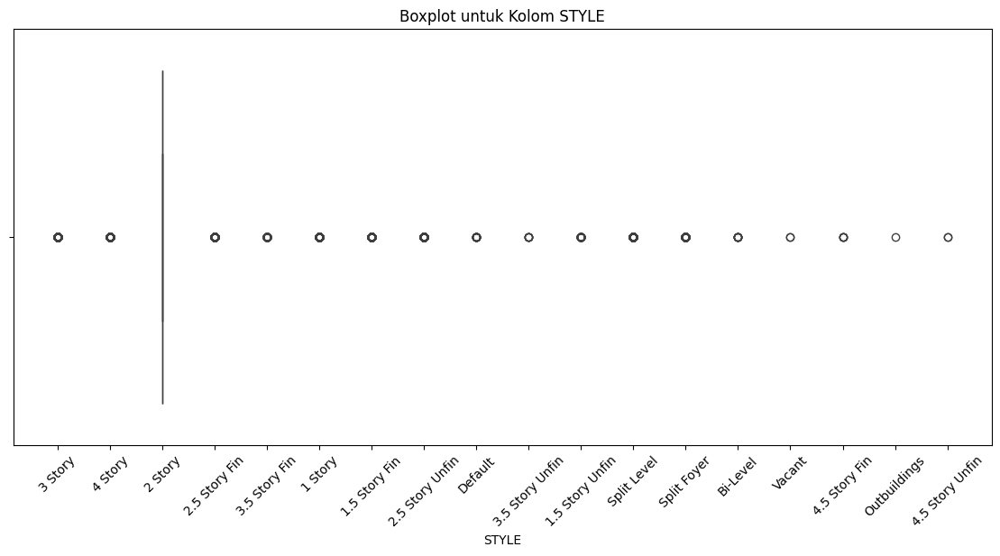

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x=df_res['STORIES'])
plt.title('Boxplot untuk Kolom STORIES')
plt.xlabel('STORIES')
plt.show()

plt.figure(figsize=(14, 6))
sns.boxplot(x=df_res['STYLE'])
plt.title('Boxplot untuk Kolom STYLE')
plt.xlabel('STYLE')
plt.xticks(rotation=45)
plt.show()

In [ ]:
df_res['STYLE'].unique()

array(['3 Story', '4 Story', '2 Story', '2.5 Story Fin', '3.5 Story Fin',
       '1 Story', '1.5 Story Fin', '2.5 Story Unfin', 'Default',
       '3.5 Story Unfin', '1.5 Story Unfin', 'Split Level', 'Split Foyer',
       'Bi-Level', 'Vacant', '4.5 Story Fin', 'Outbuildings',
       '4.5 Story Unfin'], dtype=object)

we have seen anomaly in the stories column where the amount exceeding the exact stories in washington dc which they only have the maximum amount of 5 stories, so we're going to check the value for above 4 stories

In [ ]:
df_res[df_res['STORIES']>5].head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
3252,2,1,Forced Air,Y,2.0,7,3,NaN,NaN,1967,7.0,2003-02-06 00:00:00,450000.0,Q,1806.0,3 Story,Row End,Above Average,Good,Common Brick,Built Up,Hardwood,2.0,2,24,1947,2018-07-22 18:01:43,Residential,809 Q STREET NW,WASHINGTON,DC,20001.0,18S UJ 24568 08882,38.911320,-77.023357,Old City 2,Ward 6,396,-77.023410,38.911456,NW
7546,1,2,Hot Water Rad,N,1.0,6,3,1920.0,2001.0,1969,826.0,2015-01-26 00:00:00,760000.0,Q,1442.0,4 Story,Row Inside,Good Quality,Good,Common Brick,Metal- Sms,Wood Floor,1.0,0,11,966,2018-07-22 18:01:43,Residential,664 E STREET NE,WASHINGTON,DC,20002.0,18S UJ 26868 07163,38.896299,-76.996409,Old City 1,Ward 6,861,-76.997269,38.896641,NE
8871,4,0,Warm Cool,Y,4.0,16,4,1982.0,2002.0,1993,6.0,2005-06-13 00:00:00,1215000.0,Q,4512.0,4 Story,Row End,Above Average,Good,Common Brick,Built Up,Carpet,4.0,3,24,2102,2018-07-22 18:01:43,Residential,737 6TH STREET SE,WASHINGTON,DC,20003.0,18S UJ 26623 05381,38.880202,-76.998782,Old City 1,Ward 6,847,-76.999191,38.880606,SE
20491,2,1,Warm Cool,Y,1.0,7,3,1900.0,2008.0,1992,250.0,2015-09-23 00:00:00,1459000.0,Q,1425.0,2.5 Story Fin,Row Inside,Superior,Very Good,Common Brick,Comp Shingle,Hardwood,1.0,1,11,810,2018-07-22 18:01:43,Residential,2712 N STREET NW,WASHINGTON,DC,20007.0,18S UJ 21710 08438,38.906746,-77.056187,Georgetown,Ward 2,1215,-77.056279,38.906508,NW
21170,4,2,Warm Cool,Y,1.0,10,4,1900.0,2004.0,2000,275.0,2011-02-25 00:00:00,5397500.0,U,3582.0,2.5 Story Fin,Row Inside,Exceptional-B,Very Good,Common Brick,Slate,Hardwood,2.0,4,12,5859,2018-07-22 18:01:43,Residential,2912 N STREET NW,WASHINGTON,DC,20007.0,18S UJ 21487 08439,38.906711,-77.058753,Georgetown,Ward 2,1211,-77.058763,38.906383,NW


we're going to drop the value that is more than 5

In [ ]:
df_res = df_res[df_res['STORIES']<=5]
df_res.reset_index(drop=True, inplace=True)
df_res


,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,Q,2522.0,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,Ward 2,152,-77.040429,38.914881,NW
1,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,Q,2522.0,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,Ward 2,152,-77.040429,38.914881,NW
2,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,Q,2484.0,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,Ward 2,152,-77.040429,38.914881,NW
3,3,2,Hot Water Rad,Y,1.0,10,5,1913.0,1913.0,1972,4.0,2010-02-26 00:00:00,1950000.0,Q,5344.0,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1.0,4,11,2196,2018-07-22 18:01:43,Residential,1709 S STREET NW,WASHINGTON,DC,20009.0,18S UJ 23157 09248,38.914331,-77.039715,Old City 2,Ward 2,152,-77.040429,38.914881,NW
4,3,1,Hot Water Rad,Y,2.0,8,4,1906.0,2011.0,1972,3.0,2011-09-29 00:00:00,1050000.0,Q,2401.0,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2.0,1,24,1627,2018-07-22 18:01:43,Residential,1746 1/2 T STREET NW,WASHINGTON,DC,20009.0,18S UJ 23124 09368,38.915408,-77.040129,Old City 2,Ward 2,152,-77.040429,38.914881,NW
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57289,2,0,Forced Air,N,2.0,10,4,1953.0,1953.0,1962,2.0,2004-02-10 00:00:00,95000.0,Q,1600.0,2 Story,Multi,Average,Average,Common Brick,Comp Shingle,Carpet,2.0,0,23,5837,2018-07-22 18:01:43,Residential,107 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25869 98919,38.821855,-77.005828,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW
57290,2,0,Forced Air,Y,2.0,10,4,1953.0,2017.0,1971,2.0,2016-06-27 00:00:00,185000.0,U,1600.0,2 Story,Multi,Average,Very Good,Common Brick,Built Up,Hardwood,2.0,0,23,5302,2018-07-22 18:01:43,Residential,111 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25851 98915,38.821813,-77.006034,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW
57291,2,0,Forced Air,N,2.0,10,5,1953.0,1953.0,1962,2.0,2012-02-17 00:00:00,100000.0,U,1600.0,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,0,23,5348,2018-07-22 18:01:43,Residential,127 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25818 98885,38.821534,-77.006407,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW
57292,2,0,Forced Air,N,2.0,10,4,1953.0,2017.0,1971,2.0,2017-07-27 00:00:00,215000.0,U,1600.0,2 Story,Multi,Average,Good,Common Brick,Comp Shingle,Hardwood,2.0,0,23,3046,2018-07-22 18:01:43,Residential,135 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25807 98865,38.821356,-77.006528,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW


In [ ]:
df_res[df_res['STORIES']>5]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT


As we can see we doesnt have anymore Stories that is Above 5

# GRADE and CONDITION

In [ ]:
df_res['CNDTN'].unique()

array(['Good', 'Very Good', 'Average', 'Excellent', 'Fair', 'Poor',
       'Default'], dtype=object)

we can see that there's a value of default which kind of realated to the average so im choosing the option to just change the default into Average

In [ ]:
df_res[df_res['CNDTN']=='Default']

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
2641,1,1,Forced Air,N,1.0,5,2,1900.0,1900.0,1954,2.0,2016-11-02 00:00:00,499000.0,U,904.0,2 Story,Row Inside,Average,Default,Wood Siding,Built Up,Hardwood/Carp,1.0,0,11,857,2018-07-22 18:01:43,Residential,440 RIDGE STREET NW,WASHINGTON,DC,20001.0,18S UJ 25060 08316,38.906323,-77.017537,Old City 2,Ward 6,513,-77.017409,38.906576,NW
11947,0,0,No Data,0,0.0,0,0,1953.0,2009.0,1953,2.0,2003-04-25 00:00:00,5175000.0,U,820.0,Default,Default,No Data,Default,Default,Typical,Default,0.0,0,12,7717,2018-07-22 18:01:43,Residential,3121 O STREET NW,WASHINGTON,DC,20007.0,18S UJ 21201 08655,38.908594,-77.062106,Georgetown,Ward 2,1256,-77.062742,38.909021,NW
14892,0,0,No Data,0,0.0,0,0,NaN,NaN,1943,0.0,2012-05-07 00:00:00,3400000.0,U,0.0,Default,Default,No Data,Default,Default,Typical,Default,0.0,0,19,11766,2018-07-22 18:01:43,Residential,NaN,NaN,NaN,20016.0,NaN,38.928065,-77.092325,Wesley Heights,Ward 3,1406,-77.092328,38.928072,NW
56116,0,0,No Data,0,0.0,0,0,2004.0,2004.0,2004,0.0,2018-04-13 00:00:00,25000000.0,U,2000.0,1 Story,Default,No Data,Default,Default,Typical,Default,0.0,0,19,21017,2018-07-22 18:01:43,Residential,4242 7TH STREET SE,WASHINGTON,DC,20032.0,18S UH 26720 99647,38.828575,-76.996221,Congress Heights,Ward 8,6208,-76.997729,38.827709,SE


In [ ]:
df_res['CNDTN'] = df_res['CNDTN'].replace('Default', 'Average')

In [ ]:
df_res['GRADE'].unique()

array(['Very Good', 'Above Average', 'Good Quality', 'Excellent',
       'Average', 'Superior', 'Fair Quality', 'Exceptional-D',
       'Exceptional-C', 'Exceptional-A', 'Exceptional-B', 'No Data',
       'Low Quality'], dtype=object)

In [ ]:
df_res[df_res['GRADE']=='No Data']

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
11947,0,0,No Data,0,0.0,0,0,1953.0,2009.0,1953,2.0,2003-04-25 00:00:00,5175000.0,U,820.0,Default,Default,No Data,Average,Default,Typical,Default,0.0,0,12,7717,2018-07-22 18:01:43,Residential,3121 O STREET NW,WASHINGTON,DC,20007.0,18S UJ 21201 08655,38.908594,-77.062106,Georgetown,Ward 2,1256,-77.062742,38.909021,NW
14892,0,0,No Data,0,0.0,0,0,NaN,NaN,1943,0.0,2012-05-07 00:00:00,3400000.0,U,0.0,Default,Default,No Data,Average,Default,Typical,Default,0.0,0,19,11766,2018-07-22 18:01:43,Residential,NaN,NaN,NaN,20016.0,NaN,38.928065,-77.092325,Wesley Heights,Ward 3,1406,-77.092328,38.928072,NW
56116,0,0,No Data,0,0.0,0,0,2004.0,2004.0,2004,0.0,2018-04-13 00:00:00,25000000.0,U,2000.0,1 Story,Default,No Data,Average,Default,Typical,Default,0.0,0,19,21017,2018-07-22 18:01:43,Residential,4242 7TH STREET SE,WASHINGTON,DC,20032.0,18S UH 26720 99647,38.828575,-76.996221,Congress Heights,Ward 8,6208,-76.997729,38.827709,SE


We found that there's a value of No Data, so i assume that this information is Missing Value so im going to drop the value of this

In [ ]:
df_res = df_res[df_res['GRADE']!='No Data']
df_res.reset_index(drop=True, inplace=True)
df_res

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,SALEDATE,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,CITY,STATE,ZIPCODE,NATIONALGRID,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,X,Y,QUADRANT
0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,2003-11-25 00:00:00,1095000.0,Q,2522.0,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,1748 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23061 09289,38.914680,-77.040832,Old City 2,Ward 2,152,-77.040429,38.914881,NW
1,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2016-06-21 00:00:00,2100000.0,Q,2522.0,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,1744 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23074 09289,38.914684,-77.040678,Old City 2,Ward 2,152,-77.040429,38.914881,NW
2,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,2006-07-12 00:00:00,1602000.0,Q,2484.0,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,1742 SWANN STREET NW,WASHINGTON,DC,20009.0,18S UJ 23078 09288,38.914683,-77.040629,Old City 2,Ward 2,152,-77.040429,38.914881,NW
3,3,2,Hot Water Rad,Y,1.0,10,5,1913.0,1913.0,1972,4.0,2010-02-26 00:00:00,1950000.0,Q,5344.0,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1.0,4,11,2196,2018-07-22 18:01:43,Residential,1709 S STREET NW,WASHINGTON,DC,20009.0,18S UJ 23157 09248,38.914331,-77.039715,Old City 2,Ward 2,152,-77.040429,38.914881,NW
4,3,1,Hot Water Rad,Y,2.0,8,4,1906.0,2011.0,1972,3.0,2011-09-29 00:00:00,1050000.0,Q,2401.0,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2.0,1,24,1627,2018-07-22 18:01:43,Residential,1746 1/2 T STREET NW,WASHINGTON,DC,20009.0,18S UJ 23124 09368,38.915408,-77.040129,Old City 2,Ward 2,152,-77.040429,38.914881,NW
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57286,2,0,Forced Air,N,2.0,10,4,1953.0,1953.0,1962,2.0,2004-02-10 00:00:00,95000.0,Q,1600.0,2 Story,Multi,Average,Average,Common Brick,Comp Shingle,Carpet,2.0,0,23,5837,2018-07-22 18:01:43,Residential,107 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25869 98919,38.821855,-77.005828,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW
57287,2,0,Forced Air,Y,2.0,10,4,1953.0,2017.0,1971,2.0,2016-06-27 00:00:00,185000.0,U,1600.0,2 Story,Multi,Average,Very Good,Common Brick,Built Up,Hardwood,2.0,0,23,5302,2018-07-22 18:01:43,Residential,111 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25851 98915,38.821813,-77.006034,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW
57288,2,0,Forced Air,N,2.0,10,5,1953.0,1953.0,1962,2.0,2012-02-17 00:00:00,100000.0,U,1600.0,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,0,23,5348,2018-07-22 18:01:43,Residential,127 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25818 98885,38.821534,-77.006407,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW
57289,2,0,Forced Air,N,2.0,10,4,1953.0,2017.0,1971,2.0,2017-07-27 00:00:00,215000.0,U,1600.0,2 Story,Multi,Average,Good,Common Brick,Comp Shingle,Hardwood,2.0,0,23,3046,2018-07-22 18:01:43,Residential,135 JOLIET STREET SW,WASHINGTON,DC,20032.0,18S UH 25807 98865,38.821356,-77.006528,Congress Heights,Ward 8,6254,-77.006347,38.821799,SW


# LONGITUDE, LATITUDE AND X, Y

In [ ]:
unique_longitude = df_res['LONGITUDE'].unique()
unique_latitude = df_res['LATITUDE'].unique()
unique_x = df_res['X'].unique()
unique_y = df_res['Y'].unique()
print("Unique LONGITUDE values:", unique_longitude)
print("Unique LATITUDE values:", unique_latitude)
print("Unique X values:", unique_x)
print("Unique Y values:", unique_y)

Unique LONGITUDE values: [-77.04083204 -77.04067788 -77.04062899 ... -77.00640655 -77.00652791
 -77.00657074]
Unique LATITUDE values: [38.91468021 38.91468351 38.91468254 ... 38.82153375 38.82135637
 38.8212997 ]
Unique X values: [-77.04042907 -77.03336605 -77.03545444 ... -76.99726599 -76.99956187
 -77.00634722]
Unique Y values: [38.91488111 38.91171593 38.91495561 ... 38.82494627 38.84826406
 38.82179948]


we can see that the unique value for LONGITUDE & LATITUDE and X & Y, have a similar value so we can drop either one, but in this analysis im going to just use LONGITUDE & LATITUDE

In [ ]:
df_res = df_res.drop(['X', 'Y'], axis=1)

# NATIONAL GRID

In [ ]:
df_res['NATIONALGRID'].unique()

array(['18S UJ 23061 09289', '18S UJ 23074 09289', '18S UJ 23078 09288',
       ..., '18S UH 25818 98885', '18S UH 25807 98865',
       '18S UH 25804 98859'], dtype=object)

This national grid was not really necessary for us so we can just drop this value because we can still use the longitude or latitude of the location instead of the national grid sowe can just remove this value

In [ ]:
df_res = df_res.drop(['NATIONALGRID'], axis=1)

# STATE AND CITY

In [ ]:
df_res['CITY'].unique()

array(['WASHINGTON', nan], dtype=object)

In [ ]:
df_res['STATE'].unique()

array(['DC', nan], dtype=object)

In [ ]:
df_res = df_res.drop(['CITY', 'STATE'], axis=1)

We can see that each of the state and city only have 1 value and since we're analyzing the property in Washington DC, so this information wasn't really necessary so we can just remove it from the data

# FILTERING THE SALES YEAR

In [ ]:
df_res['SALEDATE'] = pd.to_datetime(df_res['SALEDATE'])
df_res['SALEYEAR'] = df_res['SALEDATE'].dt.year

df_res['SALEYEAR']

,SALEYEAR
0,2003
1,2016
2,2006
3,2010
4,2011
...,...
57286,2004
57287,2016
57288,2012
57289,2017


In [ ]:
df_salesyears = df_res[df_res['SALEYEAR'] >= 2014].reset_index()
df_salesyears['SALEYEAR'].value_counts()


,count
SALEYEAR,
2017,5307
2016,4237
2015,3837
2014,3507
2018,3117


# FILTERING THE SALES MONTH

In [ ]:
df_res['SALEDATE'] = pd.to_datetime(df_res['SALEDATE'])
df_res['SALEMONTH'] = df_res['SALEDATE'].dt.strftime('%b')

# Eliminasi kolom SALEDATE
df_res.drop('SALEDATE', axis = 1, inplace = True)
df_res['SALEMONTH']

,SALEMONTH
0,Nov
1,Jun
2,Jul
3,Feb
4,Sep
...,...
57286,Feb
57287,Jun
57288,Feb
57289,Jul


In [ ]:
# df_res = df_res[df_res['SALEYEAR']>=2014]
# df_res.reset_index(drop=True, inplace=True)
# df_res

#  KITCHEN

In [ ]:
df_res[df_res['KITCHENS']>10]

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,ZIPCODE,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
40065,4,0,Hot Water Rad,N,4.0,16,4,1939.0,2014.0,1964,2.0,315000.0,U,3460.0,2 Story,Multi,Average,Good,Common Brick,Built Up,Hardwood,44.0,0,23,3500,2018-07-22 18:01:43,Residential,1266 SIMMS PLACE NE,20002.0,38.908976,-76.983331,Trinidad,Ward 5,4052,NE,2013,Sep


we can see there's an anomaly in the kitchen column that there's a amount of 44 Kitchen which it didn't make sense so since its only one we can drop this row

In [ ]:
df_res = df_res[df_res['KITCHENS']<=10]
df_res.reset_index(drop=True, inplace=True)
df_res


,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,SOURCE,FULLADDRESS,ZIPCODE,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
0,4,0,Warm Cool,Y,2.0,8,4,1910.0,1988.0,1972,3.0,1095000.0,Q,2522.0,3 Story,Row Inside,Very Good,Good,Common Brick,Metal- Sms,Hardwood,2.0,5,24,1680,2018-07-22 18:01:43,Residential,1748 SWANN STREET NW,20009.0,38.914680,-77.040832,Old City 2,Ward 2,152,NW,2003,Nov
1,3,1,Hot Water Rad,Y,2.0,9,5,1910.0,2009.0,1984,3.0,2100000.0,Q,2522.0,3 Story,Row Inside,Very Good,Very Good,Common Brick,Built Up,Hardwood,2.0,4,24,1680,2018-07-22 18:01:43,Residential,1744 SWANN STREET NW,20009.0,38.914684,-77.040678,Old City 2,Ward 2,152,NW,2016,Jun
2,3,1,Hot Water Rad,Y,2.0,8,5,1900.0,2003.0,1984,3.0,1602000.0,Q,2484.0,3 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,2.0,3,24,1680,2018-07-22 18:01:43,Residential,1742 SWANN STREET NW,20009.0,38.914683,-77.040629,Old City 2,Ward 2,152,NW,2006,Jul
3,3,2,Hot Water Rad,Y,1.0,10,5,1913.0,1913.0,1972,4.0,1950000.0,Q,5344.0,4 Story,Row Inside,Very Good,Good,Common Brick,Built Up,Hardwood,1.0,4,11,2196,2018-07-22 18:01:43,Residential,1709 S STREET NW,20009.0,38.914331,-77.039715,Old City 2,Ward 2,152,NW,2010,Feb
4,3,1,Hot Water Rad,Y,2.0,8,4,1906.0,2011.0,1972,3.0,1050000.0,Q,2401.0,3 Story,Row Inside,Very Good,Average,Common Brick,Metal- Sms,Hardwood,2.0,1,24,1627,2018-07-22 18:01:43,Residential,1746 1/2 T STREET NW,20009.0,38.915408,-77.040129,Old City 2,Ward 2,152,NW,2011,Sep
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57284,2,0,Forced Air,N,2.0,10,4,1953.0,1953.0,1962,2.0,95000.0,Q,1600.0,2 Story,Multi,Average,Average,Common Brick,Comp Shingle,Carpet,2.0,0,23,5837,2018-07-22 18:01:43,Residential,107 JOLIET STREET SW,20032.0,38.821855,-77.005828,Congress Heights,Ward 8,6254,SW,2004,Feb
57285,2,0,Forced Air,Y,2.0,10,4,1953.0,2017.0,1971,2.0,185000.0,U,1600.0,2 Story,Multi,Average,Very Good,Common Brick,Built Up,Hardwood,2.0,0,23,5302,2018-07-22 18:01:43,Residential,111 JOLIET STREET SW,20032.0,38.821813,-77.006034,Congress Heights,Ward 8,6254,SW,2016,Jun
57286,2,0,Forced Air,N,2.0,10,5,1953.0,1953.0,1962,2.0,100000.0,U,1600.0,2 Story,Multi,Average,Average,Common Brick,Built Up,Hardwood,2.0,0,23,5348,2018-07-22 18:01:43,Residential,127 JOLIET STREET SW,20032.0,38.821534,-77.006407,Congress Heights,Ward 8,6254,SW,2012,Feb
57287,2,0,Forced Air,N,2.0,10,4,1953.0,2017.0,1971,2.0,215000.0,U,1600.0,2 Story,Multi,Average,Good,Common Brick,Comp Shingle,Hardwood,2.0,0,23,3046,2018-07-22 18:01:43,Residential,135 JOLIET STREET SW,20032.0,38.821356,-77.006528,Congress Heights,Ward 8,6254,SW,2017,Jul


# AC dan Heat

In [ ]:
df_res['AC'].unique()

array(['Y', 'N', '0'], dtype=object)

In [ ]:
df_res['AC'] = df_res['AC'].replace('0', 'N')

We change the value of 0 into N or NO, means that we consider that 0 is a no

In [ ]:
df_res['HEAT'].unique()

array(['Warm Cool', 'Hot Water Rad', 'Forced Air', 'Elec Base Brd',
       'Ht Pump', 'Wall Furnace', 'Water Base Brd', 'Electric Rad',
       'Air Exchng', 'Evp Cool', 'No Data', 'Ind Unit', 'Gravity Furnac',
       'Air-Oil'], dtype=object)

We didnt drop the value of No Data because based on domain knowledge we can consider this as a NO

# NUMERIC

In [ ]:
numeric_cols = df_res.select_dtypes(include=['number']).columns
numeric_cols

Index(['BATHRM', 'HF_BATHRM', 'NUM_UNITS', 'ROOMS', 'BEDRM', 'AYB', 'YR_RMDL',
       'EYB', 'STORIES', 'PRICE', 'GBA', 'KITCHENS', 'FIREPLACES', 'USECODE',
       'LANDAREA', 'ZIPCODE', 'LATITUDE', 'LONGITUDE', 'SALEYEAR'],
      dtype='object')

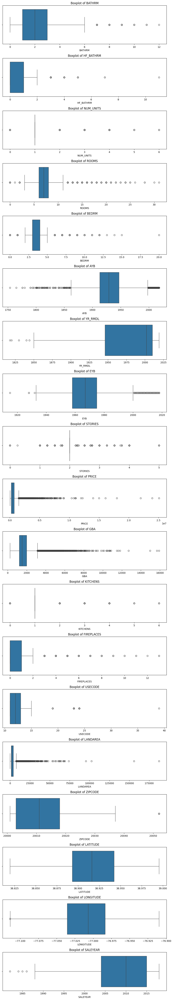

In [ ]:
numeric_cols = df_res.select_dtypes(include=['number']).columns
numeric_cols
# Buat subplot untuk setiap kolom numerik
fig, axes = plt.subplots(nrows=len(numeric_cols), figsize=(10, 3*len(numeric_cols)))

for i, feature in enumerate(numeric_cols):
    sns.boxplot(x=df_res[feature], ax=axes[i])
    axes[i].set_title(f'Boxplot of {feature}')

plt.tight_layout()
plt.show()

In [ ]:
# Misalkan kita ingin melihat outlier untuk kolom 'Net Sales'
numeric_columns = df.select_dtypes(include=[np.number]).columns

# Inisialisasi dictionary untuk menyimpan persentase outlier
outlier_percentages = {}

for column in numeric_columns:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Menghitung jumlah outlier
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    num_outliers = outliers.shape[0]

    # Menghitung persentase outlier
    total_data = df.shape[0]
    percentage_outliers = (num_outliers / total_data) * 100

    # Menyimpan hasil dalam dictionary
    outlier_percentages[column] = percentage_outliers

# Mengonversi hasil ke DataFrame untuk visualisasi atau penyimpanan
outlier_df = pd.DataFrame.from_dict(outlier_percentages, orient='index', columns=['Outlier Percentage'])

# Menampilkan hasil
print(outlier_df)

              Outlier Percentage
BATHRM                  6.438219
HF_BATHRM               0.229622
NUM_UNITS               8.936379
ROOMS                   4.033795
BEDRM                  10.740641
AYB                     0.223960
YR_RMDL                 0.164824
EYB                    14.404524
STORIES                17.171310
PRICE                   3.557566
SALE_NUM               11.101744
GBA                     4.016810
BLDG_NUM                0.045924
KITCHENS               10.229811
FIREPLACES              2.374227
USECODE                 0.011324
LANDAREA                7.018879
CMPLX_NUM               2.225130
LIVING_GBA              1.314192
ZIPCODE                 3.665771
LATITUDE                1.622451
LONGITUDE               0.000000
CENSUS_TRACT            0.000000
X                       0.000000
Y                       1.667747


Now Cleaning the remaining missing value

In [ ]:
df_res.dropna(inplace=True)

i choose this outcome because i consider that the value of nan means no remodeled has been done, that is why i choose this outcome and after we fill in the value of nan we can see from the unique that we have 1 typo.

# ANALYSIS

<ipython-input-70-b7771f44cf41>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='BEDRM', y='PRICE', data=avg_price_bedrooms, palette='viridis')


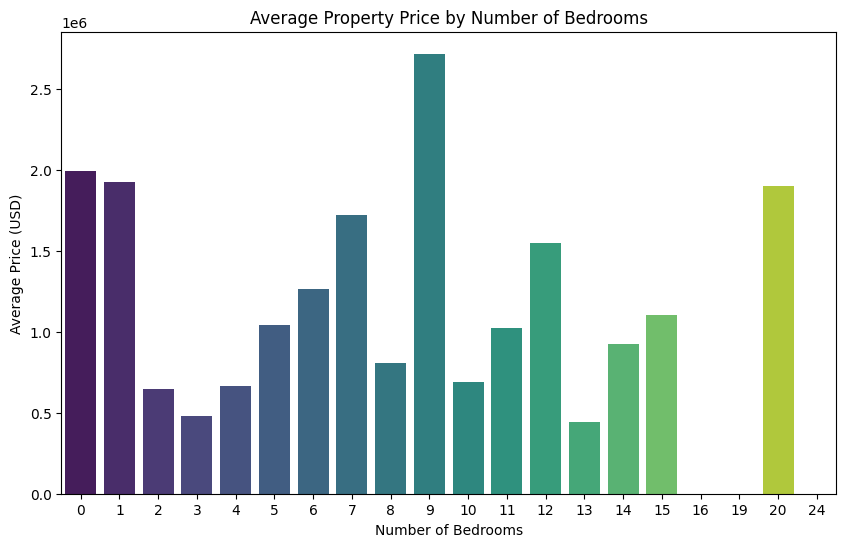

In [ ]:
avg_price_bedrooms = df.groupby('BEDRM')['PRICE'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(x='BEDRM', y='PRICE', data=avg_price_bedrooms, palette='viridis')
plt.title('Average Property Price by Number of Bedrooms')
plt.xlabel('Number of Bedrooms')
plt.ylabel('Average Price (USD)')
plt.xticks(rotation=0)
plt.show()

In [ ]:
df['SALEDATE'] = pd.to_datetime(df['SALEDATE'])
df['SALEDATE'] = pd.to_datetime(df['SALEDATE'])

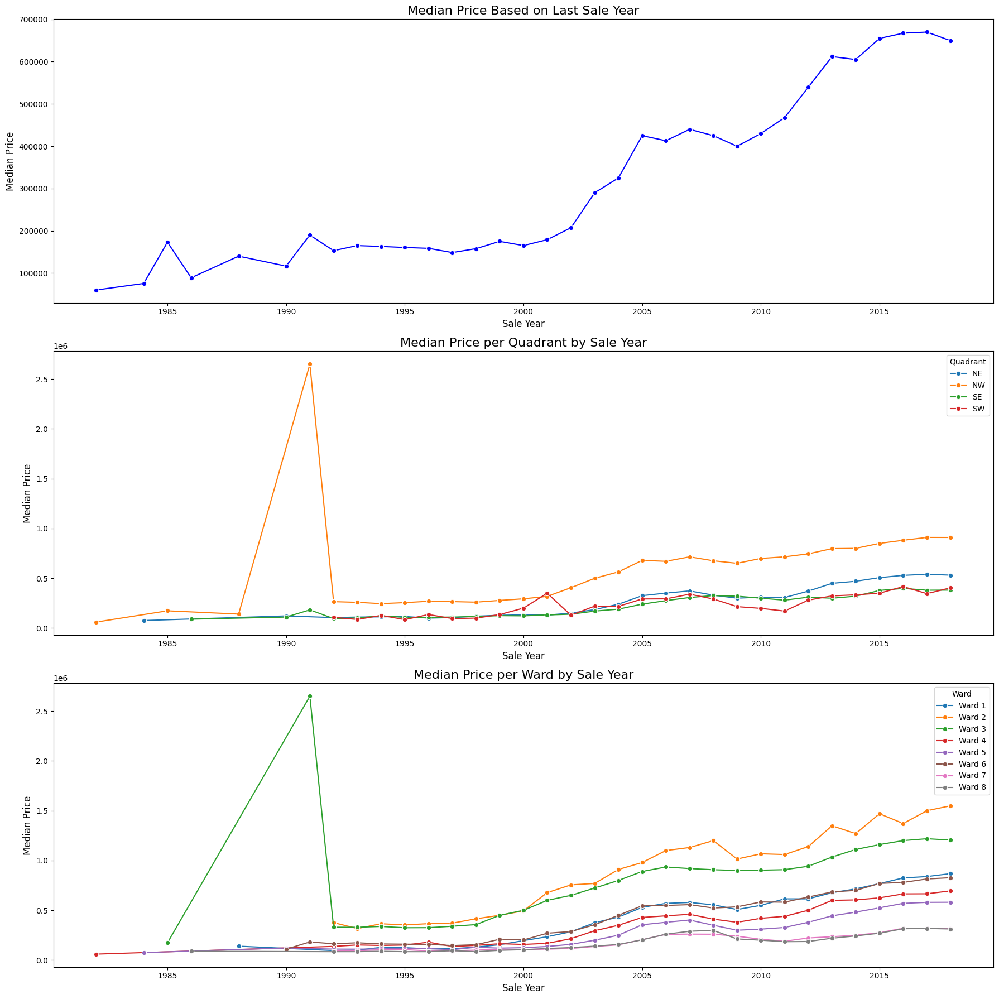

In [ ]:
# Grouping the data
yearly_med = df_res.groupby('SALEYEAR').median('PRICE')
yearly_quad = df_res.groupby(['QUADRANT', 'SALEYEAR']).median('PRICE').reset_index()
yearly_ward = df_res.groupby(['WARD', 'SALEYEAR']).median('PRICE').reset_index()

# Plotting
fig, axes = plt.subplots(3, 1, figsize=(18, 18))

# Median price based on sale year
sns.lineplot(data=yearly_med, x=yearly_med.index, y='PRICE', ax=axes[0], color='b', marker="o")
axes[0].set_title('Median Price Based on Last Sale Year', fontsize=16)
axes[0].set_xlabel('Sale Year', fontsize=12)
axes[0].set_ylabel('Median Price', fontsize=12)

# Median price per quadrant based on sale year
sns.lineplot(data=yearly_quad, x='SALEYEAR', y='PRICE', hue='QUADRANT', ax=axes[1], marker="o")
axes[1].set_title('Median Price per Quadrant by Sale Year', fontsize=16)
axes[1].set_xlabel('Sale Year', fontsize=12)
axes[1].set_ylabel('Median Price', fontsize=12)
axes[1].legend(title='Quadrant')

# Median price per ward based on sale year
sns.lineplot(data=yearly_ward, x='SALEYEAR', y='PRICE', hue='WARD', ax=axes[2], marker="o")
axes[2].set_title('Median Price per Ward by Sale Year', fontsize=16)
axes[2].set_xlabel('Sale Year', fontsize=12)
axes[2].set_ylabel('Median Price', fontsize=12)
axes[2].legend(title='Ward')

# Adjust layout
plt.tight_layout()
plt.show()


we can see that in 1990 there is a price spikes in Ward 3 and the location is in the north west of Washington DC, this can be due to a price of the land have increased.
1. From 1980 to 2015, there was a discernible upward trend in property values, with a notable uptick after 2000, suggesting a general expansion of the market.
2. Prices steadily rise in the NW Quadrant, whereas the SW Quadrant sees a significant price jump about 1990. The patterns in the other quadrants (NE, SE) are more consistent and fluctuate less.
3. The largest price jumps, particularly around 1990, are found in Wards 3 and 2. The majority of other wards exhibit steady rises, especially after 2000, which is indicative of the diverse real estate dynamics found in each ward.

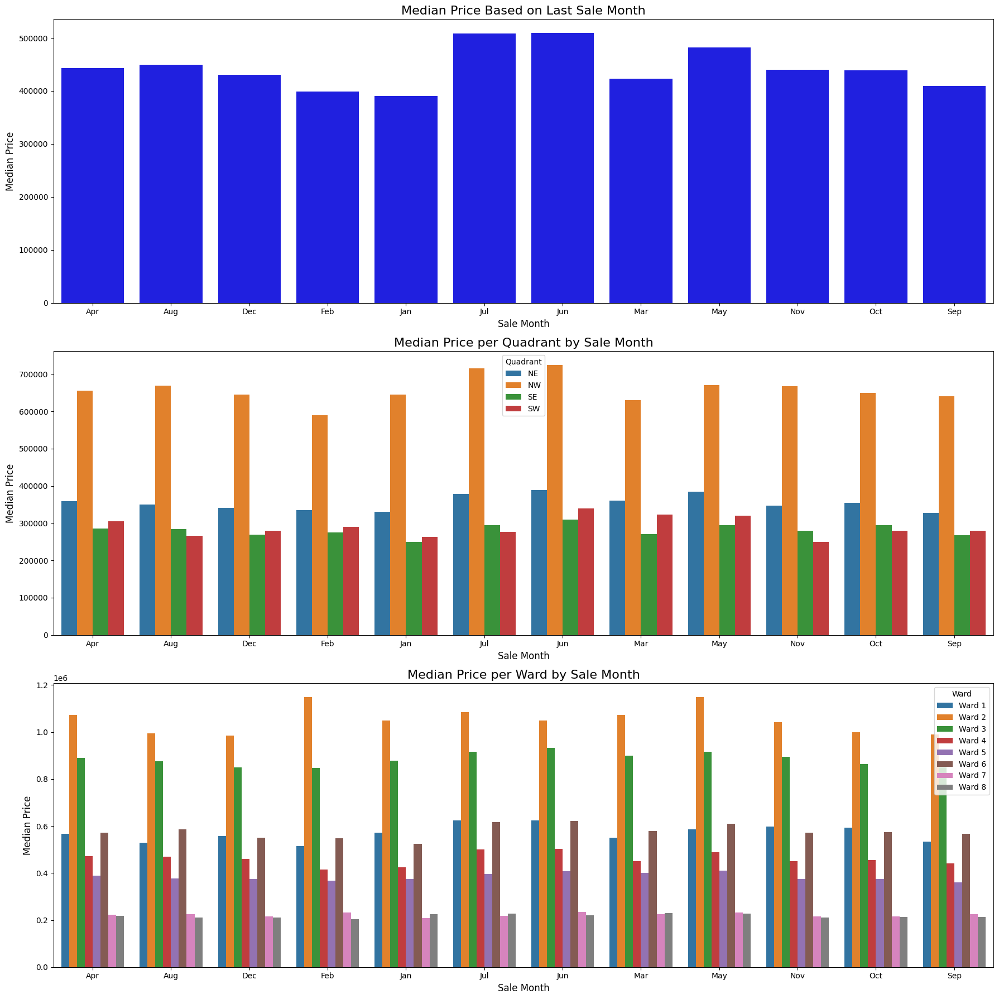

In [ ]:
# Grouping by SALEMONTH
monthly_med = df_res.groupby('SALEMONTH').median('PRICE')
monthly_quad = df_res.groupby(['QUADRANT', 'SALEMONTH']).median('PRICE').reset_index()
monthly_ward = df_res.groupby(['WARD', 'SALEMONTH']).median('PRICE').reset_index()

# Plotting
fig, axes = plt.subplots(3, 1, figsize=(18, 18))

# Median price based on sale month
sns.barplot(data=monthly_med.reset_index(), x='SALEMONTH', y='PRICE', ax=axes[0], color='blue')
axes[0].set_title('Median Price Based on Last Sale Month', fontsize=16)
axes[0].set_xlabel('Sale Month', fontsize=12)
axes[0].set_ylabel('Median Price', fontsize=12)

# Median price per quadrant based on sale month
sns.barplot(data=monthly_quad, x='SALEMONTH', y='PRICE', hue='QUADRANT', ax=axes[1])
axes[1].set_title('Median Price per Quadrant by Sale Month', fontsize=16)
axes[1].set_xlabel('Sale Month', fontsize=12)
axes[1].set_ylabel('Median Price', fontsize=12)
axes[1].legend(title='Quadrant')

# Median price per ward based on sale month
sns.barplot(data=monthly_ward, x='SALEMONTH', y='PRICE', hue='WARD', ax=axes[2])
axes[2].set_title('Median Price per Ward by Sale Month', fontsize=16)
axes[2].set_xlabel('Sale Month', fontsize=12)
axes[2].set_ylabel('Median Price', fontsize=12)
axes[2].legend(title='Ward')

# Adjust layout
plt.tight_layout()
plt.show()


1. Overall Monthly Trends (Top Plot): The median property price remains relatively stable throughout the year, with slight peaks in July and June. This suggests that properties may sell for higher prices during mid to late summer and early fall.

2. Quadrant Comparison (Middle Plot): The SW Quadrant consistently has the highest median prices across all months. Other quadrants like NE, NW, and SE show more moderate prices, with little variation month-to-month.

3. Ward Analysis (Bottom Plot): Ward 2 shows the highest median property prices, followed by Ward 3, with little change throughout the year. Other wards, such as Ward 7 and Ward 8, have significantly lower median prices in comparison, showing disparities in property values across different areas.

![image.png](attachment:image.png)

This picture attached shows the location of a WARD which contains WARD 1 until WARD 8
- Ward 1: A lively and diverse area, known for its nightlife and cultural mix. Popular neighborhoods include Adams Morgan and Columbia Heights.

- Ward 2: One of the wealthiest areas, home to historic neighborhoods like Georgetown and Dupont Circle, as well as major government offices.

- Ward 3: A quiet, mostly residential ward with large homes and lots of green spaces. Neighborhoods like Chevy Chase and Tenleytown are family-friendly and affluent.

- Ward 4: A mix of residential and commercial areas, with some neighborhoods, like Petworth, undergoing gentrification and development.

- Ward 5: An area in transition, with new development pushing property prices up in neighborhoods like Brookland and Eckington.

- Ward 6: A dynamic, centrally located ward that includes Capitol Hill and the rapidly developing Navy Yard, with a mix of old and new housing.

- Ward 7: Located in the eastern part of D.C., this ward is more affordable but is starting to see development and rising property values.

- Ward 8: Historically one of the more economically challenged wards, but it's experiencing redevelopment, especially in neighborhoods like Anacostia.

<ipython-input-74-fcbd19ebb279>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='PRICE', y='CNDTN', data=df_res,  palette='Blues')


Text(0, 0.5, 'Condition')

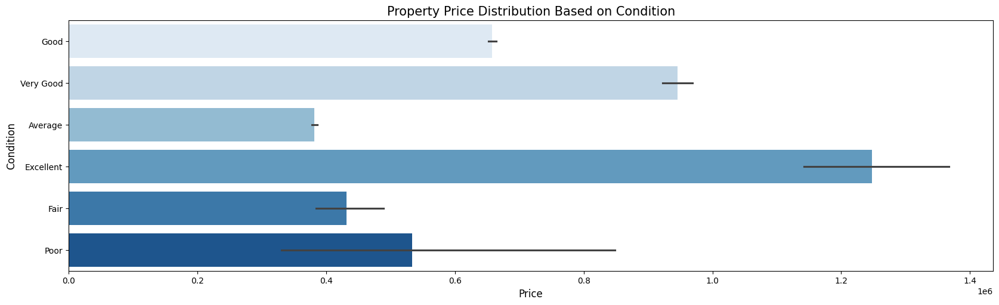

In [ ]:
# Create a boxplot for PRICE based on CONDITION and GRADE
plt.figure(figsize=(20, 12))

# First subplot for Condition
plt.subplot(2, 1, 1)
sns.barplot(x='PRICE', y='CNDTN', data=df_res,  palette='Blues')
plt.title('Property Price Distribution Based on Condition', fontsize=15)
plt.xlabel('Price', fontsize=12)
plt.ylabel('Condition', fontsize=12)



we can see that there's a significant distribution on the excellent condition by means that with excellence condition it provide a very high or great market price.

<ipython-input-75-06f74d5fa057>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='PRICE', y='GRADE', data=df_res, palette='Greens')


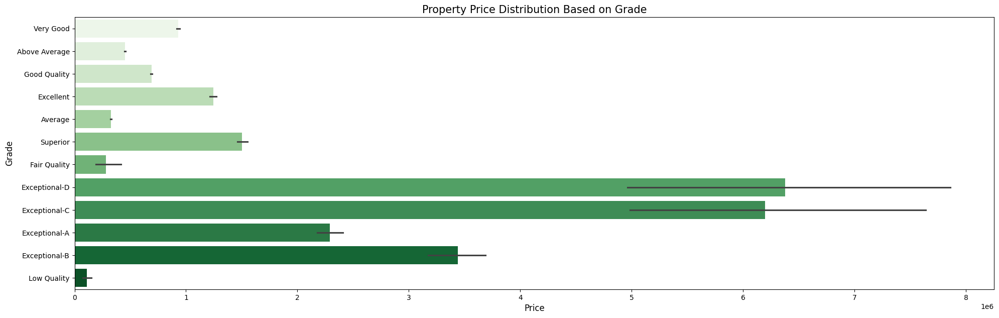

In [ ]:
# Second subplot for Grade
plt.figure(figsize=(20, 12))
plt.subplot(2, 1, 1)
sns.barplot(x='PRICE', y='GRADE', data=df_res, palette='Greens')
plt.title('Property Price Distribution Based on Grade', fontsize=15)
plt.xlabel('Price', fontsize=12)
plt.ylabel('Grade', fontsize=12)

# Display the plot
plt.tight_layout()
plt.show()

Exceptional A: Represents the highest quality properties with luxurious finishes, modern amenities, and excellent maintenance, typically located in desirable neighborhoods. These properties command premium prices.

Exceptional B: High-quality properties that are slightly below Exceptional A, featuring good construction and finishes, well-maintained but lacking some luxury features. They are still highly desirable and priced attractively.

Exceptional C: Average quality properties that offer a balance between price and condition, often requiring some updates or repairs. These are located in decent neighborhoods and appeal to buyers seeking value.

Exceptional D: Lower-quality properties that may need significant repairs or renovations, often located in less desirable areas. These properties are priced lower, targeting investors or buyers willing to invest in improvements.

as we can see that 2 Highest distribution is coming from Exceptional D and Exceptional C, which this higher price may caused by the demand of the customer, they mostly interested in buying with this grade specification

# LOCATION CO0RDINATE

In [ ]:
df_res['PRICE'].max()

25100000.0

In [ ]:
fig = px.scatter_mapbox(df_res,
                        lon = df_res['LONGITUDE'],
                        lat = df_res['LATITUDE'],
                        zoom = 3,
                        color=df_res['PRICE'],
                        range_color=[0,1650000],
                        width = 1200,
                        height = 900,
                        title = '5 Busiest Tap Ins BRT Bus Stop based on CorridorType')
fig.update_traces(marker=dict(size=2.5))
fig.update_layout(mapbox_style='carto-positron',margin=dict(l=10,r=0,t=40,b=10))
fig.show()

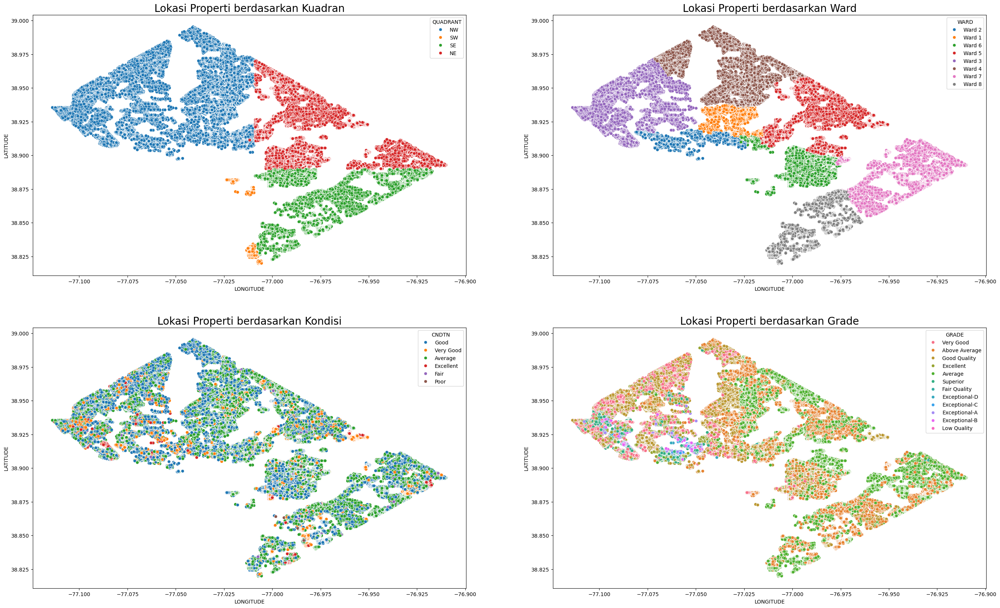

In [ ]:

fig, axes = plt.subplots(2,2, figsize=(33,20))

sns.scatterplot(data=df_res,
                x='LONGITUDE',
                y='LATITUDE',
                hue='QUADRANT',
                ax=axes[0][0]).set_title('Lokasi Properti berdasarkan Kuadran',size=20)
sns.scatterplot(data=df_res,
                x='LONGITUDE',
                y='LATITUDE',
                hue='WARD',
                ax=axes[0][1]).set_title('Lokasi Properti berdasarkan Ward',size=20)
sns.scatterplot(data=df_res,
                x ='LONGITUDE',
                y='LATITUDE',
                hue='CNDTN',
                ax=axes[1][0]).set_title('Lokasi Properti berdasarkan Kondisi',size=20)
sns.scatterplot(data=df_res,
                x='LONGITUDE',
                y='LATITUDE',
                hue='GRADE',
                ax=axes[1][1]).set_title('Lokasi Properti berdasarkan Grade',size=20)
plt.show()

In [ ]:
df_res['PRICE'].mean()

584407.5344147381

Because of the distribution from the graph above we can see that the graph more to the left side so we can find the average price for PRICE that is being paid by the customer in Washington .D.C is $584,918

<ipython-input-80-0dad66c6f399>:14: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-80-0dad66c6f399>:25: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




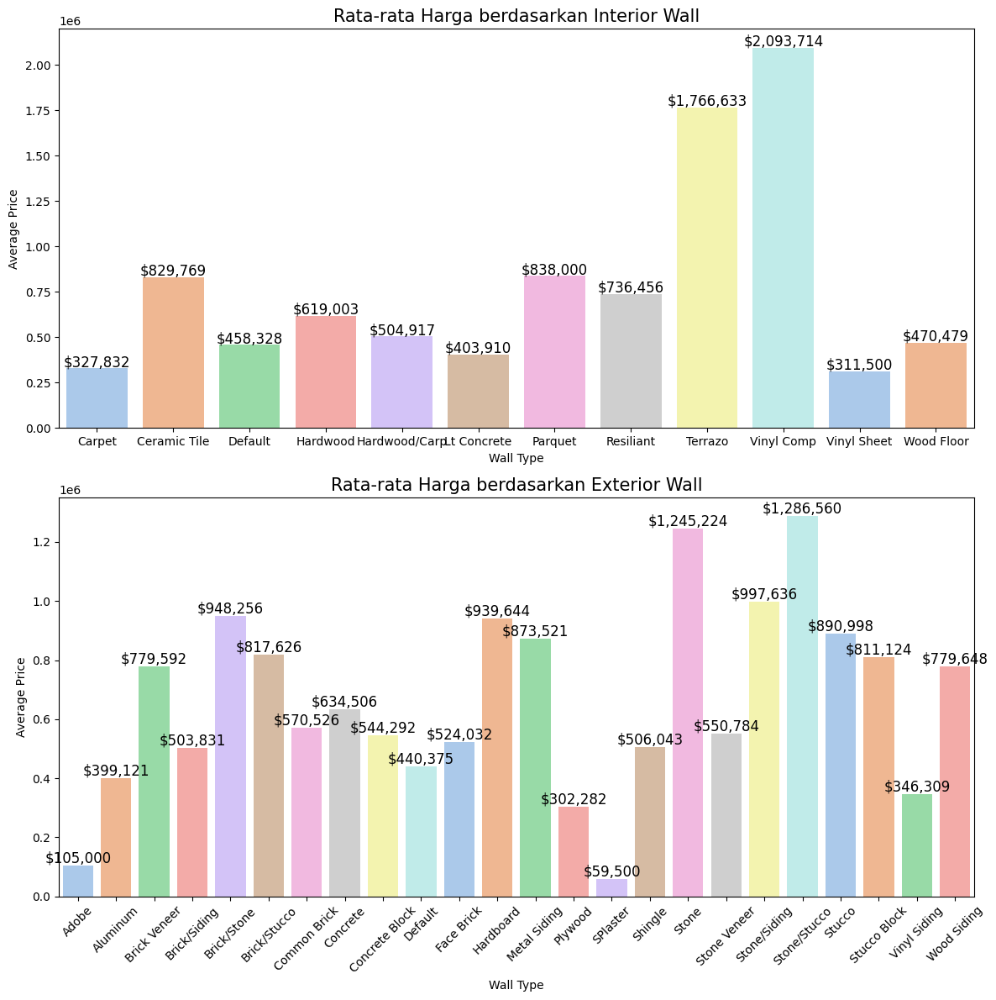

In [ ]:
price_int = df_res.groupby('INTWALL')['PRICE'].mean().reset_index()
price_int.columns = ['WALL_TYPE', 'AVERAGE_PRICE']
price_int['WALL'] = 'Interior'

# Calculate average prices based on exterior wall types
price_ext = df_res.groupby('EXTWALL')['PRICE'].mean().reset_index()
price_ext.columns = ['WALL_TYPE', 'AVERAGE_PRICE']
price_ext['WALL'] = 'Exterior'

# Create the figure and axes
fig, axes = plt.subplots(2, 1, figsize=(12, 12))

# Stacked bar plot for interior wall prices
sns.barplot(data=price_int, x='WALL_TYPE', y='AVERAGE_PRICE', ax=axes[0], palette='pastel')
axes[0].set_title('Rata-rata Harga berdasarkan Interior Wall', size=15)
axes[0].set_ylabel('Average Price')
axes[0].set_xlabel('Wall Type')
plt.xticks(rotation=45)  # Rotate x-axis labels for the first chart

# Adding value labels for interior wall prices
for index, row in price_int.iterrows():
    axes[0].text(index, row['AVERAGE_PRICE'] + 10000, f'${row["AVERAGE_PRICE"]:,.0f}', color='black', ha='center', size=12)

# Stacked bar plot for exterior wall prices
sns.barplot(data=price_ext, x='WALL_TYPE', y='AVERAGE_PRICE', ax=axes[1], palette='pastel')
axes[1].set_title('Rata-rata Harga berdasarkan Exterior Wall', size=15)
axes[1].set_ylabel('Average Price')
axes[1].set_xlabel('Wall Type')
plt.xticks(rotation=45)  # Rotate x-axis labels for the second chart

# Adding value labels for exterior wall prices
for index, row in price_ext.iterrows():
    axes[1].text(index, row['AVERAGE_PRICE'] + 10000, f'${row["AVERAGE_PRICE"]:,.0f}', color='black', ha='center', size=12)

plt.tight_layout()
plt.show()

<ipython-input-81-0f3c30361ae9>:15: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-81-0f3c30361ae9>:27: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




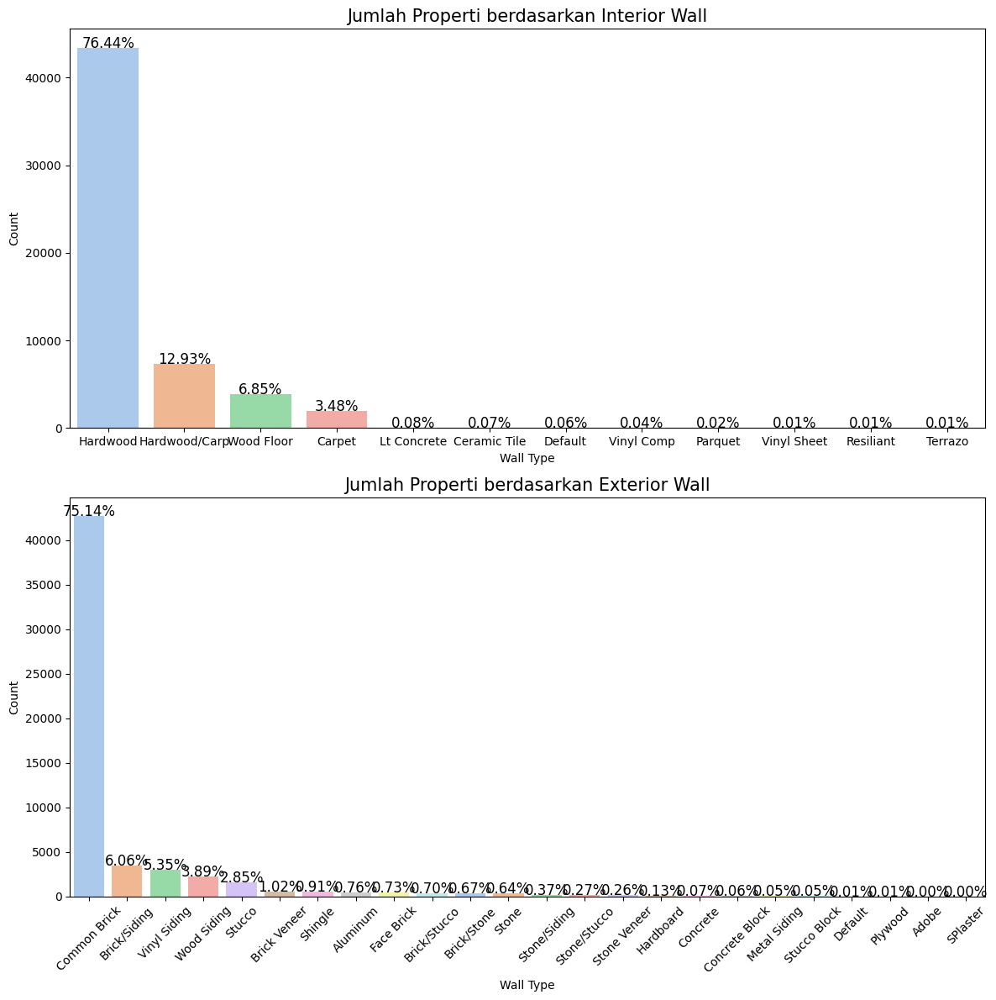

In [ ]:


# Count properties by interior and exterior wall types
count_int = df_res['INTWALL'].value_counts().reset_index()
count_ext = df_res['EXTWALL'].value_counts().reset_index()
count_int.columns = ['WALL_TYPE', 'COUNT']
count_ext.columns = ['WALL_TYPE', 'COUNT']

# Add a column to distinguish between interior and exterior wall counts
count_int['WALL'] = 'Interior'
count_ext['WALL'] = 'Exterior'

# Create the figure and axes
fig, axes = plt.subplots(2, 1, figsize=(12, 12))

# Stacked bar plot for interior walls
sns.barplot(data=count_int, x='WALL_TYPE', y='COUNT', ax=axes[0], palette='pastel')
axes[0].set_title('Jumlah Properti berdasarkan Interior Wall', size=15)
axes[0].set_ylabel('Count')
axes[0].set_xlabel('Wall Type')
plt.xticks(rotation=45)  # Rotate x-axis labels for the first chart

# Adding percentage labels for interior walls
total_int = len(df_res['INTWALL'])
for index, row in count_int.iterrows():
    axes[0].text(index, row['COUNT'] + 0.5, f'{(row["COUNT"]/total_int)*100:.2f}%', color='black', ha='center', size=12)

# Stacked bar plot for exterior walls
sns.barplot(data=count_ext, x='WALL_TYPE', y='COUNT', ax=axes[1], palette='pastel')
axes[1].set_title('Jumlah Properti berdasarkan Exterior Wall', size=15)
axes[1].set_ylabel('Count')
axes[1].set_xlabel('Wall Type')
plt.xticks(rotation=45)  # Rotate x-axis labels for the second chart

# Adding percentage labels for exterior walls
total_ext = len(df_res['EXTWALL'])
for index, row in count_ext.iterrows():
    axes[1].text(index, row['COUNT'] + 0.5, f'{(row["COUNT"]/total_ext)*100:.2f}%', color='black', ha='center', size=12)

plt.tight_layout()
plt.show()


from the interior wall we can see the highest price are suing vinyl comp and Hardwood as their material. as for external wall they use Stone/Stucco and Common Brick As their Material

<ipython-input-82-75b2ffec723e>:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-82-75b2ffec723e>:23: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




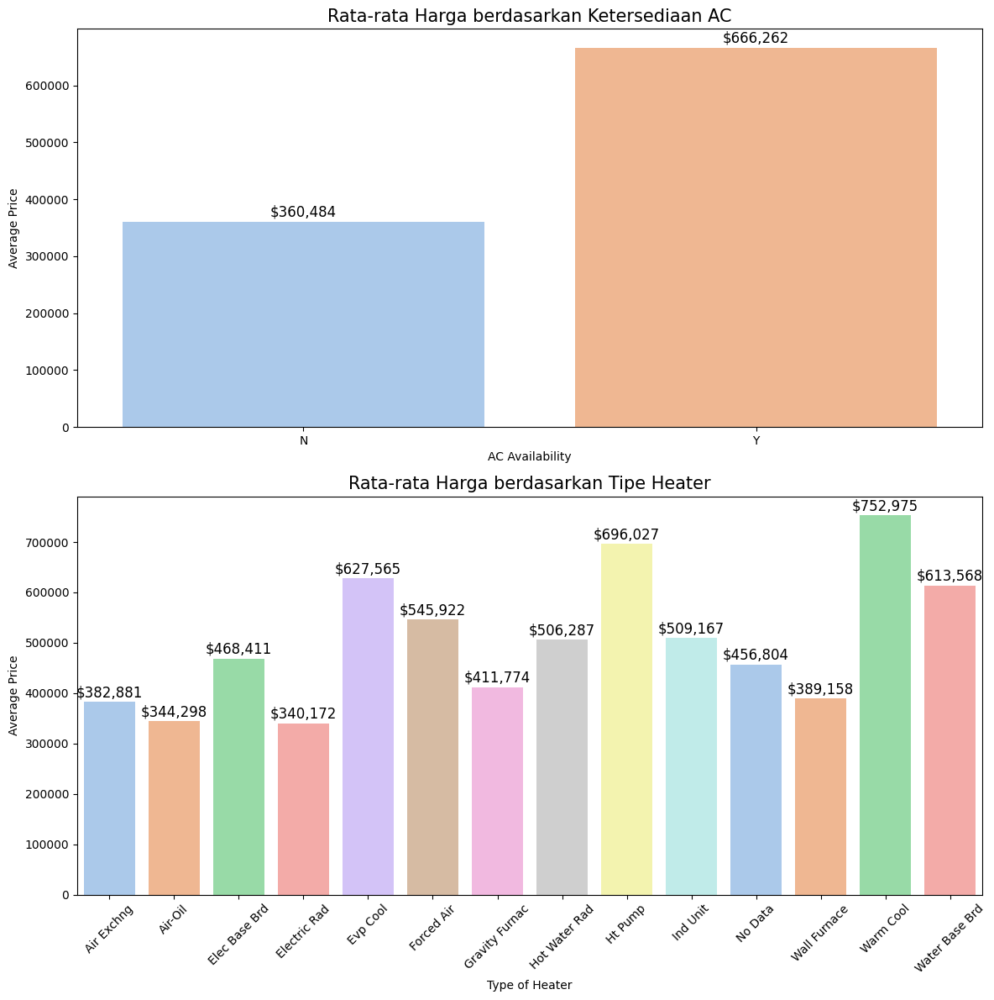

In [ ]:
average_price_ac = df_res.groupby('AC')['PRICE'].mean().reset_index()
average_price_ac.columns = ['AC', 'AVERAGE_PRICE']

# Menghitung rata-rata harga berdasarkan HEAT
average_price_heat = df_res.groupby('HEAT')['PRICE'].mean().reset_index()
average_price_heat.columns = ['HEAT', 'AVERAGE_PRICE']

# Membuat figure dan axes untuk bar chart
fig, axes = plt.subplots(2, 1, figsize=(12, 12))

# Bar chart untuk rata-rata harga berdasarkan AC
sns.barplot(data=average_price_ac, x='AC', y='AVERAGE_PRICE', ax=axes[0], palette='pastel')
axes[0].set_title('Rata-rata Harga berdasarkan Ketersediaan AC', size=15)
axes[0].set_ylabel('Average Price')
axes[0].set_xlabel('AC Availability')
plt.xticks(rotation=45)  # Rotate x-axis labels for AC chart

# Menambahkan label nilai di atas setiap bar
for index, row in average_price_ac.iterrows():
    axes[0].text(index, row['AVERAGE_PRICE'] + 10000, f'${row["AVERAGE_PRICE"]:,.0f}', color='black', ha='center', size=12)

# Bar chart untuk rata-rata harga berdasarkan HEAT
sns.barplot(data=average_price_heat, x='HEAT', y='AVERAGE_PRICE', ax=axes[1], palette='pastel')
axes[1].set_title('Rata-rata Harga berdasarkan Tipe Heater', size=15)
axes[1].set_ylabel('Average Price')
axes[1].set_xlabel('Type of Heater')
plt.xticks(rotation=45)  # Rotate x-axis labels for HEAT chart

# Menambahkan label nilai di atas setiap bar
for index, row in average_price_heat.iterrows():
    axes[1].text(index, row['AVERAGE_PRICE'] + 10000, f'${row["AVERAGE_PRICE"]:,.0f}', color='black', ha='center', size=12)

plt.tight_layout()
plt.show()

We can see that the highest average price are the property that have AC and a Heater that have a Warm Cool

In [ ]:
# Menghapus kolom SOURCE
df_res.drop('SOURCE', axis = 1, inplace = True)

In [ ]:
# Mengubah  ZIPCODE menjadi object
for i in ['USECODE','ZIPCODE']:
    df_res[i] = df_res[i].astype('object')
    df_res[i].info()

<class 'pandas.core.series.Series'>
Index: 56778 entries, 0 to 57288
Series name: USECODE
Non-Null Count  Dtype 
--------------  ----- 
56778 non-null  object
dtypes: object(1)
memory usage: 887.2+ KB
<class 'pandas.core.series.Series'>
Index: 56778 entries, 0 to 57288
Series name: ZIPCODE
Non-Null Count  Dtype 
--------------  ----- 
56778 non-null  object
dtypes: object(1)
memory usage: 887.2+ KB


In [ ]:
# Mengubah tipe data menjadi integer
for i in ['AYB', 'BATHRM', 'ROOMS', 'BEDRM', 'KITCHENS']:
    df_res[i] = df_res[i].astype('int64')

In [ ]:
# Melakukan drop default menjadi nan
df_res['STRUCT'] = df_res['STRUCT'].replace('Default', np.nan)
df_res['STYLE'] = df_res['STYLE'].replace('Default', np.nan)

In [ ]:
# Membuat binning pada kolom YR_RMDL
def BinningTahun (Tahun):
    if Tahun <= 1910:
        return "<=1910"
    elif (Tahun > 1910) & (Tahun <= 1940):
        return "1911-1940"
    elif (Tahun > 1940) & (Tahun <= 1970):
        return "1941-1970"
    elif (Tahun > 1970) & (Tahun <= 2000):
        return "1971-2000"
    elif Tahun > 2000:
        return ">2000"
    else:
        return "No Remodeling"

df_res["YR_RMDL"] = df_res["YR_RMDL"].apply(lambda Tahun: BinningTahun(Tahun))
df_res["YR_RMDL"].head()

,YR_RMDL
0,1971-2000
1,>2000
2,>2000
3,1911-1940
4,>2000


In [ ]:
# Melihat kolom HEAT dengan value No Data
df_res[df_res['HEAT']=='No Data']

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,FULLADDRESS,ZIPCODE,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
1363,3,1,No Data,Y,2.0,9,4,1906,<=1910,1969,2.00,271000.0,Q,1712.0,2 Story,Row Inside,Good Quality,Good,Common Brick,Metal- Sms,Hardwood,2,1,24,1307,2018-07-22 18:01:43,2033 13TH STREET NW,20009.0,38.917931,-77.029370,Old City 2,Ward 1,273,NW,2001,Aug
1669,0,0,No Data,N,1.0,0,0,1892,1971-2000,1954,3.00,2000000.0,Q,3936.0,3 Story,Row Inside,Very Good,Fair,Common Brick,Metal- Sms,Hardwood,1,2,11,2150,2018-07-22 18:01:43,1711 S STREET NW,20009.0,38.914319,-77.039816,Old City 2,Ward 2,152,NW,2014,Jan
4172,0,0,No Data,N,1.0,6,3,1925,1911-1940,1943,2.00,347000.0,Q,1088.0,2 Story,Row Inside,Average,Poor,Common Brick,Built Up,Hardwood,0,0,11,1038,2018-07-22 18:01:43,1119 ABBEY PLACE NE,20002.0,38.904266,-77.001101,Old City 1,Ward 6,773,NE,2005,May
4345,1,0,No Data,N,1.0,6,3,1909,<=1910,1943,2.00,615000.0,U,1152.0,2 Story,Row Inside,Average,Average,Common Brick,Typical,Default,0,0,11,940,2018-07-22 18:01:43,831 3RD STREET NE,20002.0,38.901028,-77.001824,Old City 1,Ward 6,776,NE,2015,Oct
4906,2,0,No Data,N,2.0,6,2,1910,<=1910,1943,2.00,150000.0,U,1520.0,2 Story,Row Inside,Average,Poor,Brick/Siding,Built Up,Vinyl Sheet,2,0,23,971,2018-07-22 18:01:43,633 FLORIDA AVENUE NE,20002.0,38.905235,-76.996462,Old City 1,Ward 6,855,NE,2002,Dec
5359,0,0,No Data,N,1.0,0,0,1911,1911-1940,1947,2.00,61538.0,U,1818.0,2 Story,Row Inside,Above Average,Poor,Common Brick,Built Up,Default,0,0,11,1914,2018-07-22 18:01:43,809 10TH STREET NE,20002.0,38.900639,-76.992390,Old City 1,Ward 6,958,NE,1999,Mar
5896,0,0,No Data,N,2.0,0,0,1910,<=1910,1943,2.00,568000.0,U,1360.0,2 Story,Row Inside,Average,Fair,Common Brick,Built Up,Wood Floor,0,0,24,978,2018-07-22 18:01:43,612 M STREET NE,20002.0,38.905804,-76.997845,Old City 1,Ward 6,855,NE,2016,Sep
7343,1,1,No Data,N,1.0,6,2,1910,>2000,1964,2.00,588700.0,Q,672.0,2 Story,Row Inside,Average,Good,Stucco,Neopren,Hardwood/Carp,1,0,11,660,2018-07-22 18:01:43,246 10TH STREET NE,20002.0,38.893344,-76.992839,Old City 1,Ward 6,939,NE,2015,Jun
25635,2,1,No Data,Y,1.0,12,4,1938,1911-1940,1963,2.50,783000.0,Q,2166.0,2.5 Story Fin,Single,Very Good,Good,Common Brick,Slate,Hardwood,1,1,12,4888,2018-07-22 18:01:43,1411 LOCUST ROAD NW,20012.0,38.986158,-77.033936,Shepherd Heights,Ward 4,2770,NW,2016,Nov
30829,0,0,No Data,N,3.0,0,0,1908,<=1910,1947,3.00,540500.0,U,2396.0,3 Story,Row Inside,Above Average,Average,Brick/Siding,Built Up,Wood Floor,0,0,24,2852,2018-07-22 18:01:43,36 CHANNING STREET NW,20001.0,38.922179,-77.010484,Ledroit Park,Ward 5,3127,NW,2016,Aug


In [ ]:
# Merubah value No Data menjadi NaN
df_res['HEAT'] = df_res['HEAT'].replace('No Data', np.nan)

In [ ]:
# Merubah value Default menjadi NaN
df_res['EXTWALL'] = df_res['EXTWALL'].replace('Default', np.nan)
df_res['INTWALL'] = df_res['INTWALL'].replace('Default', np.nan)

# Modeling

We extract the year from the column SALEDATE to use only the data from 2014 to 2018. We use this timeframe to get the latest housing prices (5 years) because if we are using old data, it will not represent the real world cases.

In [ ]:
df_res.sort_values('PRICE').head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,FULLADDRESS,ZIPCODE,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
48423,2,1,Warm Cool,Y,1.0,7,3,1987,1971-2000,1991,2.0,50085.0,U,1440.0,2 Story,Row Inside,Average,Good,Common Brick,Comp Shingle,Hardwood,1,0,11,2754,2018-07-22 18:01:43,307 61ST STREET NE,20019.0,38.893440,-76.913424,Deanwood,Ward 7,5267,NE,1996,Mar
55493,1,1,Warm Cool,Y,1.0,7,3,1978,1971-2000,1984,3.0,50150.0,U,1836.0,3 Story,Row Inside,Above Average,Average,Brick/Siding,Shake,Wood Floor,1,0,11,1563,2018-07-22 18:01:43,2704 2ND STREET SE,20032.0,38.849779,-77.005223,Congress Heights,Ward 8,5998,SE,1997,Apr
46469,2,0,Hot Water Rad,Y,1.0,6,3,1936,>2000,1964,2.0,50180.0,U,1448.0,2 Story,Single,Average,Good,Shingle,Comp Shingle,Hardwood,1,0,12,3600,2018-07-22 18:01:43,4235 HAYES STREET NE,20019.0,38.899539,-76.941597,Deanwood,Ward 7,5093,NE,2001,Apr
46215,1,0,Warm Cool,Y,1.0,5,2,1945,1941-1970,1945,2.0,50273.0,U,800.0,2 Story,Semi-Detached,Average,Average,Common Brick,Built Up,Hardwood,1,0,13,1926,2018-07-22 18:01:43,1437 ANACOSTIA AVENUE NE,20019.0,38.909409,-76.941705,Lily Ponds,Ward 7,5102,NE,1997,Jan
37750,1,1,Warm Cool,Y,1.0,5,2,1951,1941-1970,1951,2.0,50300.0,U,864.0,2 Story,Semi-Detached,Average,Good,Common Brick,Comp Shingle,Hardwood,1,0,13,1577,2018-07-22 18:01:43,5702 3RD STREET NE,20011.0,38.959508,-77.003033,Riggs Park,Ward 4,3711,NE,1995,Feb


In [ ]:
# Visualisasi Sebaran Harga Berdasarkan Lokasi dengan Scatter Mapbox
fig = px.scatter_mapbox(
    df_res[df_res['PRICE'] < 2000000],
    lat='LATITUDE',
    lon='LONGITUDE',
    color='PRICE',
    hover_name='ASSESSMENT_NBHD',
    hover_data=['PRICE', 'WARD'],
    color_continuous_scale=px.colors.sequential.Plasma,  # Ubah skema warna menjadi continuous scale
    zoom=10,  # Sesuaikan level zoom
    height=550,  # Ubah tinggi visualisasi
    width=750,   # Ubah lebar visualisasi
    opacity=0.6,  # Tambah opacity
    title='Peta Sebaran Harga Rumah di DC'  # Ubah judul visualisasi
)

# Modifikasi tampilan penanda dan layout peta
fig.update_traces(marker=dict(size=3))  # Ubah ukuran marker
fig.update_layout(
    mapbox_style='open-street-map',  # Ubah style peta
    margin=dict(l=20, r=20, t=50, b=20)  # Sesuaikan margin layout
)

# Tampilkan hasil visualisasi
fig.show()

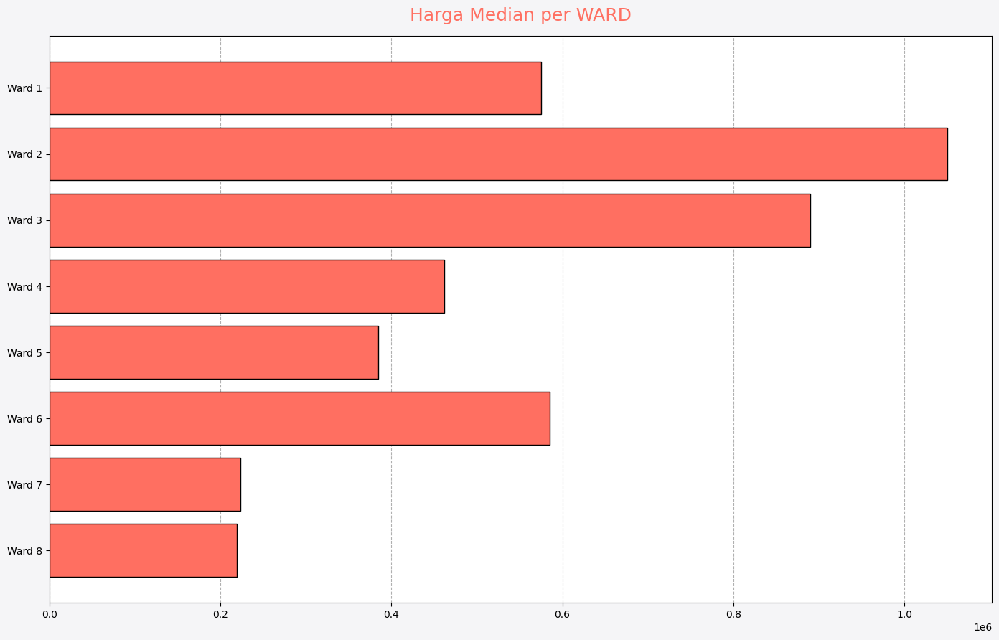

In [ ]:
# Menghitung median harga dan jumlah properti per WARD
median_price_ward = df_res.groupby('WARD')['PRICE'].median().reset_index()
property_count_ward = df_res.groupby('WARD')['PRICE'].size().reset_index(name='TOTAL_PROPERTIES')

# Menggabungkan kedua DataFrame
ward_summary = pd.merge(median_price_ward, property_count_ward, on='WARD')
ward_summary.set_index('WARD', inplace=True)

# Pengaturan warna dan tampilan
font_params = {'fontname':'Arial'}
bg_color = '#f5f5f7'
price_color = '#ff6f61'
count_color = '#5bc0de'
ward_labels = ward_summary.index
median_prices = ward_summary['PRICE']
property_counts = ward_summary['TOTAL_PROPERTIES']

# Judul baru untuk grafik
price_title = 'Harga Median per WARD'

# Membuat plot dengan dua kolom
fig, ax = plt.subplots(figsize=(14,9), facecolor=bg_color, ncols=1, sharey=True)

# Pengaturan layout
fig.subplots_adjust(left=0.15, right=0.9, top=0.9, bottom=0.1)

# Grafik harga median
# Since ax is a single Axes object when ncols=1, use it directly
ax.barh(ward_labels, median_prices, color=price_color, edgecolor='black', zorder=3)
ax.set_title(price_title, fontsize=18, color=price_color, pad=15, **font_params)
ax.grid(True, which='major', axis='x', linestyle='--', zorder=0)


# Pengaturan sumbu y
ax.set(yticks=ward_summary.index, yticklabels=ward_summary.index)
ax.invert_yaxis()
# ax[1] is not needed as there is only one Axes object
#ax[1].invert_yaxis()

# Pengaturan batas margin dan layout
plt.tight_layout(pad=1)
plt.show()

In [ ]:
df_res.sort_values('YR_RMDL').head()


,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,FULLADDRESS,ZIPCODE,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH
42393,1,0,Hot Water Rad,N,1.0,7,4,1925,1911-1940,1957,1.5,525000.0,U,1140.0,1.5 Story Fin,Single,Average,Average,Shingle,Comp Shingle,Hardwood,1,0,12,7100,2018-07-22 18:01:43,2225 NEWTON STREET NE,20018.0,38.933907,-76.973231,Woodridge,Ward 5,4244,NE,2018,Feb
10097,1,1,Hot Water Rad,N,1.0,8,4,1930,1911-1940,1957,2.0,672500.0,Q,1359.0,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1,0,11,1433,2018-07-22 18:01:43,214 17TH PLACE NE,20002.0,38.892567,-76.980094,Old City 1,Ward 6,1093,NE,2018,Apr
42718,2,1,Warm Cool,N,1.0,6,3,1925,1911-1940,1954,2.0,506000.0,Q,1196.0,2 Story,Semi-Detached,Average,Average,Stucco,Comp Shingle,Hardwood,1,0,13,3608,2018-07-22 18:01:43,2010 JACKSON STREET NE,20018.0,38.930326,-76.975414,Woodridge,Ward 5,4220,NE,2018,Mar
26745,1,0,Hot Water Rad,N,1.0,6,3,1919,1911-1940,1957,2.0,350000.0,Q,1512.0,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1,0,11,1932,2018-07-22 18:01:43,1313 QUINCY STREET NW,20011.0,38.937820,-77.030370,Columbia Heights,Ward 4,2825,NW,2011,Mar
10100,1,1,Hot Water Rad,N,1.0,7,4,1929,1911-1940,1957,2.0,176000.0,Q,1456.0,2 Story,Row Inside,Above Average,Average,Common Brick,Metal- Sms,Hardwood,1,0,11,1440,2018-07-22 18:01:43,1702 CONSTITUTION AVENUE NE,20002.0,38.892211,-76.980480,Old City 1,Ward 6,1093,NE,2001,Nov


In [ ]:
# membuat dataFrame baru
df_analisis = df_res.copy()
df_model = df_res.copy()

In [ ]:
# Menunjukkan statistik deskriptif masing-masing kolom
display(df_model.describe(), df_model.describe(include='object'))

,BATHRM,HF_BATHRM,NUM_UNITS,ROOMS,BEDRM,AYB,EYB,STORIES,PRICE,GBA,KITCHENS,FIREPLACES,LANDAREA,LATITUDE,LONGITUDE,SALEYEAR
count,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000,5.677800e+04,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000,56778.000000
mean,2.205625,0.653475,1.218993,7.449523,3.425323,1934.460671,1969.856001,2.094788,5.844075e+05,1726.557857,1.248565,0.645849,3170.039575,38.916027,-77.010688,2008.974867
std,1.061193,0.607199,0.619203,2.297554,1.115168,30.539019,16.845528,0.411117,5.977108e+05,823.975391,0.632959,0.911505,3137.627768,0.033785,0.043155,6.955923
min,0.000000,0.000000,0.000000,0.000000,0.000000,1754.000000,1915.000000,0.000000,5.008500e+04,252.000000,0.000000,0.000000,255.000000,38.819731,-77.113909,1982.000000
25%,1.000000,0.000000,1.000000,6.000000,3.000000,1913.000000,1958.000000,2.000000,2.464250e+05,1216.000000,1.000000,0.000000,1520.000000,38.893014,-77.035739,2004.000000
50%,2.000000,1.000000,1.000000,7.000000,3.000000,1929.000000,1967.000000,2.000000,4.475000e+05,1504.000000,1.000000,0.000000,2211.000000,38.916189,-77.007079,2010.000000
75%,3.000000,1.000000,1.000000,8.000000,4.000000,1947.000000,1975.000000,2.000000,7.525000e+05,1983.000000,1.000000,1.000000,4000.000000,38.942496,-76.983873,2015.000000
max,12.000000,11.000000,6.000000,31.000000,20.000000,2018.000000,2018.000000,5.000000,2.510000e+07,15902.000000,6.000000,13.000000,187301.000000,38.995435,-76.909758,2018.000000


,HEAT,AC,YR_RMDL,QUALIFIED,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,USECODE,GIS_LAST_MOD_DTTM,FULLADDRESS,ZIPCODE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEMONTH
count,56757,56778,56778,56778,56764,56774,56778,56778,56770,56778,56745,56778,56778,56778,56778.0,56778,56778,56778,56778,56778
unique,13,2,5,2,16,7,12,6,23,16,11,8,1,56766,21.0,55,8,3142,4,12
top,Forced Air,Y,>2000,Q,2 Story,Row Inside,Average,Good,Common Brick,Built Up,Hardwood,11,2018-07-22 18:01:43,2820 O STREET NW,20002.0,Old City 1,Ward 4,4327,NW,Jun
freq,21563,41579,29935,45453,43350,23132,19120,25387,42661,17307,43402,25590,56778,2,7872.0,7339,10271,316,27205,5880


In [ ]:
ordinal_mapping = [
    {'col':'YR_RMDL',
    'mapping':{'No Remodeling' : 0,
    '<=1910' : 1,
    '1911-1940' : 2,
    '1941-1970' : 3,
    '1971-2000' : 4,
    '>2000' : 5,
    }},
    {'col':'GRADE',
    'mapping':{'Low Quality' : 0,
    'Fair Quality' : 1,
    'Average' : 2,
    'Above Average' : 3,
    'Good Quality' : 4,
    'Very Good' : 5,
    'Excellent' : 6,
    'Superior' : 7,
    'Exceptional-A' :8,
    'Exceptional-B' : 9,
    'Exceptional-C' : 10,
    'Exceptional-D' :11,
    }},
    {'col':'CNDTN',
    'mapping':{'Poor' : 0,
    'Fair' : 1,
    'Average' : 2,
    'Good' : 3,
    'Very Good' : 4,
    'Excellent' : 5,
    }}
]

In [ ]:
# Melihat jumlah baris dan kolom data analisa
df_analisis.shape

(56778, 36)

In [ ]:
# Melihat jumlah baris dan kolom data modeling
df_model.info()

<class 'pandas.core.frame.DataFrame'>
Index: 56778 entries, 0 to 57288
Data columns (total 36 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   BATHRM             56778 non-null  int64  
 1   HF_BATHRM          56778 non-null  int64  
 2   HEAT               56757 non-null  object 
 3   AC                 56778 non-null  object 
 4   NUM_UNITS          56778 non-null  float64
 5   ROOMS              56778 non-null  int64  
 6   BEDRM              56778 non-null  int64  
 7   AYB                56778 non-null  int64  
 8   YR_RMDL            56778 non-null  object 
 9   EYB                56778 non-null  int64  
 10  STORIES            56778 non-null  float64
 11  PRICE              56778 non-null  float64
 12  QUALIFIED          56778 non-null  object 
 13  GBA                56778 non-null  float64
 14  STYLE              56764 non-null  object 
 15  STRUCT             56774 non-null  object 
 16  GRADE              56778 no

In [ ]:
# Transformer
PipelineOHE = Pipeline([('simpleimputer', SimpleImputer(strategy='most_frequent')),
                        ('onehot', OneHotEncoder(drop='first'))])

PipelineBinary = Pipeline([('simpleimputer', SimpleImputer(strategy='most_frequent')),
                        ('binary', ce.BinaryEncoder())])

transformer = ColumnTransformer([
    ('onehot', PipelineOHE, ['AC','QUADRANT']),
    ('ordinal', ce.OrdinalEncoder(mapping= ordinal_mapping), ['YR_RMDL','GRADE','CNDTN']),
    ('binary', PipelineBinary, ['ZIPCODE', 'WARD', 'USECODE','HEAT', 'STYLE', 'STRUCT', 'EXTWALL', 'ROOF', 'INTWALL'])
], remainder='passthrough')

In [ ]:
# Melakukan pemisahan feature x dan target y
x = df_model.drop(columns=['PRICE'])
y = df_model['PRICE']

In [ ]:
# Melakukan splitting data train 80% dan data test 20%
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=42)

In [ ]:
print(x_train.columns)

Index(['BATHRM', 'HF_BATHRM', 'HEAT', 'AC', 'NUM_UNITS', 'ROOMS', 'BEDRM',
       'AYB', 'YR_RMDL', 'EYB', 'STORIES', 'QUALIFIED', 'GBA', 'STYLE',
       'STRUCT', 'GRADE', 'CNDTN', 'EXTWALL', 'ROOF', 'INTWALL', 'KITCHENS',
       'FIREPLACES', 'USECODE', 'LANDAREA', 'GIS_LAST_MOD_DTTM', 'FULLADDRESS',
       'ZIPCODE', 'LATITUDE', 'LONGITUDE', 'ASSESSMENT_NBHD', 'WARD', 'SQUARE',
       'QUADRANT', 'SALEYEAR', 'SALEMONTH'],
      dtype='object')


In [ ]:
transformed_data = transformer.fit_transform(x_train)
print(transformed_data.shape)  # Cetak jumlah kolom hasil transformasi


(45422, 67)


In [ ]:
# For each transformer, print out the number of features it outputs
print(len(transformer.transformers_[0][1].get_feature_names_out()))  # OneHotEncoder
print(len(transformer.transformers_[1][1].get_feature_names()))  # OrdinalEncoder
print(len(transformer.transformers_[2][1][1].get_feature_names()))  # BinaryEncoder



4
3
39


/usr/local/lib/python3.10/dist-packages/category_encoders/utils.py:366: FutureWarning:

`get_feature_names` is deprecated in all of sklearn. Use `get_feature_names_out` instead.



In [ ]:
import sklearn
from sklearn.preprocessing import OrdinalEncoder as SklearnOrdinalEncoder

# Determine whether to use sparse_output based on sklearn version
sparse_param = 'sparse_output' if sklearn.__version__ >= '1.2' else 'sparse'
# Update OneHotEncoder to disable sparse output using the correct parameter
PipelineOHE = Pipeline([('simpleimputer', SimpleImputer(strategy='most_frequent')),
                        ('onehot', OneHotEncoder(drop='first',  handle_unknown='ignore', **{sparse_param: False}))])

PipelineBinary = Pipeline([('simpleimputer', SimpleImputer(strategy='most_frequent')),
                           ('onehot', OneHotEncoder(drop='first',  handle_unknown='ignore', **{sparse_param: False}))])  # Using OneHotEncoder to simulate BinaryEncoder behavior

# ColumnTransformer setup with Sklearn OrdinalEncoder as a fallback
transformer_fixed = ColumnTransformer([
    ('onehot', PipelineOHE, ['AC', 'QUADRANT']),
    ('ordinal', SklearnOrdinalEncoder(), ['YR_RMDL', 'GRADE', 'CNDTN']),
    ('binary', PipelineBinary, ['ZIPCODE', 'WARD', 'HEAT', 'STYLE', 'STRUCT', 'EXTWALL', 'ROOF', 'INTWALL'])
], remainder='passthrough')

# Apply the transformation again
transformed_data_fixed = transformer_fixed.fit_transform(x_train)

# Get the passthrough columns (those that are not transformed)
passthrough_columns_fixed = x_train.columns.difference(['AC', 'QUADRANT', 'YR_RMDL', 'GRADE', 'CNDTN',
                                                        'ZIPCODE', 'WARD', 'HEAT', 'STYLE', 'STRUCT',
                                                        'EXTWALL', 'ROOF', 'INTWALL'])

# Recompute feature names
feature_names_fixed = (
    list(transformer_fixed.transformers_[0][1].get_feature_names_out(['AC', 'QUADRANT'])) +  # OneHotEncoder features
    ['YR_RMDL', 'GRADE', 'CNDTN'] +  # OrdinalEncoder features
    list(transformer_fixed.transformers_[2][1].get_feature_names_out(['ZIPCODE', 'WARD', 'HEAT', 'STYLE', 'STRUCT', 'EXTWALL', 'ROOF', 'INTWALL'])) +  # BinaryEncoder substitute
    list(passthrough_columns_fixed)  # Passthrough columns
)

# Verify if the feature names match the transformed data shape
if len(feature_names_fixed) != transformed_data_fixed.shape[1]:
    error_message_fixed = f"Feature names ({len(feature_names_fixed)}) do not match the transformed data shape ({transformed_data_fixed.shape[1]})!"
    error_message_fixed
else:
    # Proceed with DataFrame construction
    testing_fixed = pd.DataFrame(transformed_data_fixed, columns=feature_names_fixed)
    testing_fixed.head()

In [ ]:
print(testing_fixed.head())

  AC_Y QUADRANT_NW QUADRANT_SE QUADRANT_SW YR_RMDL GRADE CNDTN  \
0  1.0         0.0         0.0         0.0     4.0   0.0   5.0   
1  1.0         0.0         1.0         0.0     4.0   1.0   3.0   
2  1.0         0.0         0.0         0.0     4.0   0.0   3.0   
3  0.0         1.0         0.0         0.0     4.0   1.0   0.0   
4  0.0         1.0         0.0         0.0     2.0   0.0   0.0   

  ZIPCODE_20002.0 ZIPCODE_20003.0 ZIPCODE_20005.0 ZIPCODE_20007.0  \
0             1.0             0.0             0.0             0.0   
1             0.0             0.0             0.0             0.0   
2             1.0             0.0             0.0             0.0   
3             0.0             0.0             0.0             0.0   
4             0.0             0.0             0.0             0.0   

  ZIPCODE_20008.0 ZIPCODE_20009.0 ZIPCODE_20010.0 ZIPCODE_20011.0  \
0             0.0             0.0             0.0             0.0   
1             0.0             0.0             0.0 

In [ ]:
# # Melihat data setelah encoding
# testing = pd.DataFrame(transformer.fit_transform(x_train),columns=list(transformer.transformers_[0][1].get_feature_names_out())+ transformer.transformers_[1][1].get_feature_names()+transformer.transformers_[2][1][1].get_feature_names()+['BATHRM', 'HF_BATHRM',  'ROOMS', 'BEDRM', 'AYB', 'EYB', 'GBA',  'KITCHENS', 'FIREPLACES', 'LANDAREA', 'LATITUDE', 'LONGITUDE', 'SALEYEAR', 'SALEMONTH'])
# testing

In [ ]:
# Convert all categorical columns to dummy/one-hot encoded values
# testing_fixed_numeric = pd.get_dummies(testing_fixed, drop_first=True)
print(testing_fixed.dtypes)

AC_Y           object
QUADRANT_NW    object
QUADRANT_SE    object
QUADRANT_SW    object
YR_RMDL        object
                ...  
SALEMONTH      object
SALEYEAR       object
SQUARE         object
STORIES        object
USECODE        object
Length: 136, dtype: object


# Modeling
After analyzing the data, the next step will be modeling using training and test data. The models that will be used for price prediction include:

1. LinearRegression
2. KNeighborsRegressor
3. DecisionTreeRegressor
4. RandomForestRegressor
5. GradientBoostingRegressor
6. XGBRegressor
For clustering, the models to be used are:

K-means
Agglomerative
The evaluation metrics for price prediction will be MAE, MAPE, and R-Squared, while for clustering, the Silhouette score will be used, as explained in the Business Problem sectio

In [ ]:
#import
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost.sklearn import XGBRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.utils import resample

import pickle

from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold
# Model
lr = LinearRegression()
knn = KNeighborsRegressor()
dt = DecisionTreeRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
gb = GradientBoostingRegressor(random_state=42)
xgb = XGBRegressor(random_state=42)

# Pemodelan dilakukan dalam skala logaritmik, namun kemudian di-inverse kembali untuk interpretasi
log_lr = TransformedTargetRegressor(lr, func=np.log, inverse_func=np.exp)
log_knn = TransformedTargetRegressor(knn, func=np.log, inverse_func=np.exp)
log_dt = TransformedTargetRegressor(dt, func=np.log, inverse_func=np.exp)
log_rf = TransformedTargetRegressor(rf, func=np.log, inverse_func=np.exp)
log_gb = TransformedTargetRegressor(gb, func=np.log, inverse_func=np.exp)
log_xgb = TransformedTargetRegressor(xgb, func=np.log, inverse_func=np.exp)

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
le = LabelEncoder()

# Convert all object-type columns to strings, ensuring uniform types in each column
for column in x_train.select_dtypes(include='object').columns:
    x_train[column] = x_train[column].astype(str)  # Ensure all are strings
    x_train[column] = le.fit_transform(x_train[column])

# Repeat the same for x_test if necessary
for column in x_test.select_dtypes(include='object').columns:
    x_test[column] = x_test[column].astype(str)  # Ensure all are strings
    x_test[column] = le.fit_transform(x_test[column])


In [ ]:
# List of algorithms
models = [log_lr, log_knn, log_dt, log_rf, log_gb, log_xgb]

# Prepare score storage
score_mae = []
score_mape = []
score_r2 = []

# Searching for the best model based on MAE
for model in models:

    # Cross-validation setup
    crossval = KFold(n_splits=3, shuffle=True, random_state=42)

    # Define the model pipeline
    estimator = Pipeline([
        ('preprocessing', transformer_fixed),  # Ensure proper preprocessing here
        ('model', model)
    ])

    # Evaluate using cross-validation for MAE
    model_cv_mae = cross_val_score(
        estimator,
        x_train,
        y_train,
        cv=crossval,
        scoring='neg_mean_absolute_error',
        error_score='raise'
    )
    print(f"MAE for {model}: {model_cv_mae}")
    score_mae.append(model_cv_mae.mean())

    # Evaluate using cross-validation for MAPE
    model_cv_mape = cross_val_score(
        estimator,
        x_train,
        y_train,
        cv=crossval,
        scoring='neg_mean_absolute_percentage_error',
        error_score='raise'
    )
    print(f"MAPE for {model}: {model_cv_mape}")
    score_mape.append(model_cv_mape.mean())

    # Evaluate using cross-validation for R2
    model_cv_r2 = cross_val_score(
        estimator,
        x_train,
        y_train,
        cv=crossval,
        scoring='r2',
        error_score='raise'
    )
    print(f"R2 for {model}: {model_cv_r2}")
    score_r2.append(model_cv_r2.mean())

# Display the results
print("MAE scores:", score_mae)
print("MAPE scores:", score_mape)
print("R2 scores:", score_r2)


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression()): [-129662.90175923 -122981.99670374 -128450.29596799]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAPE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression()): [-0.25273849 -0.24637208 -0.25055935]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



R2 for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=LinearRegression()): [0.03651112 0.72909316 0.69225356]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor()): [-249749.44262219 -247439.79375177 -254580.92503978]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAPE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor()): [-0.62573085 -0.63039835 -0.61649133]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



R2 for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=KNeighborsRegressor()): [0.39513068 0.44592679 0.42785307]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=DecisionTreeRegressor(random_state=42)): [-135720.02714484 -136540.65458028 -138899.36842801]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAPE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=DecisionTreeRegressor(random_state=42)): [-0.26984952 -0.28021239 -0.27575123]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



R2 for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=DecisionTreeRegressor(random_state=42)): [0.55172341 0.52628703 0.60914542]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=RandomForestRegressor(random_state=42)): [-92036.27613512 -89067.21770804 -92120.21730164]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAPE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=RandomForestRegressor(random_state=42)): [-0.18016153 -0.17949833 -0.18093449]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



R2 for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=RandomForestRegressor(random_state=42)): [0.70373381 0.82366843 0.81775048]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=GradientBoostingRegressor(random_state=42)): [ -99902.37729603  -97025.30470108 -100085.75971734]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAPE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=GradientBoostingRegressor(random_state=42)): [-0.1958582  -0.19501215 -0.19663098]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



R2 for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=GradientBoostingRegressor(random_state=42)): [0.67001895 0.80031072 0.78870964]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=XGBRegressor(base_score=None, booster=None,
                                                  callbacks=None,
                                                  colsample_bylevel=None,
                                                  colsample_bynode=None,
                                                  colsample_bytree=None,
                                                  device=None,
                                                  early_stopping_rounds=None,
                                                  enable_categorical=False,
                                                  eval_metric=None,
                                                  feature_types=None,
                                                  gamma=None, grow_policy=None,
                                                  importance_type=None,
                                           

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



MAPE for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=XGBRegressor(base_score=None, booster=None,
                                                  callbacks=None,
                                                  colsample_bylevel=None,
                                                  colsample_bynode=None,
                                                  colsample_bytree=None,
                                                  device=None,
                                                  early_stopping_rounds=None,
                                                  enable_categorical=False,
                                                  eval_metric=None,
                                                  feature_types=None,
                                                  gamma=None, grow_policy=None,
                                                  importance_type=None,
                                          

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3, 7] during transform. These unknown categories will be encoded as all zeros



R2 for TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=XGBRegressor(base_score=None, booster=None,
                                                  callbacks=None,
                                                  colsample_bylevel=None,
                                                  colsample_bynode=None,
                                                  colsample_bytree=None,
                                                  device=None,
                                                  early_stopping_rounds=None,
                                                  enable_categorical=False,
                                                  eval_metric=None,
                                                  feature_types=None,
                                                  gamma=None, grow_policy=None,
                                                  importance_type=None,
                                            

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



In [ ]:
# Melihat evaluasi data train
score_mae2 = [abs(ele) for ele in score_mae]
score_mape2 = [abs(ele) for ele in score_mape]
pd.DataFrame({
    'Model': ['LinearRegression', 'KNN', 'Decision Tree', 'Random Forest', 'Gradient Boosting', 'XGBoost'],
    'MAE': score_mae2,
    'MAPE':score_mape2,
    'R-squared': score_r2
})

,Model,MAE,MAPE,R-squared
0,LinearRegression,127031.731477,0.249890,0.485953
1,KNN,250590.053805,0.624207,0.422970
2,Decision Tree,137053.350051,0.275271,0.562385
3,Random Forest,91074.570382,0.180198,0.781718
4,Gradient Boosting,99004.480571,0.195834,0.753013
5,XGBoost,87536.415671,0.176029,0.809390


#### Predict Test Set using Benchmark Model

In [ ]:
# Melihat prediksi menggunakan test set model XGBoost dan Random Forest
rf = RandomForestRegressor(random_state=42)
xgb = XGBRegressor(random_state=42)

modeltest = [xgb, rf]
score_mae = []
score_mape = []
score_r2 = []

for i in modeltest:
        estimator = Pipeline([('preprocessing', transformer),('model', i)])

        estimator.fit(x_train, y_train)
        y_pred = estimator.predict(x_test)
        score_mae.append(mean_absolute_error(y_test, y_pred))
        score_mape.append(mean_absolute_percentage_error(y_test, y_pred))
        score_r2.append(r2_score(y_test, y_pred))

score_before_tuning = pd.DataFrame({'MAE': score_mae, 'MAPE': score_mape, 'R-squared': score_r2}, index=['XGBoost','Random Forest'])
score_before_tuning

,MAE,MAPE,R-squared
XGBoost,103381.261499,0.222942,0.796923
Random Forest,100991.339004,0.235859,0.810246


# Hyper Parameter Tuning

1. Reduce Hyperparameter Search Space:
You can either limit the range of values for each hyperparameter or use fewer hyperparameter combinations.
You could try a smaller grid first to get an idea of reasonable ranges for the hyperparameters and then expand the search if needed.
2. Use RandomizedSearchCV Instead of GridSearchCV:
RandomizedSearchCV is more efficient because it explores a random subset of the hyperparameter space instead of testing every possible combination.
You can control how many random combinations are tested via the n_iter parameter, thus reducing the computation time.
3. Parallel Processing:
Both RandomForestRegressor and XGBRegressor support parallelism with the n_jobs=-1 option, allowing the computation to run on all available CPU cores.
Ensure that n_jobs=-1 is used in both GridSearchCV and the models where applicable.
4. Reduce Cross-Validation Folds:
By reducing the number of cross-validation folds (e.g., from 5 to 3), the overall computational cost is reduced while still providing robust evaluation

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

# Cross-validation setup (reduced to 3 folds for faster execution)
crossval = KFold(n_splits=3, shuffle=True, random_state=42)

# RandomForest Hyperparameter Tuning with RandomizedSearchCV
rf = RandomForestRegressor(random_state=0, n_jobs=-1)  # Use all cores for RandomForest
Pipe_rf = Pipeline([('preprocess', transformer_fixed), ('model_rf', rf)])

# Reduced hyperparameter space for faster searching
hyperparam_rf = {
    'model_rf__n_estimators': [100, 200],  # Reduced search space
    'model_rf__max_depth': [10, 15],
    'model_rf__min_samples_split': [2, 3],
    'model_rf__min_samples_leaf': [1, 2]
}

# Use RandomizedSearchCV to reduce combinations
rf_random_search = RandomizedSearchCV(
    estimator=Pipe_rf,
    param_distributions=hyperparam_rf,
    cv=crossval,
    scoring='neg_mean_absolute_error',
    n_iter=10,  # Limit to 10 random combinations
    n_jobs=-1,
    random_state=0
)

# Fit the RandomForest model
rf_random_search.fit(x_train, y_train)

# XGBoost Hyperparameter Tuning with RandomizedSearchCV
xgb = XGBRegressor(random_state=42, verbosity=0, n_jobs=-1)  # Use all cores for XGBoost
Pipe_xgb = Pipeline([('preprocess', transformer_fixed), ('model_xgb', xgb)])

# Reduced hyperparameter space for faster searching
hyperparam_xgb = {
    'model_xgb__n_estimators': [100, 200],  # Reduced search space
    'model_xgb__max_depth': [3, 5],
    'model_xgb__learning_rate': [0.1, 0.05],
}

# Use RandomizedSearchCV to reduce combinations
xgb_random_search = RandomizedSearchCV(
    estimator=Pipe_xgb,
    param_distributions=hyperparam_xgb,
    cv=crossval,
    scoring='neg_mean_absolute_error',
    n_iter=10,  # Limit to 10 random combinations
    n_jobs=-1,
    random_state=0
)

# Fit the XGBoost model
xgb_random_search.fit(x_train, y_train)

# Print the best parameters and scores
print(f"Best RandomForest Parameters: {rf_random_search.best_params_}")
print(f"Best RandomForest MAE: {rf_random_search.best_score_}")

print(f"Best XGBoost Parameters: {xgb_random_search.best_params_}")
print(f"Best XGBoost MAE: {xgb_random_search.best_score_}")


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:320: UserWarning:

The total space of parameters 8 is smaller than n_iter=10. Running 8 iterations. For exhaustive searches, use GridSearchCV.

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



Best RandomForest Parameters: {'model_rf__n_estimators': 200, 'model_rf__min_samples_split': 2, 'model_rf__min_samples_leaf': 2, 'model_rf__max_depth': 15}
Best RandomForest MAE: -94652.86786596384
Best XGBoost Parameters: {'model_xgb__n_estimators': 200, 'model_xgb__max_depth': 5, 'model_xgb__learning_rate': 0.1}
Best XGBoost MAE: -91366.35014600777


In [ ]:
# Nilai evaluasi prediksi dengan hyperparameter tuning
XGBtuned = TransformedTargetRegressor(xgb_random_search.best_estimator_, func=np.log, inverse_func=np.exp)
RF_tuned = TransformedTargetRegressor(rf_random_search.best_estimator_, func=np.log, inverse_func=np.exp)
modeltuned = [XGBtuned, RF_tuned]
mae_tuned = []
mape_tuned = []
r2_tuned = []

for model in modeltuned:
    model.fit(x_train, y_train)
    y_pred_tuned = model.predict(x_test)
    mae_tuned.append(mean_absolute_error(y_test, y_pred_tuned))
    mape_tuned.append(mean_absolute_percentage_error(y_test, y_pred_tuned))
    r2_tuned.append(r2_score(y_test, y_pred_tuned))

score_after_tuning = pd.DataFrame({'MAE': mae_tuned, 'MAPE': mape_tuned, 'R-squared': r2_tuned}, index=['XGBoost after Tuning', 'Random Forest after Tuning'])
display(score_before_tuning, score_after_tuning)

,MAE,MAPE,R-squared
XGBoost,103381.261499,0.222942,0.796923
Random Forest,100991.339004,0.235859,0.810246


,MAE,MAPE,R-squared
XGBoost after Tuning,91916.745548,0.187665,0.830458
Random Forest after Tuning,100505.468077,0.216951,0.810467


#### Model XGBoost - Feature Selection

##### Feature Selection - Select K-Best(Univariate)

In [ ]:
# Feature Selection
xgb = XGBRegressor(random_state=0)
XGBFS= TransformedTargetRegressor(xgb, func=np.log, inverse_func=np.exp)
modelFS = [XGBFS]

score_mae = []
score_mape = []
score_r2 = []

fs = SelectKBest(score_func=f_regression, k=20)

# Melihat nilai evaluasi menggunakan FS
for model in modelFS:

    crossval = KFold(n_splits=5, shuffle=True, random_state=8)

    estimator = Pipeline([
        ('preprocessing', transformer_fixed),
        ('FeatureSelection', fs),
        ('model', model)
    ])

    # MAE
    model_cv_mae = cross_val_score(
        estimator,
        x_train,
        y_train,
        cv=crossval,
        scoring='neg_mean_absolute_error',
        error_score='raise'
        )

    print(model_cv_mae, model)

    score_mae.append(model_cv_mae.mean())

    # MAPE
    model_cv_mape = cross_val_score(
        estimator,
        x_train,
        y_train,
        cv=crossval,
        scoring='neg_mean_absolute_percentage_error',
        error_score='raise'
        )

    print(model_cv_mape, model)

    score_mape.append(model_cv_mape.mean())

    # R2
    model_cv_r2 = cross_val_score(
        estimator,
        x_train,
        y_train,
        cv=crossval,
        scoring='r2',
        error_score='raise'
        )

    print(model_cv_r2, model)

    score_r2.append(model_cv_r2.mean())

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



[-100568.31530037  -95012.14104809  -96802.5069959   -90909.03173936
  -94398.36437521] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=XGBRegressor(base_score=None, booster=None,
                                                  callbacks=None,
                                                  colsample_bylevel=None,
                                                  colsample_bynode=None,
                                                  colsample_bytree=None,
                                                  device=None,
                                                  early_stopping_rounds=None,
                                                  enable_categorical=False,
                                                  eval_metric=None,
                                                  feature_types=None,
                                                  gamma=None, grow_policy=None,
                                   

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



[-0.20317748 -0.21090691 -0.19650737 -0.20160025 -0.19965638] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=XGBRegressor(base_score=None, booster=None,
                                                  callbacks=None,
                                                  colsample_bylevel=None,
                                                  colsample_bynode=None,
                                                  colsample_bytree=None,
                                                  device=None,
                                                  early_stopping_rounds=None,
                                                  enable_categorical=False,
                                                  eval_metric=None,
                                                  feature_types=None,
                                                  gamma=None, grow_policy=None,
                                                  importance_

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5] during transform. These unknown categories will be encoded as all zeros

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:242: UserWarning:

Found unknown categories in columns [5, 6] during transform. These unknown categories will be encoded as all zeros



[0.74141912 0.83207564 0.68058099 0.87750157 0.85434578] TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=XGBRegressor(base_score=None, booster=None,
                                                  callbacks=None,
                                                  colsample_bylevel=None,
                                                  colsample_bynode=None,
                                                  colsample_bytree=None,
                                                  device=None,
                                                  early_stopping_rounds=None,
                                                  enable_categorical=False,
                                                  eval_metric=None,
                                                  feature_types=None,
                                                  gamma=None, grow_policy=None,
                                                  importance_type=

In [ ]:
# Melihat evaluasi data train dengan FS
score_mae2 = [abs(ele) for ele in score_mae]
score_mape2 = [abs(ele) for ele in score_mape]
pd.DataFrame({
    'Model': ['XGBoost FS'],
    'MAE': score_mae2,
    'MAPE':score_mape2,
    'R-squared': score_r2
})

,Model,MAE,MAPE,R-squared
0,XGBoost FS,95538.071892,0.20237,0.797185


In [ ]:
# Melihat prediksi menggunakan test set model XGBoost dengan FS
xgb = XGBRegressor(random_state=0)

modeltest = [xgb]
score_mae = []
score_mape = []
score_r2 = []

for i in modeltest:
        estimator = Pipeline([('preprocessing', transformer_fixed), ('FeatureSelection', fs), ('model', i)])

        estimator.fit(x_train, y_train)
        y_pred = estimator.predict(x_test)
        score_mae.append(mean_absolute_error(y_test, y_pred))
        score_mape.append(mean_absolute_percentage_error(y_test, y_pred))
        score_r2.append(r2_score(y_test, y_pred))

scorewithFS = pd.DataFrame({'MAE': score_mae, 'MAPE': score_mape, 'R-squared': score_r2}, index=['XGBoostFS'])


In [ ]:
# Melihat perbandingan sebelum dan sesudah FS
display(scorewithFS,score_before_tuning[0:-1])

,MAE,MAPE,R-squared
XGBoostFS,137489.869382,0.334595,0.74855


,MAE,MAPE,R-squared
XGBoost,103381.261499,0.222942,0.796923


##### Feature Importances - Model Based

In [ ]:
# Model Akhir
best_model = xgb_random_search.best_estimator_
Predict = best_model.fit(x_train, y_train)

In [ ]:
# Check if lengths match
if len(feature_importances) != len(feature_names_fixed):
    min_length = min(len(feature_importances), len(feature_names_fixed))
    print(f"Trimming to match lengths: using {min_length} elements.")
    # Trim both lists to the same length
    feature_importances = feature_importances[:min_length]
    feature_names_fixed = feature_names_fixed[:min_length]

# Continue processing after lengths match
print(f"Number of feature importance values: {len(feature_importances)}")
print(f"Number of feature names: {len(feature_names_fixed)}")


NameError: name 'feature_importances' is not defined

In [ ]:
print(xgb_random_search.best_estimator_)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('onehot',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  ['AC', 'QUADRANT']),
                                                 ('ordinal', OrdinalEncoder(),
                                                  ['YR_RMDL', 'GRADE',
                                                   

Trimming to match lengths: using 136 elements.
Number of feature importance values: 136
Number of feature names: 136


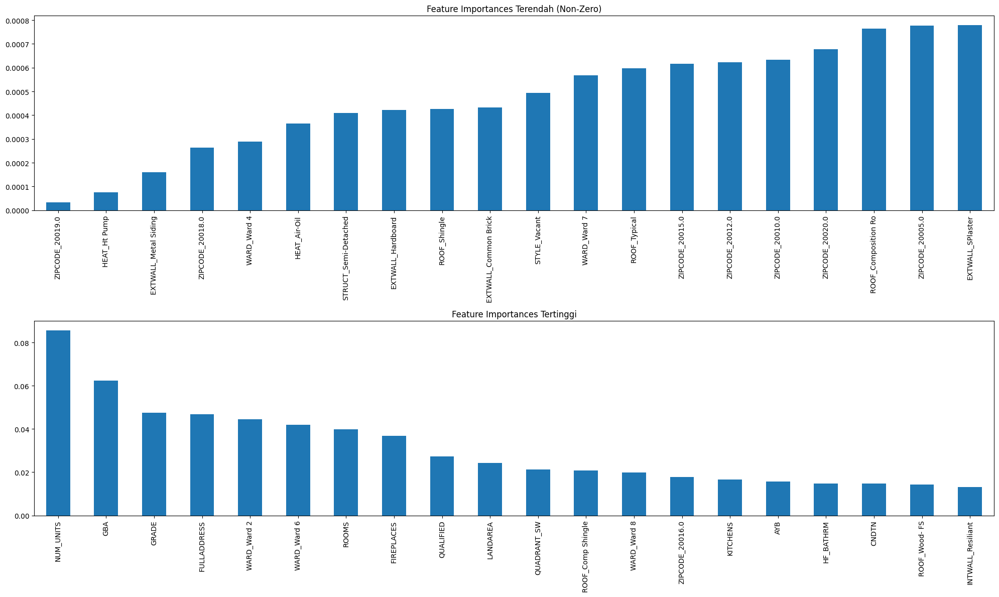

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assume 'best_model' is the best model obtained from your grid search or random search
best_model = xgb_random_search.best_estimator_

# Fit the best model (if not already done)
best_model.fit(x_train, y_train)

# Extract the trained XGBoost model from the pipeline
xgb_model = best_model.named_steps['model_xgb']

# Get feature importances from the XGBoost model
feature_importances = xgb_model.feature_importances_

# Get the feature names (use the same as computed in the previous steps)
# 'feature_names_fixed' was generated during transformation
all_feature_names = feature_names_fixed

# Ensure the length of feature names matches the feature importance length
if len(feature_importances) != len(all_feature_names):
    min_length = min(len(feature_importances), len(all_feature_names))
    print(f"Trimming to match lengths: using {min_length} elements.")

    # Trim both lists to the same length
    feature_importances = feature_importances[:min_length]
    all_feature_names = all_feature_names[:min_length]

# Continue processing after lengths match
print(f"Number of feature importance values: {len(feature_importances)}")
print(f"Number of feature names: {len(all_feature_names)}")

# Create a pandas series of feature importances
importances_series = pd.Series(feature_importances, index=all_feature_names)

# Filter out zero importance features for visualization
non_zero_importances = importances_series[importances_series > 0]

# Plot feature importances
plt.figure(figsize=(20, 12))

# Plot lowest 20 features
plt.subplot(2, 1, 1)
if len(non_zero_importances) > 0:
    coef1 = non_zero_importances.sort_values(ascending=True).head(20)
    coef1.plot(kind='bar', title='Feature Importances Terendah (Non-Zero)')
else:
    print("No non-zero importances found.")

# Plot highest 20 features
plt.subplot(2, 1, 2)
coef2 = non_zero_importances.sort_values(ascending=False).head(20)
coef2.plot(kind='bar', title='Feature Importances Tertinggi')

plt.tight_layout()
plt.show()


#### Model Limitation

In [ ]:
XGBtuned = TransformedTargetRegressor(xgb_random_search.best_estimator_, func=np.log, inverse_func=np.exp)

XGBtuned.fit(x_train, y_train)
y_pred_xgb_tuned = XGBtuned.predict(x_test)
mae_tuned = mean_absolute_error(y_test, y_pred_xgb_tuned)
mape_tuned = mean_absolute_percentage_error(y_test, y_pred_xgb_tuned)
r2_tuned = r2_score(y_test, y_pred_xgb_tuned)

score_after_tuning = pd.DataFrame({'MAE': mae_tuned, 'MAPE': mape_tuned, 'R-squared': r2_tuned}, index=['XGBoost after Tuning'])
score_after_tuning

,MAE,MAPE,R-squared
XGBoost after Tuning,91916.745548,0.187665,0.830458


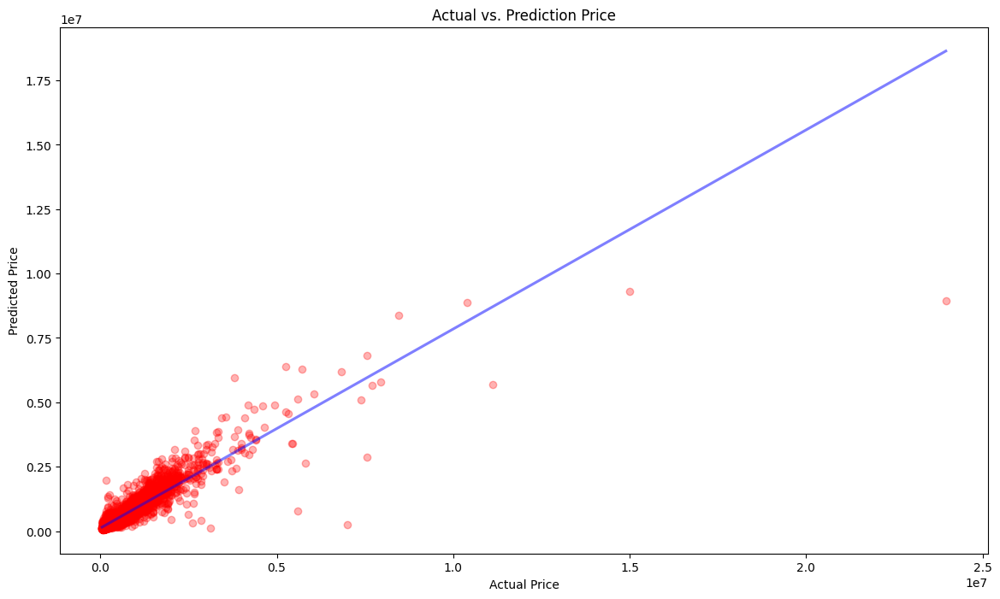

In [ ]:
# Melihat Price Act VS Price Pred
plt.figure(figsize=(14, 8))
sns.regplot(x=y_test, y=y_pred_xgb_tuned, ci=None, scatter_kws = {'color': 'red', 'alpha': 0.3}, line_kws = {'color': 'blue', 'alpha': 0.5}).set(title='Actual vs. Prediction Price',
                                               xlabel='Actual Price',
                                               ylabel='Predicted Price')
plt.show()

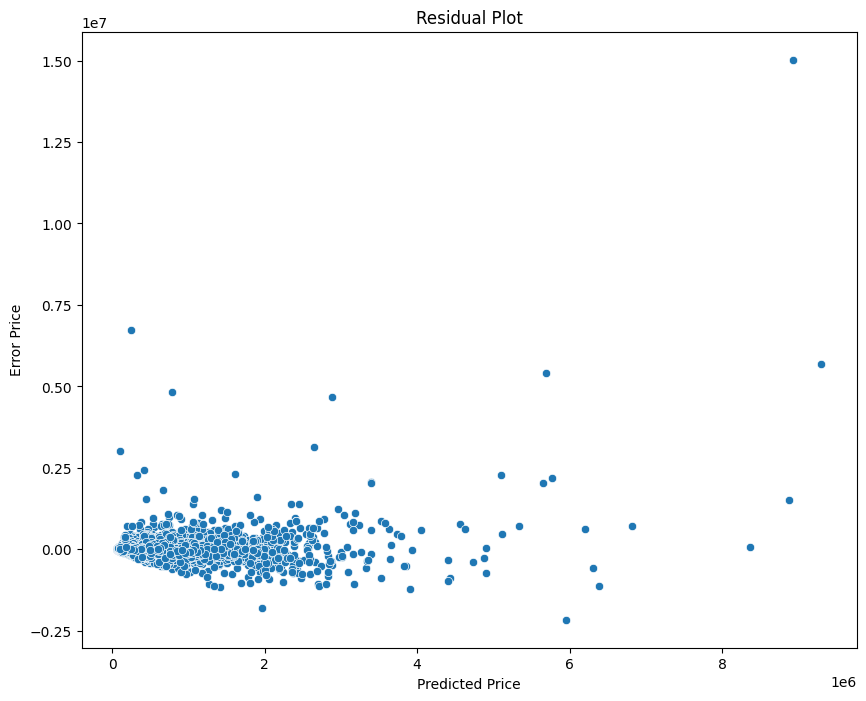

In [ ]:
# Analisa Residual
residual = y_test - y_pred_xgb_tuned

plt.figure(figsize=(10,8))
sns.scatterplot(x=y_pred_xgb_tuned, y=residual).set(title='Residual Plot', xlabel='Predicted Price', ylabel='Error Price')
plt.show()

<ipython-input-135-e446503bc30e>:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



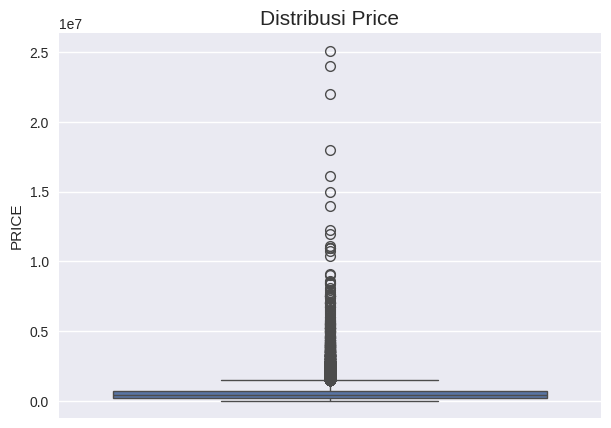

In [ ]:
# Distribusi PRICE
plt.style.use('seaborn')
plt.figure(figsize=(7,5))
sns.boxplot(df_model['PRICE']).set_title('Distribusi Price', size=15)
plt.show()

In [ ]:
# Melakukan pemisahan feature x dan target y tanpa outlier
dfModelOpt = df_model[df_model['PRICE']<15000000]
x1 = dfModelOpt.drop(columns=['PRICE'])
y1 = dfModelOpt['PRICE']
# Melakukan splitting data train 80% dan data test 20%
x_train1,x_test1,y_train1,y_test1=train_test_split(x1,y1,test_size=0.2,random_state=0)

In [ ]:
print(dfModelOpt.info())

<class 'pandas.core.frame.DataFrame'>
Index: 56772 entries, 0 to 57288
Data columns (total 36 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   BATHRM             56772 non-null  int64  
 1   HF_BATHRM          56772 non-null  int64  
 2   HEAT               56751 non-null  object 
 3   AC                 56772 non-null  object 
 4   NUM_UNITS          56772 non-null  float64
 5   ROOMS              56772 non-null  int64  
 6   BEDRM              56772 non-null  int64  
 7   AYB                56772 non-null  int64  
 8   YR_RMDL            56772 non-null  object 
 9   EYB                56772 non-null  int64  
 10  STORIES            56772 non-null  float64
 11  PRICE              56772 non-null  float64
 12  QUALIFIED          56772 non-null  object 
 13  GBA                56772 non-null  float64
 14  STYLE              56758 non-null  object 
 15  STRUCT             56768 non-null  object 
 16  GRADE              56772 no

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score

# Define categorical and numerical columns
categorical_cols = x_train1.select_dtypes(include=['object']).columns.tolist()
numerical_cols = x_train1.select_dtypes(include=['int64', 'float64']).columns.tolist()

# Convert all categorical columns to strings
for col in categorical_cols:
    x_train1[col] = x_train1[col].astype(str)
    x_test1[col] = x_test1[col].astype(str)

# Preprocessing for numerical data
numerical_transformer = SimpleImputer(strategy='mean')

# Preprocessing for categorical data
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore', dtype=int))
])

# Bundle preprocessing for numerical and categorical data
preprocessor = ColumnTransformer(transformers=[
    ('num', numerical_transformer, numerical_cols),
    ('cat', categorical_transformer, categorical_cols)
])

# Create a preprocessing and modeling pipeline
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', XGBRegressor(random_state=42))
])

# Fit the model
model.fit(x_train1, y_train1)

# Predict
y_pred_xgb_tunedNew = model.predict(x_test1)

# Calculate evaluation metrics
mae_tunedNew = mean_absolute_error(y_test1, y_pred_xgb_tunedNew)
mape_tunedNew = mean_absolute_percentage_error(y_test1, y_pred_xgb_tunedNew)
r2_tunedNew = r2_score(y_test1, y_pred_xgb_tunedNew)

# Create a DataFrame to show scores
score_after_tuningNew = pd.DataFrame({
    'MAE': [mae_tunedNew],
    'MAPE': [mape_tunedNew],
    'R-squared': [r2_tunedNew]
}, index=['XGBoost after Tuning with No Outlier'])

# Display the results
print(score_after_tuningNew)


                                                MAE      MAPE  R-squared
XGBoost after Tuning with No Outlier  170161.603688  0.471056   0.729941


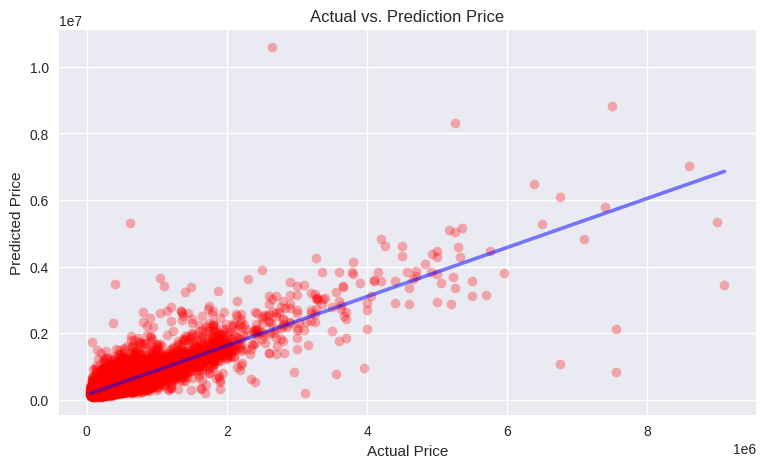

In [ ]:
# Melihat Price Act VS Price Pred
plt.figure(figsize=(9, 5))
sns.regplot(x=y_test1, y=y_pred_xgb_tunedNew, ci=None, scatter_kws = {'color': 'red', 'alpha': 0.3}, line_kws = {'color': 'blue', 'alpha': 0.5}).set(title='Actual vs. Prediction Price',
                                               xlabel='Actual Price',
                                               ylabel='Predicted Price')
plt.show()

In [ ]:
# Melihat perbandingan metrik dengan dan tanpa outlier
display(score_after_tuning, score_after_tuningNew)

,MAE,MAPE,R-squared
XGBoost after Tuning,91916.745548,0.187665,0.830458


,MAE,MAPE,R-squared
XGBoost after Tuning with No Outlier,170161.603688,0.471056,0.729941


In [ ]:
# Melihat sebaran jumlah kelompok masing-masing GRADE di bawah dan di atas 3.25juta
display(dfModelOpt[dfModelOpt['PRICE']<3250000]['GRADE'].value_counts(),dfModelOpt[dfModelOpt['PRICE']>3250000]['GRADE'].value_counts())

,count
GRADE,
Average,19103
Above Average,16953
Good Quality,11629
Very Good,4962
Excellent,1794
Superior,1440
Exceptional-A,358
Exceptional-B,84
Fair Quality,73


,count
GRADE,
Exceptional-A,95
Exceptional-B,83
Superior,66
Exceptional-C,29
Exceptional-D,20
Average,17
Excellent,14
Above Average,8
Good Quality,7


In [ ]:
# Dataset untuk clustering
dfCluster = df_model[(df_model['PRICE']<=1565000) & (df_model['GBA']<=3317)].reset_index()
dfCluster = dfCluster[['PRICE','GBA','SALEYEAR','GRADE']]

ordinal_mapping2 = [{'col':'GRADE',
    'mapping':{'Low Quality' : 0,
    'Fair Quality' : 1,
    'Average' : 2,
    'Above Average' : 3,
    'Good Quality' : 4,
    'Very Good' : 5,
    'Excellent' : 6,
    'Superior' : 7,
    'Exceptional-A' :8,
    'Exceptional-B' : 9,
    'Exceptional-C' : 10,
    'Exceptional-D' :11,
    }}]

ordinal = ce.OrdinalEncoder(mapping = ordinal_mapping2).fit_transform(dfCluster['GRADE'])
dfCluster['GRADE'] = ordinal['GRADE']
scaler = MinMaxScaler().fit_transform(dfCluster[['GBA','SALEYEAR','GRADE']])
scaler = pd.DataFrame(scaler, columns=['GBA', 'SALEYEAR','GRADE'])
scaler['PRICE'] = dfCluster['PRICE']
dfCluster = scaler
dfCluster.head()

# Membuat sampling data
cluster_sample = resample(dfCluster, n_samples=20000, random_state = 0)

In [ ]:
# Data clustering K-Means dan Agglomerative
dfClusterkm = cluster_sample.copy()
dfClusteragg = cluster_sample.copy()

<ipython-input-155-77b40b10bac6>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


<ipython-input-155-77b40b10bac6>:6: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


<ipython-input-155-77b40b10bac6>:8: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use

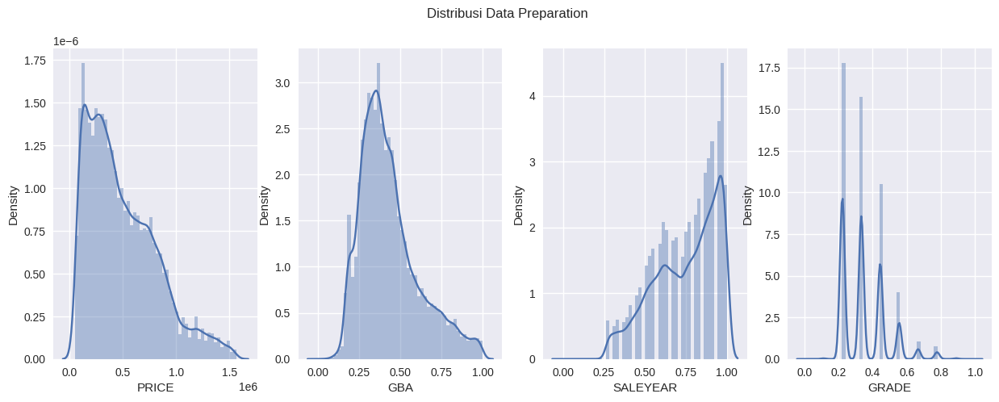

In [ ]:
# Melihat distribusi data tanpa outlier dan setelah scaling
plt.figure(figsize = (15,5))
plt.subplot(1,4,1)
sns.distplot(scaler['PRICE'])
plt.subplot(1,4,2)
sns.distplot(scaler['GBA'])
plt.subplot(1,4,3)
sns.distplot(scaler['SALEYEAR'])
plt.subplot(1,4,4)
sns.distplot(scaler['GRADE'])
plt.suptitle('Distribusi Data Preparation')
plt.show()

#### Clustering with K-Means

K-Means merupakan metode clustering dengan menggunakan konsep rata-rata jarak antar data poin untuk mengetahui seberapa dekat suatu data poin dengan pusat cluster. Akan digunakan silhouette score untuk menentukan jumlah cluster yang akan digunakan.

In [ ]:
# Silhouette score
silhouetteKM= []

for i in range(3, 10):
  clust_km = KMeans(n_clusters=i, random_state=0)
  clust_km.fit(dfClusterkm[['GBA', 'SALEYEAR', 'GRADE', 'PRICE']])
  labels = clust_km.labels_
  silhouetteKM.append(silhouette_score(dfClusterkm, labels, metric = 'euclidean', random_state=0))

In [ ]:
# Melihat silhouette score
print(sorted(silhouetteKM))

[0.5425794249853018, 0.54594043399976, 0.5499114808546519, 0.5501469711892214, 0.561407175177327, 0.5678570331755953, 0.5867005646151794]


<ipython-input-158-8495b0b29b60>:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



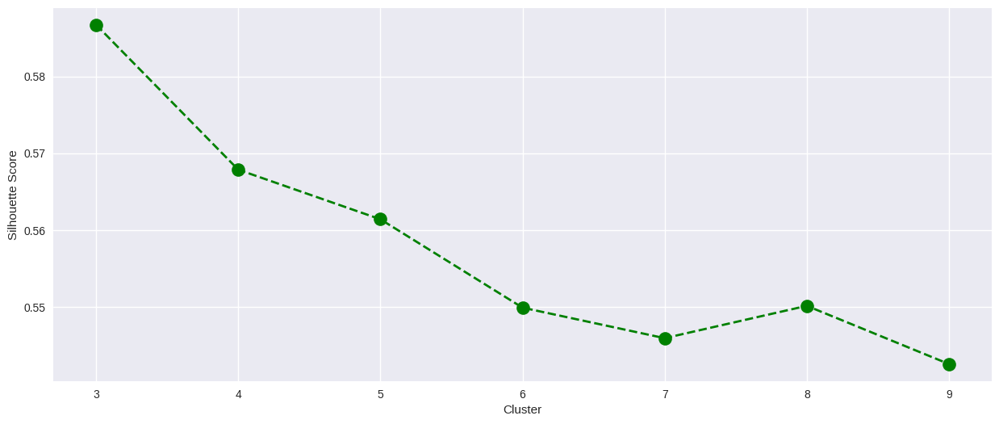

In [ ]:
# Plot silhouette score
plt.style.use('seaborn')
plt.figure(figsize=(15,6))
plt.plot(np.arange(3, 10),silhouetteKM, color='green', marker='o', linestyle='dashed',
     linewidth=2, markersize=12)
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.xticks(np.arange(3,10))
plt.show()

Jumlah cluster yang optimal adalah 3 dengan silhouette score sebesar 0.587, sehingga akan digunakan 3 cluster pada metode K-Means.

* **K-Means**

In [ ]:
# Fit model KMeans menggunakan 3 cluster
clust_km = KMeans(n_clusters = 3, max_iter = 50000, random_state=0)
clust_km.fit(dfClusterkm[['GBA', 'SALEYEAR', 'PRICE','GRADE']])

KMeans(max_iter=50000, n_clusters=3, random_state=0)

In [ ]:
# Membuat kolom cluster
dfClusterkm['K-MEANS'] = clust_km.predict(dfClusterkm[['GBA', 'SALEYEAR', 'PRICE','GRADE']])
dfClusterkm.head()

,GBA,SALEYEAR,GRADE,PRICE,K-MEANS
2732,0.373246,0.805556,0.555556,627460.0,0
43567,0.182055,0.861111,0.222222,178000.0,2
42613,0.314519,0.472222,0.222222,475000.0,0
52416,0.487439,0.305556,0.222222,72513.0,2
45891,0.189233,0.750000,0.222222,146860.0,2


<ipython-input-161-c3a1eca8a90d>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-161-c3a1eca8a90d>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-161-c3a1eca8a90d>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-161-c3a1eca8a90d>:7: MatplotlibDeprecationW

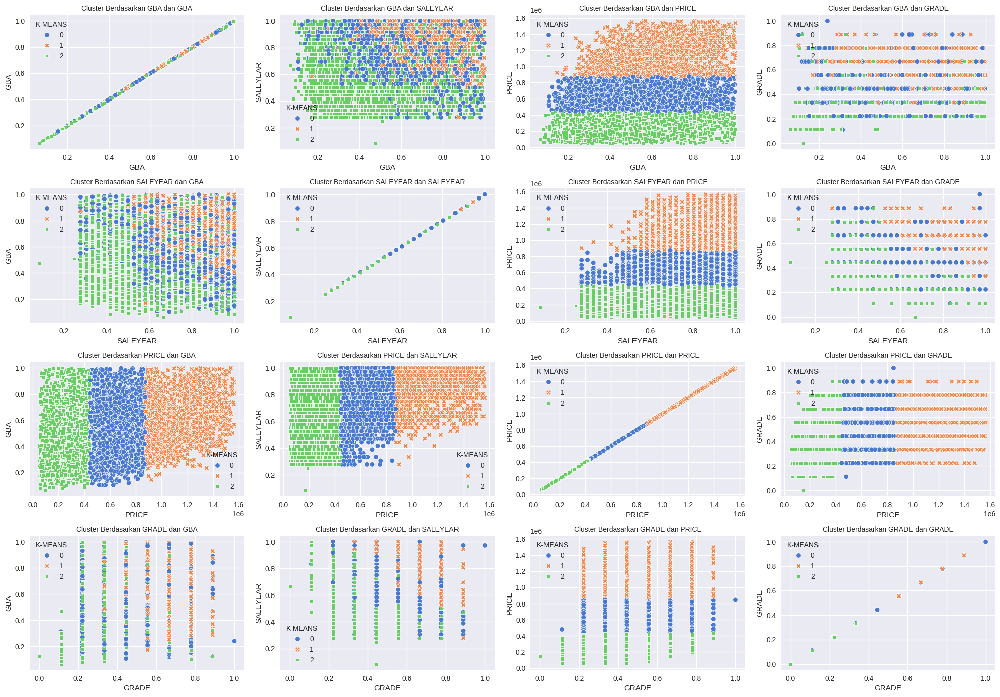

In [ ]:
# Melihat scatter plot clustering dengan K-Means
plt.figure(figsize = (20,55))
kolomcluster = ['GBA', 'SALEYEAR', 'PRICE', 'GRADE']
a=1
for i in range(0,4):
    for j in range(0,4):
        plt.style.use('seaborn')
        plt.subplot(16,4,a)
        sns.scatterplot(data=dfClusterkm, x = kolomcluster[i], y=kolomcluster[j],hue='K-MEANS', style = 'K-MEANS',palette='muted')
        plt.title(f'Cluster Berdasarkan {kolomcluster[i]} dan {kolomcluster[j]}', size = 10)
        a+=1
plt.tight_layout()
plt.show()

Dari scatterplot di atas terlihat bahwa kolom PRICE mampu membedakan cluster dengan cukup baik. Selanjutnya akan dilakukan clustering dengan metode agglomerative dan akan dibandingkan hasil silhouette score untuk menentukan model terbaik.

#### Clustering with Agglomerative

Agglomerative bekerja dengan cara melakukan merge pada setiap data poin menjadi satu data poin yang baru. Terdapat 3 metode yang akan digunakan yaitu Ward, Complete, dan Average. Linkage Ward menggabungkan cluster berdasarkan varians terkecil. Linkage complete menggabungkan cluster yang memiliki jarak maksimum terkecil. Linkage average menggabungkan dua cluster yang memiliki jarak rata-rata terkecil di antara semua titiknya. Metode tersebut akan dibandingkan untuk mengetahui clustering agglomerative terbaik. Agglomerative menuntut komputasi yang tinggi dan sulit digunakan pada dataset yang besar, sehingga akan diambil sampel untuk pemodelan.

* **Linkage Ward**

In [ ]:
# Menghitung silhouette score
silhouetteWARD = []

for i in range(3, 10):
  clust_agg = AgglomerativeClustering(n_clusters=i)
  clust_agg.fit(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])
  labels = clust_agg.labels_
  silhouetteWARD.append(silhouette_score(dfClusteragg, labels, metric = 'euclidean', random_state=0))

In [ ]:
# Melihat silhouette score
print(sorted(silhouetteWARD))

[0.5045925023517019, 0.5089599567033811, 0.5123130961236537, 0.5144490593689433, 0.5252420189629388, 0.5510072333915492, 0.5524007439962311]


<ipython-input-164-77ae5c9ee176>:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



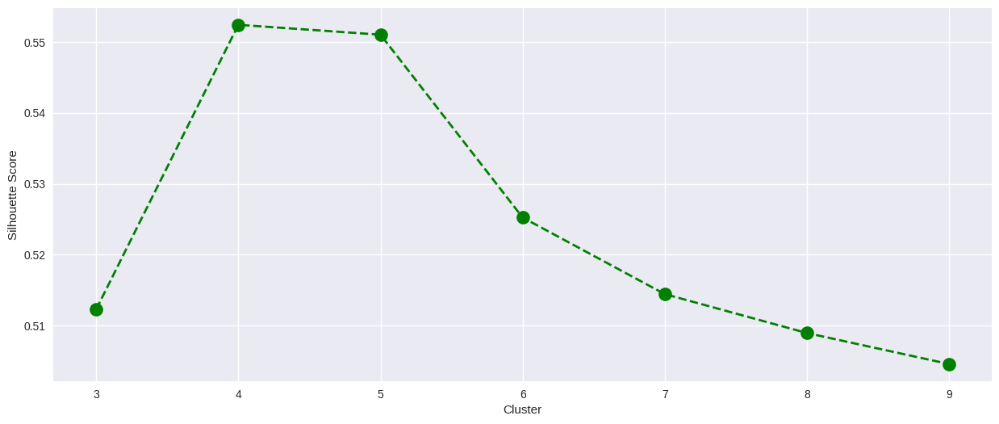

In [ ]:
# Plotting sillhoutte score
plt.style.use('seaborn')
plt.figure(figsize=(15,6))
plt.plot(np.arange(3, 10), silhouetteWARD, color='green', marker='o', linestyle='dashed',
     linewidth=2, markersize=12)
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.xticks(np.arange(3,10))
plt.show()

In [ ]:
# Melakukan fitting model
clust_agg = AgglomerativeClustering(n_clusters = 3, linkage='ward')
clust_agg.fit(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])

AgglomerativeClustering(n_clusters=3)

In [ ]:
# Membuat kolom cluster Agglomerative Ward
dfClusteragg['AGG WARD'] = clust_agg.fit_predict(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])
dfClusteragg.head()

,GBA,SALEYEAR,GRADE,PRICE,AGG WARD
2732,0.373246,0.805556,0.555556,627460.0,0
43567,0.182055,0.861111,0.222222,178000.0,1
42613,0.314519,0.472222,0.222222,475000.0,2
52416,0.487439,0.305556,0.222222,72513.0,1
45891,0.189233,0.750000,0.222222,146860.0,1


<ipython-input-170-131d9d023146>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-170-131d9d023146>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-170-131d9d023146>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-170-131d9d023146>:7: MatplotlibDeprecationW

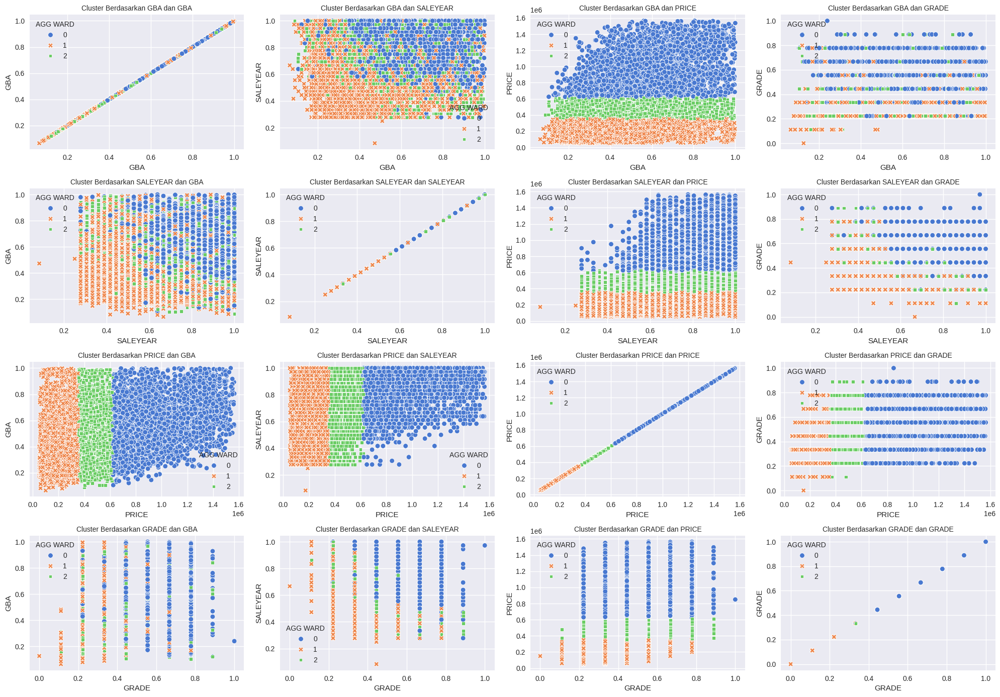

In [ ]:
# Melihat scatter plot clustering dengan Agglomerative Ward
plt.figure(figsize = (20,55))
kolomcluster = ['GBA', 'SALEYEAR', 'PRICE', 'GRADE']
a=1
for i in range(0,4):
    for j in range(0,4):
        plt.style.use('seaborn')
        plt.subplot(16,4,a)
        sns.scatterplot(data=dfClusteragg, x = kolomcluster[i], y=kolomcluster[j],hue='AGG WARD', style = 'AGG WARD',palette='muted')
        plt.title(f'Cluster Berdasarkan {kolomcluster[i]} dan {kolomcluster[j]}', size = 10)
        a+=1
plt.tight_layout()
plt.show()

* **Linkage Complete**

In [ ]:
# Melihat silhouette score
silhouetteComp = []

for i in range(3, 10):
  clust_agg = AgglomerativeClustering(n_clusters=i, linkage='complete')
  clust_agg.fit(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])
  labels = clust_agg.labels_
  silhouetteComp.append(silhouette_score(dfClusteragg, labels, metric = 'euclidean', random_state=0))

In [ ]:
# Melihat silhouette score
print(sorted(silhouetteComp))

[0.5056828405918068, 0.5294708340448261, 0.5356857650819503, 0.5432994797395068, 0.5520990280543182, 0.5622300594928119, 0.6068166105853559]


<ipython-input-173-6b3460b89317>:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



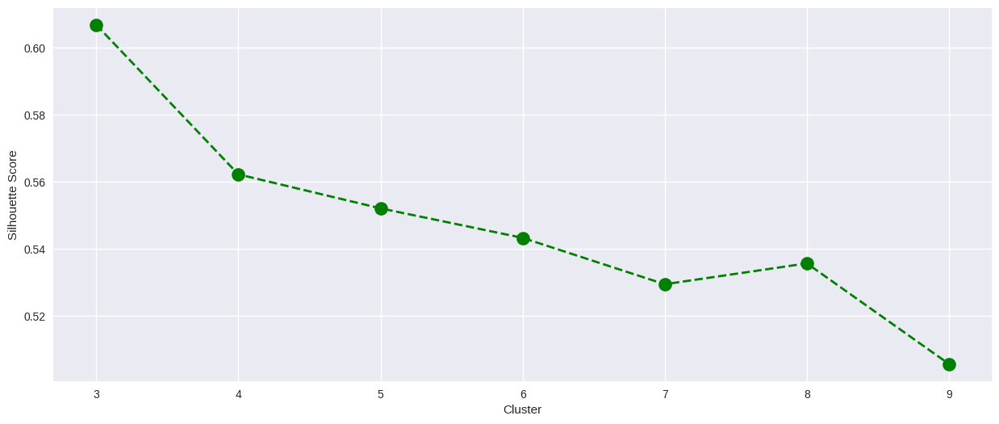

In [ ]:
# Plotting Sillhoutte Score
plt.style.use('seaborn')
plt.figure(figsize=(15,6))
plt.plot(np.arange(3, 10), silhouetteComp, color='green', marker='o', linestyle='dashed',
     linewidth=2, markersize=12)
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.xticks(np.arange(3,10))
plt.show()

In [ ]:
# Melakukan fitting model
clust_agg = AgglomerativeClustering(n_clusters = 3, linkage='complete')
clust_agg.fit(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])

AgglomerativeClustering(linkage='complete', n_clusters=3)

In [ ]:
# Membuat kolom cluster Agglomerative complete
dfClusteragg['AGG COMPLETE'] = clust_agg.fit_predict(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])
dfClusteragg.head()

,GBA,SALEYEAR,GRADE,PRICE,AGG WARD,AGG COMPLETE
2732,0.373246,0.805556,0.555556,627460.0,0,0
43567,0.182055,0.861111,0.222222,178000.0,1,1
42613,0.314519,0.472222,0.222222,475000.0,2,1
52416,0.487439,0.305556,0.222222,72513.0,1,1
45891,0.189233,0.750000,0.222222,146860.0,1,1


<ipython-input-176-e0fe126b34e9>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-176-e0fe126b34e9>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-176-e0fe126b34e9>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-176-e0fe126b34e9>:7: MatplotlibDeprecationW

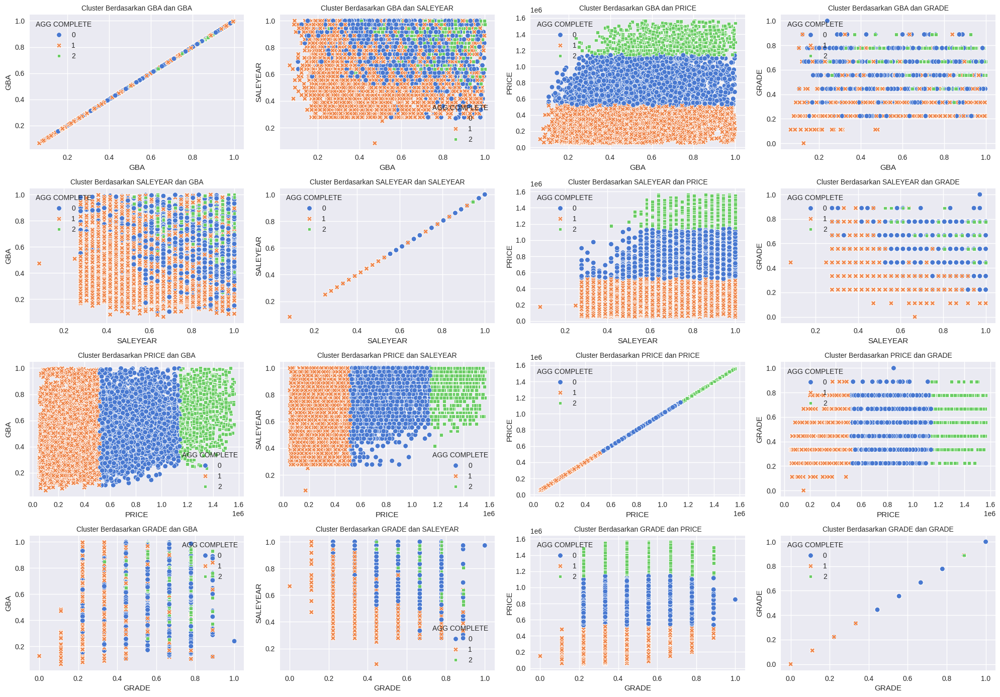

In [ ]:
# Melihat scatter plot clustering dengan Agglomerative Complete
plt.figure(figsize = (20,55))
kolomcluster = ['GBA', 'SALEYEAR', 'PRICE', 'GRADE']
a=1
for i in range(0,4):
    for j in range(0,4):
        plt.style.use('seaborn')
        plt.subplot(16,4,a)
        sns.scatterplot(data=dfClusteragg, x = kolomcluster[i], y=kolomcluster[j],hue='AGG COMPLETE', style = 'AGG COMPLETE',palette='muted')
        plt.title(f'Cluster Berdasarkan {kolomcluster[i]} dan {kolomcluster[j]}', size = 10)
        a+=1
plt.tight_layout()
plt.show()

* **Linkage Average**

In [ ]:
# Melihat nilai silhouette score
silhouetteAvg = []

for i in range(3, 10):
  clust_agg = AgglomerativeClustering(n_clusters=i, linkage='average')
  clust_agg.fit(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])
  labels = clust_agg.labels_
  silhouetteAvg.append(silhouette_score(dfClusteragg, labels, metric = 'euclidean', random_state=0))

In [ ]:
# Melihat silhouette score
print(sorted(silhouetteAvg))

[0.5073433485646289, 0.507696607961577, 0.5190422538226042, 0.5205300074942543, 0.5339651167154374, 0.5455807894915122, 0.5908444345775344]


<ipython-input-179-ebaa3e66f139>:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



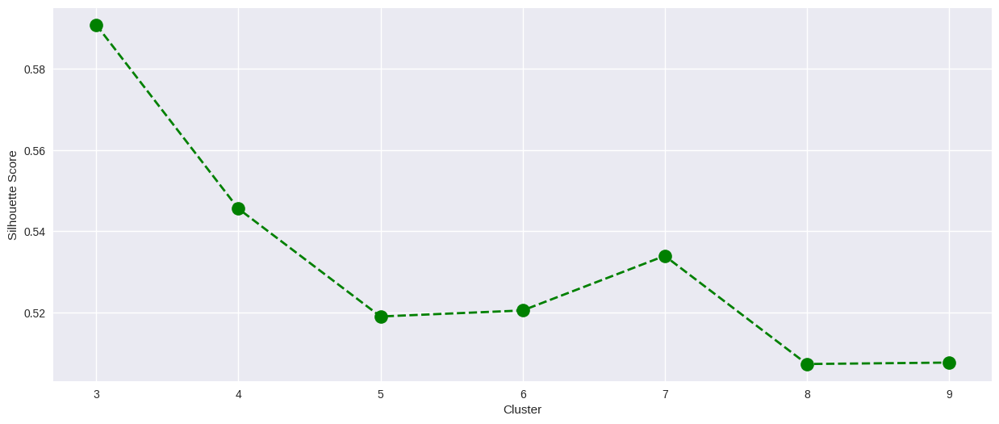

In [ ]:
# Plotting Sillhoutte Score
plt.style.use('seaborn')
plt.figure(figsize=(15,6))
plt.plot(np.arange(3, 10), silhouetteAvg, color='green', marker='o', linestyle='dashed',
     linewidth=2, markersize=12)
plt.xlabel("Cluster")
plt.ylabel("Silhouette Score")
plt.xticks(np.arange(3,10))
plt.show()

In [ ]:
# Fitting model
clust_agg = AgglomerativeClustering(n_clusters = 3, linkage='average')
clust_agg.fit(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])

AgglomerativeClustering(linkage='average', n_clusters=3)

In [ ]:
# Membuat kolom cluster Agglomerative average
dfClusteragg['AGG AVERAGE'] = clust_agg.fit_predict(dfClusteragg[['GBA','SALEYEAR', 'PRICE','GRADE']])
dfClusteragg.head()

,GBA,SALEYEAR,GRADE,PRICE,AGG WARD,AGG COMPLETE,AGG AVERAGE
2732,0.373246,0.805556,0.555556,627460.0,0,0,2
43567,0.182055,0.861111,0.222222,178000.0,1,1,1
42613,0.314519,0.472222,0.222222,475000.0,2,1,1
52416,0.487439,0.305556,0.222222,72513.0,1,1,1
45891,0.189233,0.750000,0.222222,146860.0,1,1,1


<ipython-input-182-ccaba5de987a>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-182-ccaba5de987a>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-182-ccaba5de987a>:7: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

<ipython-input-182-ccaba5de987a>:7: MatplotlibDeprecationW

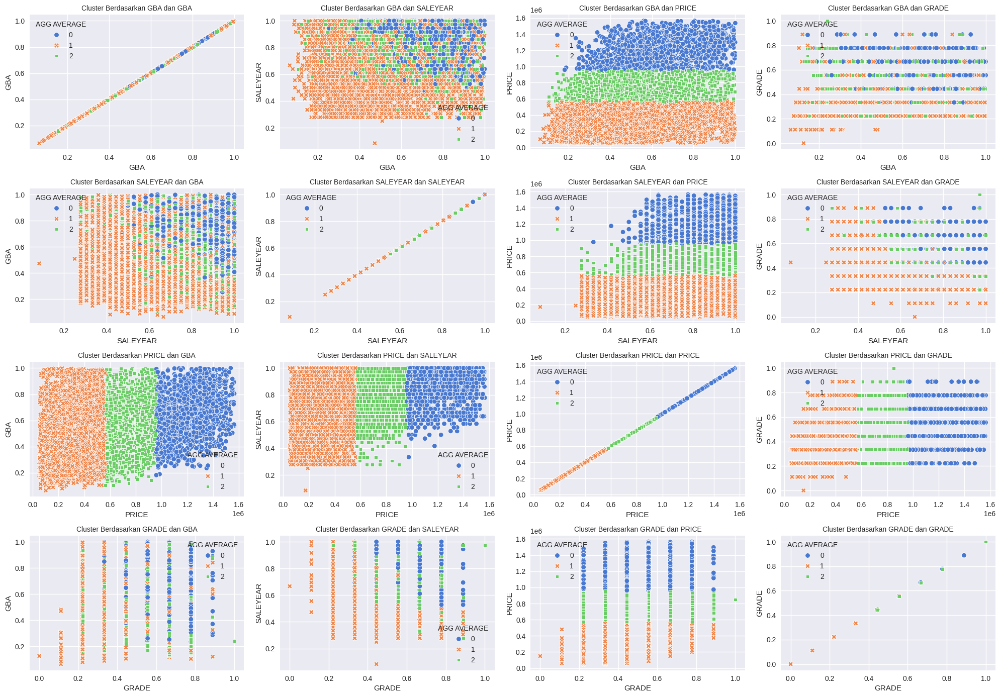

In [ ]:
# Melihat scatter plot clustering dengan Agglomerative Average
plt.figure(figsize = (20,55))
kolomcluster = ['GBA', 'SALEYEAR', 'PRICE', 'GRADE']
a=1
for i in range(0,4):
    for j in range(0,4):
        plt.style.use('seaborn')
        plt.subplot(16,4,a)
        sns.scatterplot(data=dfClusteragg, x = kolomcluster[i], y=kolomcluster[j],hue='AGG AVERAGE', style = 'AGG AVERAGE',palette='muted')
        plt.title(f'Cluster Berdasarkan {kolomcluster[i]} dan {kolomcluster[j]}', size = 10)
        a+=1
plt.tight_layout()
plt.show()

#### Model Selection

In [ ]:
# Melihat silhouette score
silhouettemet = [[max(silhouetteKM),3],[max(silhouetteWARD),3],[max(silhouetteComp),3],[max(silhouetteAvg),3]]
silhouetteall = pd.DataFrame(data = silhouettemet, columns=['Score','Jumlah Cluster'], index = ['K-Means', ' Ward', 'Complete', 'Average'])
silhouetteall

,Score,Jumlah Cluster
K-Means,0.586701,3
Ward,0.552401,3
Complete,0.606817,3
Average,0.590844,3


Dapat dilihat dari silhouette score di atas, nilai tertinggi adalah 0.601 dengan menggunakan cluster agglomerative linkage ward yang menghasilkan 3 cluster. Sehingga clustering akan menggunakan model tersebut dan cluster dibagi menjadi 3. Karena keterbatasan device, analisa dari cluster akan diambil 20.000 data saja sebagai sampel dan melewati preprocessing.


In [ ]:
# Data sampling
dfClustering = df_model[(df_model['PRICE']<=1565000) & (df_model['GBA']<=3317)]
dfModelSampel = resample(dfClustering, n_samples=20000,random_state=0)
dfModelSampel.reset_index(drop = True, inplace = True)

In [ ]:
# Melewati preprocessing
dfClusterFit = dfModelSampel[['PRICE','GBA','SALEYEAR','GRADE']]

ordinal_mapping2 = [{'col':'GRADE',
    'mapping':{'Low Quality' : 0,
    'Fair Quality' : 1,
    'Average' : 2,
    'Above Average' : 3,
    'Good Quality' : 4,
    'Very Good' : 5,
    'Excellent' : 6,
    'Superior' : 7,
    'Exceptional-A' :8,
    'Exceptional-B' : 9,
    'Exceptional-C' : 10,
    'Exceptional-D' :11,
    }}]

ordinal = ce.OrdinalEncoder(mapping = ordinal_mapping2).fit_transform(dfClusterFit['GRADE'])
dfClusterFit['GRADE'] = ordinal['GRADE']
scaler = MinMaxScaler().fit_transform(dfClusterFit[['GBA','SALEYEAR','GRADE']])
scaler = pd.DataFrame(scaler, columns=['GBA', 'SALEYEAR','GRADE'])
scaler['PRICE'] = dfClusterFit['PRICE']
dfClusterFit = scaler
dfClusterFit.head()

<ipython-input-186-929ffaa26536>:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,GBA,SALEYEAR,GRADE,PRICE
0,0.329962,0.787879,0.555556,627460.0
1,0.125567,0.848485,0.222222,178000.0
2,0.267178,0.424242,0.222222,475000.0
3,0.452040,0.242424,0.222222,72513.0
4,0.133240,0.727273,0.222222,146860.0


Akan dilakukan segmentasi pada data dfClusterFit.

In [ ]:
# Membuat kolom cluster Agglomerative Ward
clust_agg = AgglomerativeClustering(n_clusters = 3, linkage='ward')
clust_agg.fit(dfClusterFit[['GBA','SALEYEAR', 'PRICE','GRADE']])
dfClusterFit['AGG WARD'] = clust_agg.fit_predict(dfClusterFit[['GBA','SALEYEAR', 'PRICE','GRADE']])
dfClusterFit.head()

,GBA,SALEYEAR,GRADE,PRICE,AGG WARD
0,0.329962,0.787879,0.555556,627460.0,0
1,0.125567,0.848485,0.222222,178000.0,1
2,0.267178,0.424242,0.222222,475000.0,2
3,0.452040,0.242424,0.222222,72513.0,1
4,0.133240,0.727273,0.222222,146860.0,1


We collected the segment to create a different segment of price range based on GBA, Saleyear, Grade and Price, to achieve it

In [ ]:
# Melihat median harga di setiap cluster
median_price_per_cluster = dfClusterFit.groupby('AGG WARD')['PRICE'].median().sort_values()
print(median_price_per_cluster)


AGG WARD
1    205000.0
2    467750.0
0    832500.0
Name: PRICE, dtype: float64


In [ ]:
# Membuat mapping baru
cluster_mapping = {median_price_per_cluster.index[0]: 0,
                   median_price_per_cluster.index[1]: 1,
                   median_price_per_cluster.index[2]: 2}

# Terapkan mapping ke kolom 'AGG WARD'
dfClusterFit['AGG WARD'] = dfClusterFit['AGG WARD'].map(cluster_mapping)

In [ ]:
dfClusterFit.groupby('AGG WARD')['PRICE'].describe()


,count,mean,std,min,25%,50%,75%,max
AGG WARD,,,,,,,,
0,8341.0,206547.733485,83821.678670,50273.0,132000.0,205000.0,280000.0,352310.0
1,5292.0,475298.429327,78492.571427,353000.0,405000.0,467750.0,544250.0,621000.0
2,6367.0,897145.933721,226216.054723,622000.0,725000.0,832500.0,1002000.0,1565000.0


- `Cluster 2` memiliki harga maksimum sekitar 1.565 juta dan minimum sekitar 622 ribu, yang artinya cluster ini berisi properti dengan harga tinggi dan rentang yang besar.
- `Cluster 1 `memiliki harga yang jauh lebih rendah, dengan nilai maksimum hanya sekitar 352 ribu.
- `Cluster 0` berada di tengah dengan rentang harga antara 353 ribu hingga 621 ribu.


<ipython-input-222-2d44360cb5fd>:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-222-2d44360cb5fd>:3: UserWarning:

The palette list has more values (6) than needed (3), which may not be intended.



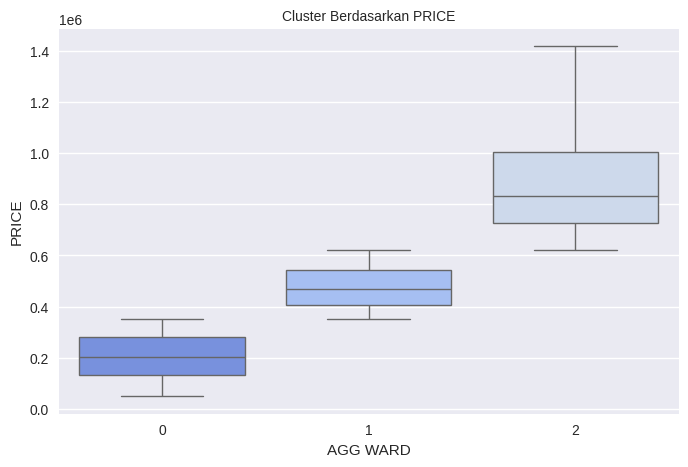

In [ ]:
plt.figure(figsize = (8,5))
colors = sns.color_palette("coolwarm", as_cmap=False)
sns.boxplot(x=dfClusterFit['AGG WARD'], y=dfClusterFit['PRICE'], showfliers=False, palette=colors)
plt.title(f'Cluster Berdasarkan PRICE', size = 10)
plt.show()



Setelah mendapatkan segmentasi properti, akan dianalisa lebih lanjut fitur properti pada masing-masing cluster. Analisa akan menggunakan dataset sample yang telah dibuat digabungkan dengan segmentasi yang telah di prediksi.

We can see that clustering model column ``PRICE`` could make a greate clusterr differentiation, so as we can see the distribution for cluster inn price for choosing the best cluster. from the boxplot abve, we can collect a conclusion for cluster like below
- Cluster 0 = Lowest/B, Because it have the lowest range of prices
- Cluster 1 = Mid/A, It have the middle range of prices
- Cluster 2 = High/S, it have the highest range of price

In [ ]:
# Menggabungkan dataset untuk analisa
dfModelSampel['RARE CLASS'] = dfClusterFit['AGG WARD']
dfModelSampel.head()

,BATHRM,HF_BATHRM,HEAT,AC,NUM_UNITS,ROOMS,BEDRM,AYB,YR_RMDL,EYB,STORIES,PRICE,QUALIFIED,GBA,STYLE,STRUCT,GRADE,CNDTN,EXTWALL,ROOF,INTWALL,KITCHENS,FIREPLACES,USECODE,LANDAREA,GIS_LAST_MOD_DTTM,FULLADDRESS,ZIPCODE,LATITUDE,LONGITUDE,ASSESSMENT_NBHD,WARD,SQUARE,QUADRANT,SALEYEAR,SALEMONTH,RARE CLASS
0,2,1,Forced Air,Y,1.0,6,3,2011,>2000,2014,3.0,627460.0,Q,1396.0,3 Story,Row Inside,Very Good,Excellent,Brick/Siding,Built Up,Hardwood/Carp,1,0,11,574,2018-07-22 18:01:43,922 3RD STREET SE,20003.0,38.878636,-77.001827,Old City 1,Ward 6,798,SE,2011,Aug,2
1,2,0,Forced Air,Y,1.0,4,2,1945,>2000,1965,2.0,178000.0,Q,810.0,2 Story,Semi-Detached,Average,Good,Brick/Siding,Comp Shingle,Hardwood,1,0,13,1500,2018-07-22 18:01:43,5050 HAYES STREET NE,20019.0,38.899951,-76.928080,Deanwood,Ward 7,5177,NE,2013,Jan,0
2,2,0,Hot Water Rad,N,2.0,6,2,1942,1941-1970,1943,2.0,475000.0,U,1216.0,2 Story,Multi,Average,Fair,Common Brick,Built Up,Hardwood,2,0,23,2316,2018-07-22 18:01:43,4526 EADS STREET NE,20019.0,38.895393,-76.936518,Deanwood,Ward 7,5133,NE,1999,Apr,1
3,2,0,Forced Air,N,2.0,8,2,1960,1941-1970,1968,2.0,72513.0,Q,1746.0,2 Story,Multi,Average,Average,Common Brick,Metal- Sms,Hardwood,2,0,23,2697,2018-07-22 18:01:43,3969 MARTIN LUTHER KING JR AVENUE SW,20032.0,38.831879,-77.010083,Congress Heights,Ward 8,6149,SW,1993,Jan,0
4,2,0,Forced Air,Y,1.0,5,2,1952,1941-1970,1970,2.0,146860.0,U,832.0,2 Story,Semi-Detached,Average,Average,Common Brick,Comp Shingle,Hardwood/Carp,1,0,13,1720,2018-07-22 18:01:43,4209 GORMAN STREET SE,20019.0,38.879040,-76.943304,Fort Dupont Park,Ward 7,5380,SE,2009,Jan,0


In [ ]:
# Mengubah segmentasi untuk analisa
dfModelSampel['RARE CLASS'] = dfModelSampel['RARE CLASS'].replace({0:'B', 1: 'A', 2:'S'})
dfModelSampel['RARE CLASS'].head()

,RARE CLASS
0,S
1,B
2,A
3,B
4,B


#### Clustering Analysis

<ipython-input-206-13cfa2bd12c4>:13: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




<Figure size 1500x800 with 0 Axes>

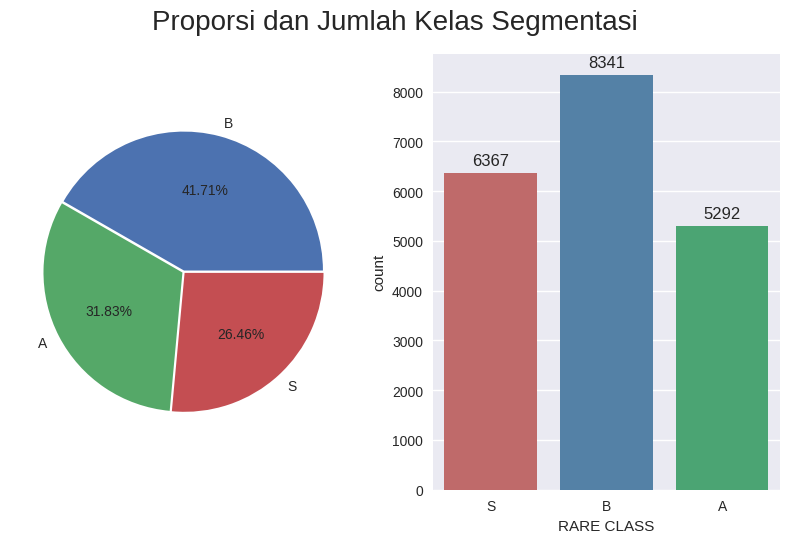

In [ ]:
# Melihat proporsi dan jumlah kelas segmentasi
plt.figure(figsize=(15,8))
palettekelas = {
   'B': 'steelblue',
   'A': 'mediumseagreen',
   'S': 'indianred'
}
sns.color_palette('pastel')
plt.figure().suptitle('Proporsi dan Jumlah Kelas Segmentasi', fontsize=20)
plt.subplot(1,2,1)
plt.pie(dfModelSampel['RARE CLASS'].value_counts(), labels=['B', 'A', 'S'], autopct='%.2f%%',explode=(0.01,0.01,0.01))
plt.subplot(1,2,2)
countsamb = sns.countplot(data=dfModelSampel, x='RARE CLASS',palette = palettekelas)
for bar in countsamb.patches:
    countsamb.annotate(format(bar.get_height(), '.0f'),
                   (bar.get_x() + bar.get_width() / 2., bar.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 9), size=12,
                   textcoords = 'offset points')
sns.color_palette('pastel')
plt.tight_layout()
plt.show()

We can see through this chart that "B" Class are the one that people often pick, and the following "S" people mostly seek for luxurious or buy a property near a high demand area

* **Based on Price persen**

In [ ]:
average_price_per_class = dfModelSampel.groupby('RARE CLASS')['PRICE'].mean()

price_diff_A_to_S = (average_price_per_class['S'] - average_price_per_class['A']) / average_price_per_class['A'] * 100
price_diff_B_to_A = (average_price_per_class['A'] - average_price_per_class['B']) / average_price_per_class['B'] * 100

average_price_per_class, price_diff_B_to_A, price_diff_A_to_S

(RARE CLASS
 A    475298.429327
 B    206547.733485
 S    897145.933721
 Name: PRICE, dtype: float64,
 130.11553857663523,
 88.75423909784908)

Average Price per Class:

Class A: `$475,298.43`
Class B: `$206,547.73`
Class S: `$897,145.93`
Percentage Potential for Increasing Sales:

Upgrading from Class B to Class A could potentially increase the sales price by approximately 130.12%.
Upgrading from Class A to Class S could potentially increase the sales price by approximately 88.75%.

In [ ]:

price_trends = df_filtered.groupby(['SALEYEAR', 'SALEMONTH', 'RARE CLASS'])['PRICE'].mean().reset_index()
latest_year = df_filtered['SALEYEAR'].max()

latest_prices = df_filtered[df_filtered['SALEYEAR'] == latest_year].groupby('RARE CLASS')['PRICE'].mean()
previous_prices = df_filtered[df_filtered['SALEYEAR'] == latest_year - 1].groupby('RARE CLASS')['PRICE'].mean()

percentage_increase = ((latest_prices - previous_prices) / previous_prices) * 100

# Display the results
price_trends.head(), percentage_increase

(   SALEYEAR SALEMONTH RARE CLASS          PRICE
 0      2014       Apr          A  478401.233333
 1      2014       Apr          B  225872.250000
 2      2014       Apr          S  906146.184211
 3      2014       Aug          A  518881.521739
 4      2014       Aug          B  229859.136364,
 RARE CLASS
 A   -2.191309
 B   -1.634645
 S    1.557728
 Name: PRICE, dtype: float64)

<ipython-input-219-3ac8db36b7fe>:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




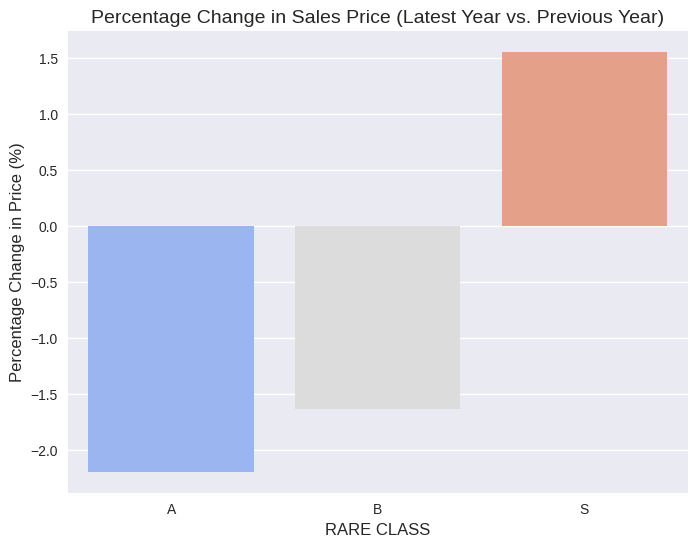

In [ ]:
percentage_change_data = percentage_increase.reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='RARE CLASS', y='PRICE', data=percentage_change_data, palette='coolwarm')

plt.title('Percentage Change in Sales Price (Latest Year vs. Previous Year)', fontsize=14)
plt.xlabel('RARE CLASS', fontsize=12)
plt.ylabel('Percentage Change in Price (%)', fontsize=12)

# Display the plot
plt.show()

* **Based on Location**

In [ ]:
# Melihat sebaran PRICE berdasarkan lokasi
fig = px.scatter_mapbox(dfModelSampel, lat='LATITUDE', lon='LONGITUDE', color='RARE CLASS', hover_data=['PRICE','WARD', 'QUADRANT'],
                        color_discrete_sequence=px.colors.qualitative.Safe, zoom=9.5, height=500, width=700, opacity=1,
                        title='Distribusi berdasarkan Segmentasi DC Residential Properties')
fig.update_traces(marker=dict(size=2.5))
fig.update_layout(mapbox_style='carto-darkmatter',margin=dict(l=10,r=0,t=40,b=10))
fig.show()

Text(0.5, 1.0, 'Lokasi Properti berdasarkan Segmentasi')

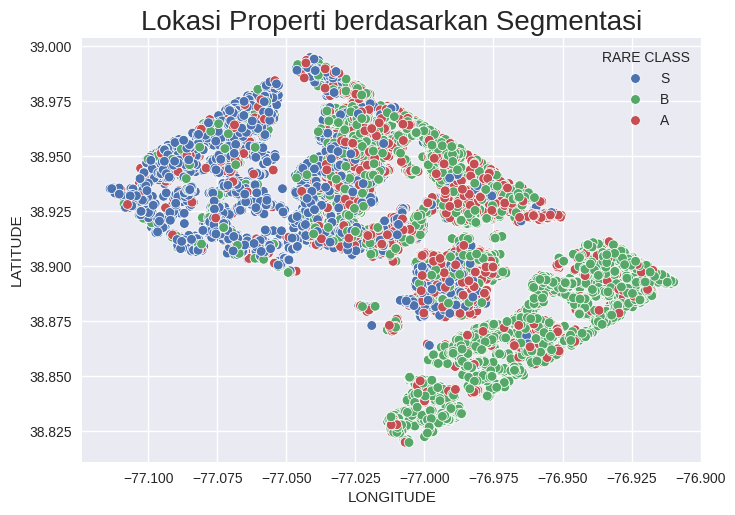

In [ ]:
sns.scatterplot(data=dfModelSampel, x='LONGITUDE', y='LATITUDE', hue='RARE CLASS').set_title('Lokasi Properti berdasarkan Segmentasi',size=20)

Berdasarkan grafik di atas dapat dilihat bahwa lokasi untuk properti dengan segmentasi **"B"** tersebar dengan cukup merata di Washington DC, dengan proporsi paling sedikit berada di kuadran ***Southwest***. Sedangkan untuk properti dengan segmentasi **"A"** cenderung tersebar pada kuadran ***Northwest*** dan ***Northeast***. Lalu untuk properti dengan segmentasi **"S"** mayoritas berada di kuadran ***Northwest***. Hal ini sejalan dengan domain knowledge, bahwa Ward 2 dan 3 yang termasuk ke dalam kuadran ***Northwest*** merupakan kawasan **Central Business District** di Washington DC, yang mengakibatkan harga properti di wilayah tersebut menjadi lebih tinggi dibandingkan dengan wilayah lain.

### Conclusion

#### Price Prediction

In [ ]:
# Melihat nilai evaluasi MAPE dan MAE pada model
score_after_tuningNew

,MAE,MAPE,R-squared
XGBoost after Tuning with No Outlier,170161.603688,0.471056,0.729941


* **Reduce Error**  

from the result above we can achieve a conclusion that the prediction using XGBoost will create an average error +- USD 170161.60 or 11.36% of the PRICE


## **Conclusion**

The XGBoost model provided significant improvements in predicting property prices compared to traditional methods. By capturing complex relationships between property features and market trends, it allowed us to generate more accurate predictions. The model's success in reducing RMSE shows its potential to optimize real estate pricing strategies, giving the company a competitive edge in the Washington D.C. market

## **Recommendations**

1. Integrate the Model into Decision-Making Processes: The XGBoost model should be incorporated into the company's pricing strategies. Regularly updating the model with fresh market data will ensure it remains relevant and accurate, enabling the company to stay ahead of pricing trends and market shifts.
2. Expand Feature Set: While the current model focuses on property features and historical sales data, additional factors such as economic indicators (e.g., interest rates, inflation) and neighborhood growth trends can be included to improve predictive accuracy.
3. Regular Model Retraining: The real estate market is constantly changing. It’s crucial to retrain the model regularly, at least quarterly or after any major shifts in the market (e.g., new regulations, economic downturns), to ensure it continues to provide accurate price predictions.


## **Limitations**
1. Dynamic Market Conditions: While the model can predict prices based on historical data, it may not always be able to capture sudden shifts in the market, such as changes due to unforeseen events (e.g., political shifts, economic crises, natural disasters).
2. Overfitting Risk: Despite XGBoost’s ability to handle overfitting through regularization techniques, there is always the possibility that the model could be too closely tuned to the training data, resulting in poorer performance when exposed to unseen data or in changing market conditions.
3. Limited Scope of Features: The current model may not account for some unquantifiable or difficult-to-measure factors such as future urban development plans, sentiment in the market, or speculative investments, all of which can influence property prices.
4. Computational Complexity: XGBoost, while powerful, can be computationally expensive, especially when dealing with large datasets or performing hyperparameter tuning. This may limit its deployment in real-time pricing systems without proper infrastructure.